# Only For Google Colab

In [1]:
!nvidia-smi

zsh:1: command not found: nvidia-smi


In [ ]:
# Put the cropped images in a zip file and upload to colab
!unzip ../cropped_images.zip

In [ ]:
%pip install xmltodict
%pip install tensorflow_addons
%pip install tensorflow --upgrade

# For Anywhere

In [2]:
import cv2
import matplotlib.image as img
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
import tensorflow_addons as tfa
import xmltodict

from tensorflow import keras

tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

# Look at images and their keypoints

All images of shells should be cropped and in a folder called `cropped_images` and keypoint annotations should be in a folder called `keypoint_annotations`.

In [3]:
img_dir = os.path.join('..', 'cropped_images')
# img_dir = os.path.join('..', 'c')
xml_path = os.path.join('..', 'keypoint_annotations.xml')

In [4]:
# Get shell keypoints.
def get_keypoints(xml_path, image_name):
    """
    Parses keypoints from xml for a specific image.

    Arguments:
        xml_path: path to the xml created by CVAT.
        image_name: name of the image annotated by CVAT.

    Returns:
        tuple: ([corners that make the scutes perimeter], [the centers of the three scutes]).
    """

    with open(xml_path, 'r') as f:
        xml_dict = xmltodict.parse(f.read())
        centers = []
        corners = []
        for img_annotation in xml_dict['annotations']['image']:
            if image_name == img_annotation['@name']:
                if len(img_annotation['points']) > 1:
                    for label in img_annotation['points']:
                        if label['@label'] == 'centers':
                            for point in label['@points'].split(";"):
                                centers.append(tuple(round(float(coord ))for coord in point.split(',')))
                        if label['@label'] == 'corners':
                            for point in label['@points'].split(";"):
                                corners.append(tuple(round(float(coord ))for coord in point.split(',')))

    return corners, centers

In [5]:
# Get image names and shell keypoints.
image_names = []
keypoints = []
for file in os.listdir(img_dir):
    if os.path.splitext(file)[1] == '.jpg':
        image_names.append(file)
        keypoints.append(get_keypoints(xml_path, file))

print(f'length of images: {len(image_names)}')
print(f'length of keypoints: {len(keypoints)}')

length of images: 81
length of keypoints: 81


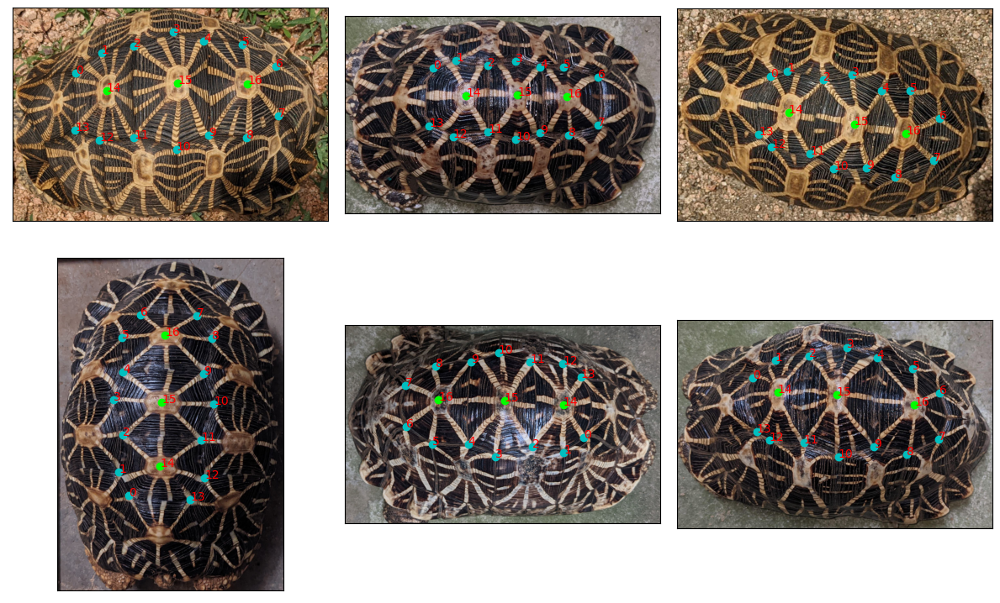

In [6]:
# Plot a sample of images and their keypoints.
fig = plt.figure(figsize=(12, 8))
axes = fig.subplots(2, 3)
flatten_axes = axes.flatten()
random_image_idx = random.sample(range(len(image_names)), k=len(flatten_axes))

for e, i in enumerate(random_image_idx):

    # Read and plot image.
    image = img.imread(os.path.join(img_dir, image_names[i]))
    flatten_axes[e].imshow(image)
    flatten_axes[e].get_xaxis().set_visible(False)
    flatten_axes[e].get_yaxis().set_visible(False)

    # Plot keypoints.
    points = np.concatenate(keypoints[i])
    x, y  = points[:, 0], points[:, 1]
    flatten_axes[e].scatter(x[:-3], y[:-3], c='c')
    flatten_axes[e].scatter(x[-3:], y[-3:], c='lime')

    # Numerate the points.
    for point_idx, (x_i, y_i) in enumerate(zip(x, y)):
        flatten_axes[e].text(x_i, y_i, point_idx, c='r')

plt.tight_layout()
plt.show()

# Create TFDataset

In [7]:
flat_keypoints = [list(np.concatenate([corners, centers]).flatten()) for corners, centers in keypoints]

In [8]:
num_samples = 27
num_tfrecords = -1* (-len(image_names) // num_samples)

tfdatasets_dir = ('tfdatasets')
if not os.path.exists(tfdatasets_dir):
    os.makedirs(tfdatasets_dir)

In [9]:
def create_example(image, path, keypoints):
    feature = {
        "image": tf.train.Feature(bytes_list=tf.train.BytesList(value=[tf.io.encode_jpeg(image).numpy()])),
        "path": tf.train.Feature(bytes_list=tf.train.BytesList(value=[path.encode()])),
        "keypoints": tf.train.Feature(float_list=tf.train.FloatList(value=keypoints))
    }
    return tf.train.Example(features=tf.train.Features(feature=feature))

In [10]:
for tfrec_num in range(num_tfrecords):
    samples = image_names[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]
    targets = flat_keypoints[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]

    with tf.io.TFRecordWriter(
        tfdatasets_dir + "/file_%.2i-%i.tfrec" % (tfrec_num, len(samples))
    ) as writer:
        for sample, target in zip(samples, targets):
            image_path = os.path.join(img_dir, sample)
            image = tf.io.decode_jpeg(tf.io.read_file(image_path))
            example = create_example(image, image_path, target)
            writer.write(example.SerializeToString())

Metal device set to: Apple M1 Pro


2022-11-05 16:47:10.069562: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-11-05 16:47:10.070204: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [11]:
def parse_tfrecord_fn(example):
    feature_description = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "path": tf.io.FixedLenFeature([], tf.string),
        "keypoints": tf.io.VarLenFeature(tf.float32),

    }
    example = tf.io.parse_single_example(example, feature_description)
    example["image"] = tf.io.decode_jpeg(example["image"], channels=3)
    example["keypoints"] = tf.sparse.to_dense(example["keypoints"])
    return example["image"], example["keypoints"]


In [12]:
records = [os.path.join(tfdatasets_dir, file) for file in os.listdir(tfdatasets_dir)]
records

['tfdatasets/file_02-27.tfrec',
 'tfdatasets/file_00-27.tfrec',
 'tfdatasets/file_01-27.tfrec']

In [13]:
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.padded_batch(2)

In [14]:
batches = iter(train_dataset)

2022-11-05 16:47:15.483263: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


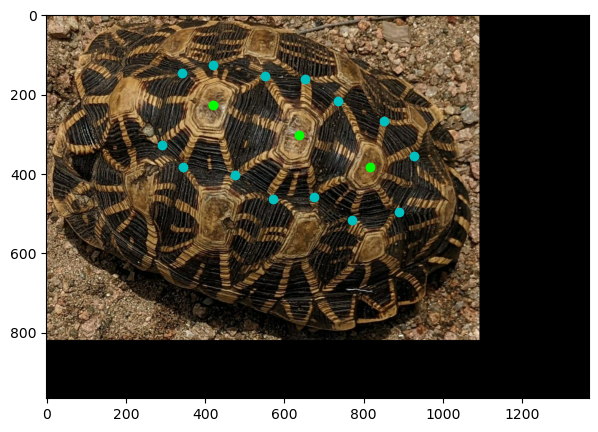

In [15]:
batch = next(batches)
image = batch[0][0]
points = batch[1][0]

plt.figure(figsize=(7, 7))
plt.imshow(image)


x = []
y = []
for coord in zip(points[::2], points[1::2]):
    x.append(coord[0])
    y.append(coord[1])
    
plt.scatter(x[:-3], y[:-3], c='c')
plt.scatter(x[-3:], y[-3:], c='lime')

plt.show()

# Resize images

We resize images to be a square.

In [16]:
def resize_images_keypoints(image, keypoints, size=256):
        resized_img = tf.image.resize(image, (size, size), method='nearest')
        x, y = keypoints[::2], keypoints[1::2]
        resized_trgts = [1, 2, 3, 4]
        image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.int32)
        resized_x = tf.multiply(x, tf.cast(tf.divide(size, image_shape[1]), tf.float32))
        resized_y = tf.multiply(y, tf.cast(tf.divide(size, image_shape[0]), tf.float32))
        
    
        resized_trgts = tf.reshape(tf.stack((resized_x, resized_y), axis=-1), shape=(-1, 34))[0]
        return resized_img, resized_trgts

In [17]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.padded_batch(16)

In [18]:
def plot_images_keypoints(images, keypoints, rows=3, cols=5):
    fig = plt.figure(figsize=(3*cols, 3*rows))
    axes = fig.subplots(rows, cols)
    flatten_axes = axes.flatten()

    for i, image in enumerate(images):
        
        if i >= rows*cols:
            break
        
        
        # Read image.
        flatten_axes[i].imshow(image)

        # Plot keypoints.
        x = []
        y = []
        for coord in zip(keypoints[i, ::2], keypoints[i, 1::2]):
            x.append(coord[0])
            y.append(coord[1])
            
        flatten_axes[i].scatter(x[:-3], y[:-3], c='c')
        flatten_axes[i].scatter(x[-3:], y[-3:], c='lime')
        flatten_axes[i].get_xaxis().set_visible(False)
        flatten_axes[i].get_yaxis().set_visible(False)

    plt.show()

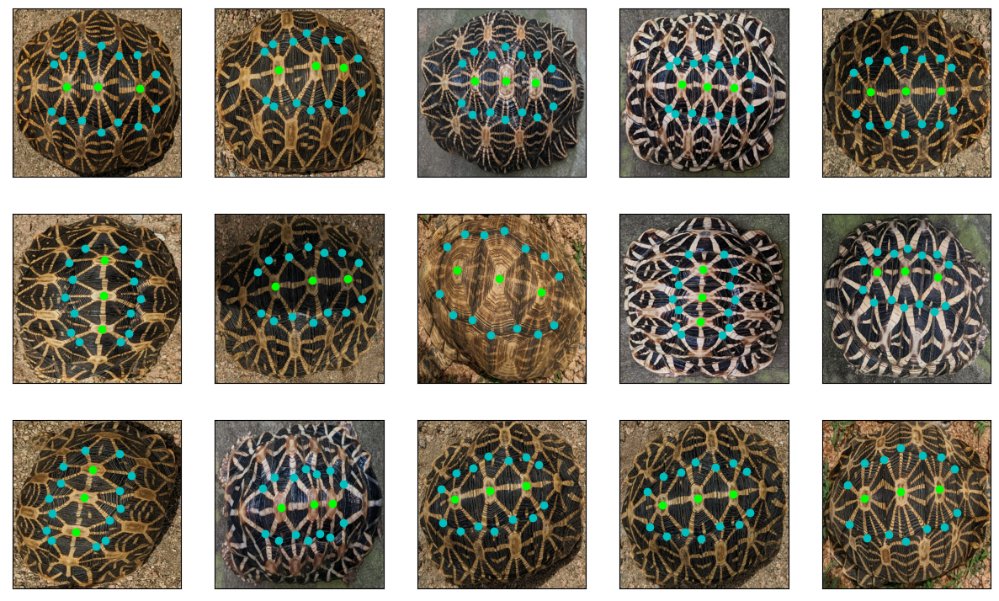

In [19]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

# Augmentation

## Flip

In [20]:
def flip_images_keypoints(image, keypoints):
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        image_shape = tf.cast(tf.shape(image)[:2], tf.float32)
        keypoints = tf.reshape(tf.stack([image_shape[1] - keypoints[::2], keypoints[1::2]], axis=-1), shape=(-1,34))[0]
    return image, keypoints

In [21]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.map(flip_images_keypoints)
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.batch(16)

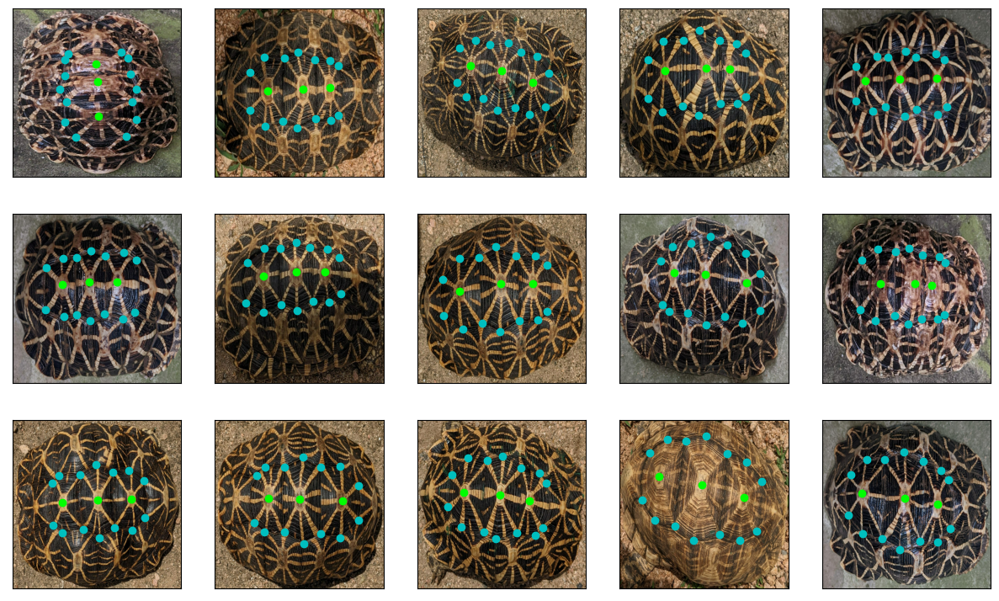

In [22]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Rotate

In [23]:
def rotate_images_keypoints(images, keypoints):
    keypoints = keypoints

    angle = tf.random.uniform((), maxval= 359)
    radians = angle * (np.pi/180)
    
    random_number = tf.random.uniform(())
    if  0 <= random_number and random_number < 0.33333:
        image = tfa.image.rotate(images, radians, fill_mode='wrap')
    elif 0.33333 <= random_number and random_number < 0.66666:
        image = tfa.image.rotate(images, radians, fill_mode="reflect")
    else:
        image = tfa.image.rotate(images, radians)

    image_shape = tf.shape(image)[:2]

    radians = angle * (np.pi/180)
    angle_cos, angle_sin = tf.math.cos(radians), -tf.math.sin(radians)
    half_width = tf.cast(image_shape[1]/2, dtype=tf.float32)
    half_height = tf.cast(image_shape[0]/2, dtype=tf.float32)

    x = keypoints[::2] - half_width
    y = keypoints[1::2] - half_height

    rot_x = (x*angle_cos) - (y*angle_sin)
    rot_y = (y*angle_cos) + (x*angle_sin)
    rot_x = rot_x+half_width
    rot_y = rot_y+half_height
    
    keypoints = tf.reshape(tf.stack([rot_x, rot_y], axis=-1), shape=(-1,34))[0]
    
    return image, keypoints

In [24]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(rotate_images_keypoints)
train_dataset = train_dataset.batch(BATCH_SIZE)

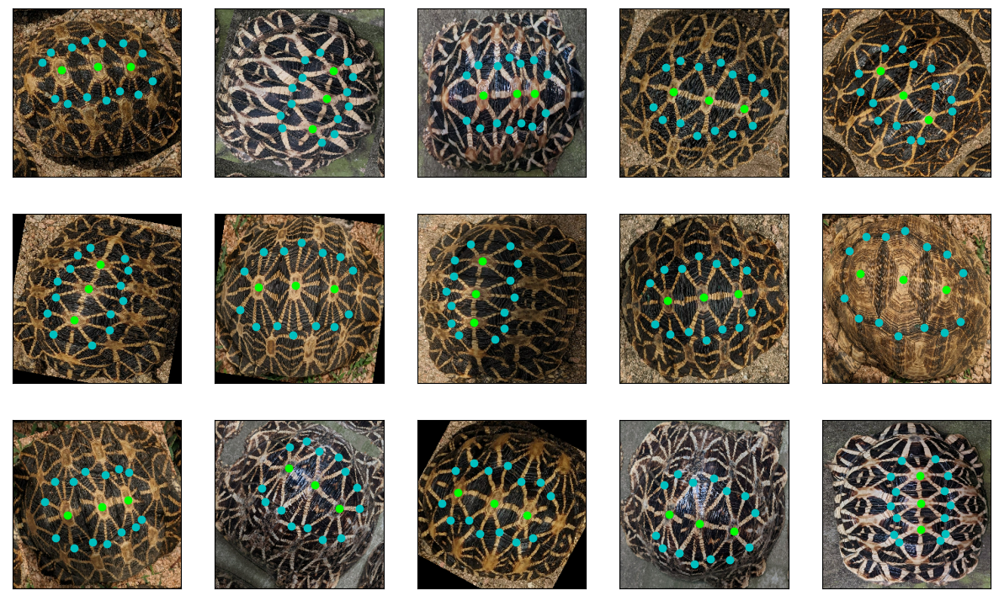

In [25]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Shift

In [26]:
def shift_images_keypoints(image, keypoints, max_pixels=15):
    keypoints = tf.cast(keypoints, tf.float32)
    image_shape = tf.cast(tf.shape(image)[:2], tf.float32)


    translation = tf.random.uniform([2], minval=-max_pixels, maxval=max_pixels)
    
    x = keypoints[::2] + translation[0]
    y = keypoints[1::2] + translation[1]

    
    if tf.reduce_all(x < image_shape[1]) and tf.reduce_all(y < image_shape[0]):
        random_number = tf.random.uniform(())
        if  0 <= random_number and random_number < 0.33333:
            image = tfa.image.translate(image, translation, fill_mode='wrap')
        elif 0.33333 <= random_number and random_number < 0.66666:
            image = tfa.image.translate(image, translation, fill_mode='reflect')
        else:
            image = tfa.image.translate(image, translation)
        keypoints = tf.reshape(tf.stack([x, y], axis=-1), shape=(-1,34))[0]
        
    return image, keypoints
    

In [27]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_SHIFT = 20
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: shift_images_keypoints(x, y, MAX_SHIFT))
train_dataset = train_dataset.batch(BATCH_SIZE)

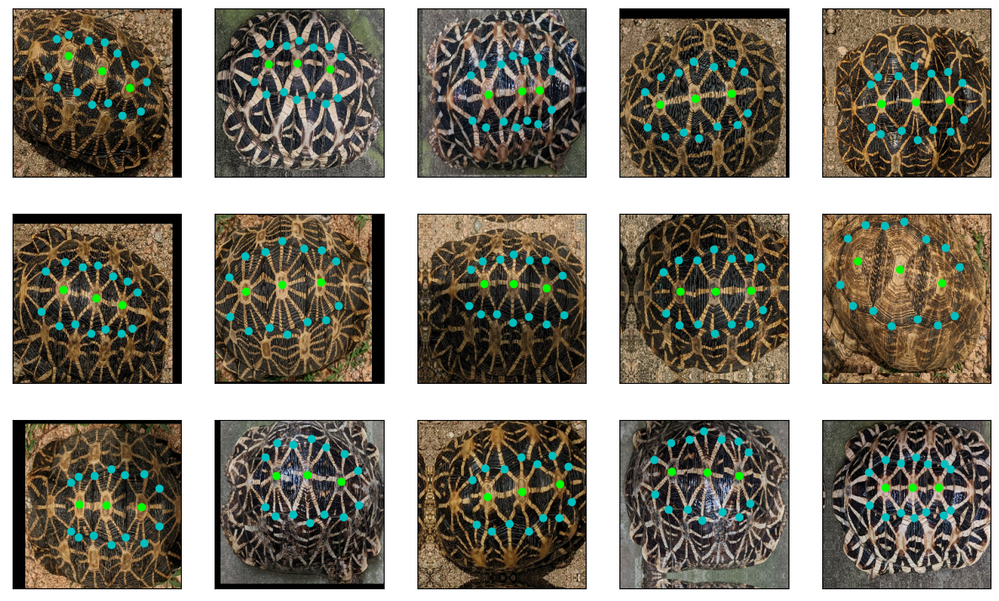

In [28]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Brightness

In [29]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_BRIGHTNESS_DELTA = 0.3
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_brightness(x, MAX_BRIGHTNESS_DELTA), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

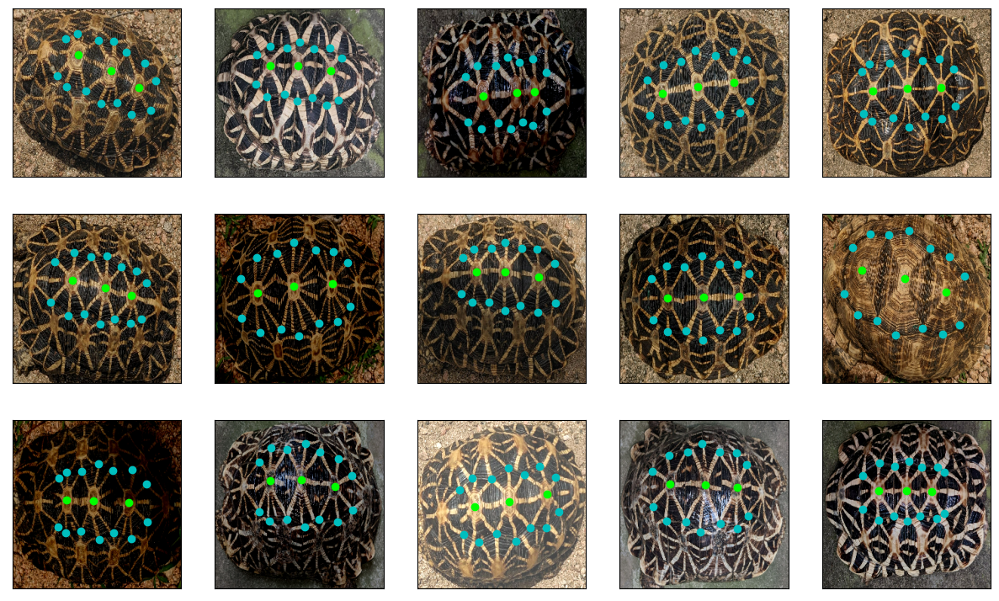

In [30]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Contrast

In [31]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MIN_CONTRAST = 0.5
MAX_CONTRAST = 3
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_contrast(x, MIN_CONTRAST, MAX_CONTRAST), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

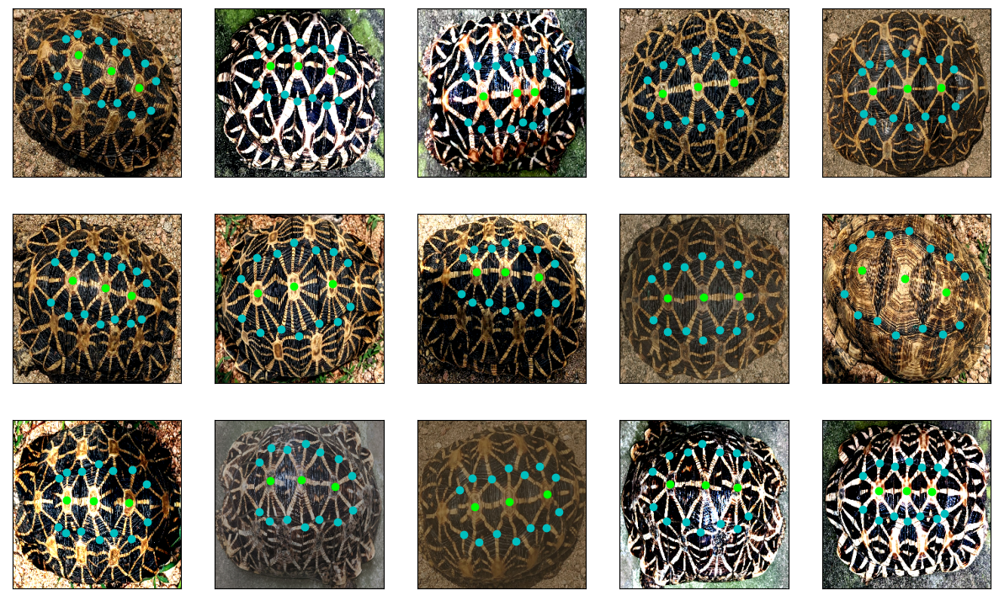

In [32]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Hue

In [33]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_HUE_DELTA = 0.1
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_hue(x, MAX_HUE_DELTA), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

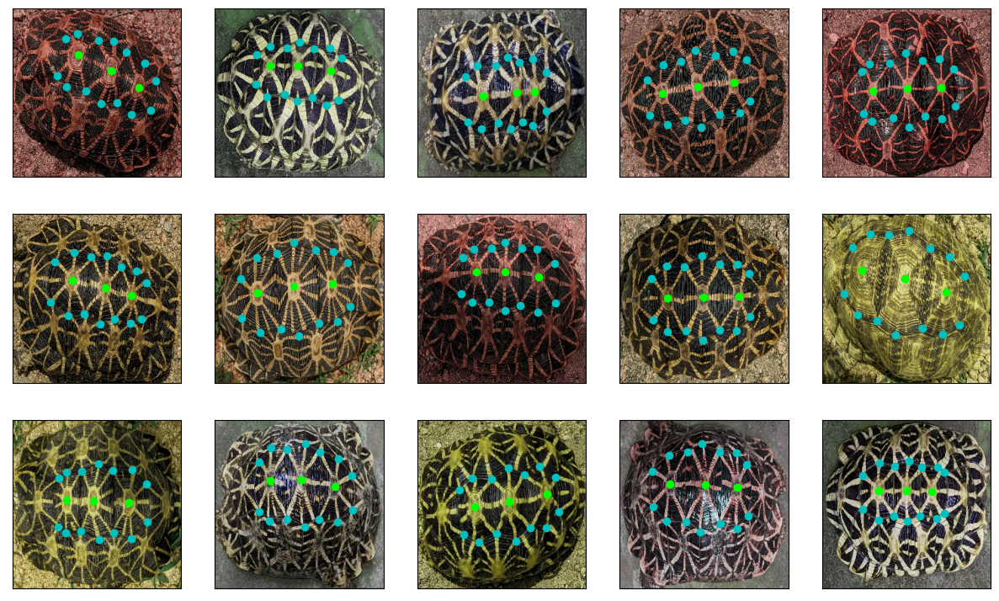

In [34]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## JPEG Quality

In [35]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MIN_QUALITY = 25
MAX_QUALITY = 100
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_jpeg_quality(x, MIN_QUALITY, MAX_QUALITY), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

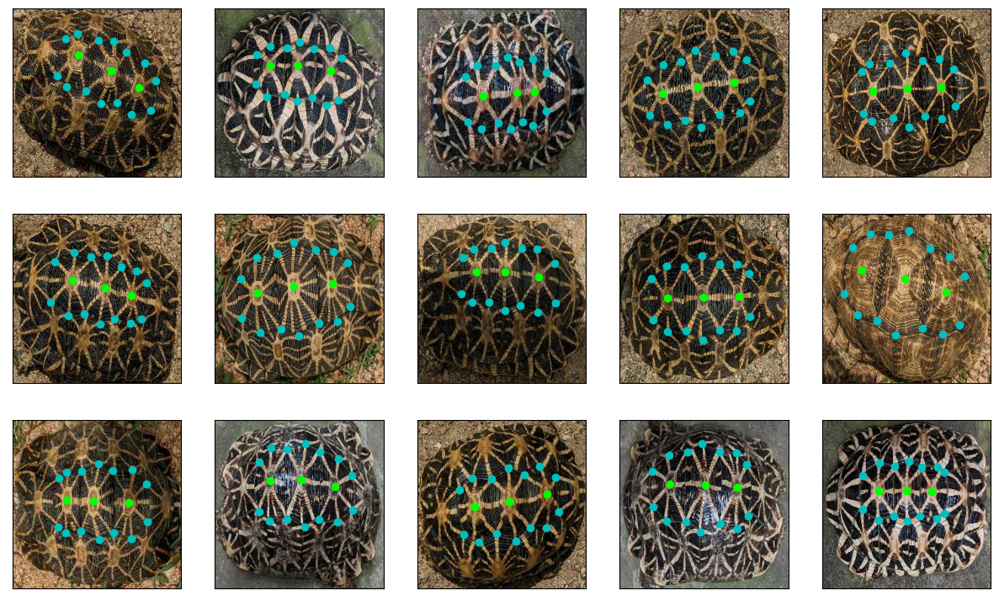

In [36]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Saturation

In [37]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MIN_SATURATION = 0.2
MAX_SATURATION = 2
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_saturation(x, MIN_SATURATION, MAX_SATURATION), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

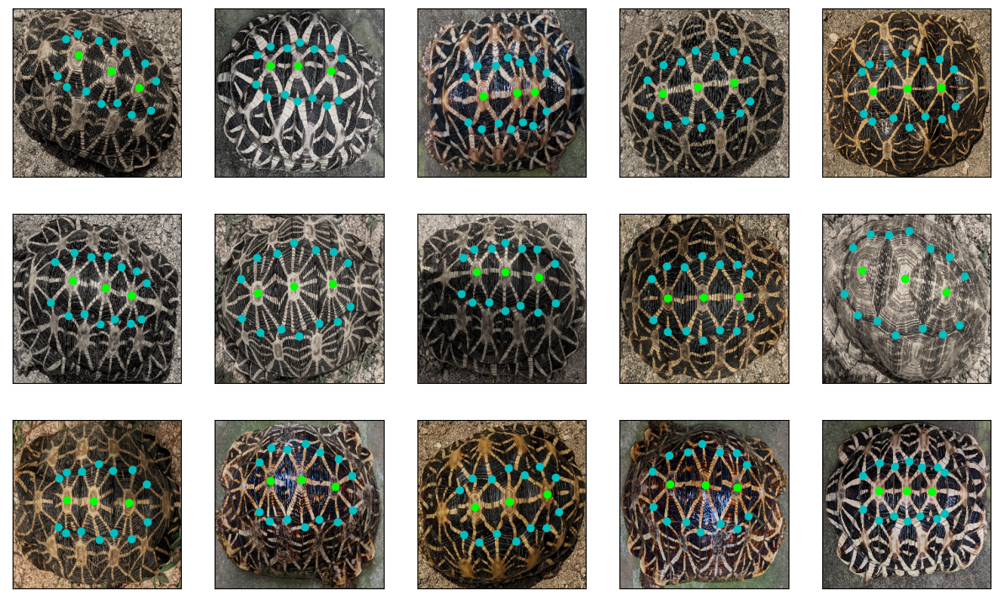

In [38]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

# All Together Now

In [163]:
IMAGE_SIZE = 224
BATCH_SIZE = 32
VAL_SPLIT = 0.11
MAX_SHIFT = 20
MAX_BRIGHTNESS_DELTA = 0.2
MIN_CONTRAST = 0.5
MAX_CONTRAST = 2
MAX_HUE_DELTA = 0.1
MIN_QUALITY = 25
MAX_QUALITY = 100
MIN_SATURATION = 0.3
MAX_SATURATION = 1.7

autotune = tf.data.AUTOTUNE
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
full_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)

og_train_dataset, val_dataset = tf.keras.utils.split_dataset(full_dataset, right_size=VAL_SPLIT, seed=123)

train_dataset = og_train_dataset

#  Multiply dataset by 2^n.
n = 7
for i in range(n):
    train_dataset = train_dataset.concatenate(train_dataset)

train_dataset = train_dataset.map(flip_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.map(rotate_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.map(lambda x, y: shift_images_keypoints(x, y, MAX_SHIFT))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_brightness(x, MAX_BRIGHTNESS_DELTA), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_contrast(x, MIN_CONTRAST, MAX_CONTRAST), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_hue(x, MAX_HUE_DELTA), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_jpeg_quality(x, MIN_QUALITY, MAX_QUALITY), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_saturation(x, MIN_SATURATION, MAX_SATURATION), y))

# Add original images
train_dataset = train_dataset.concatenate(og_train_dataset)
train_dataset = train_dataset.shuffle(8*BATCH_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)
train_dataset = train_dataset.prefetch(autotune)

val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.prefetch(autotune)

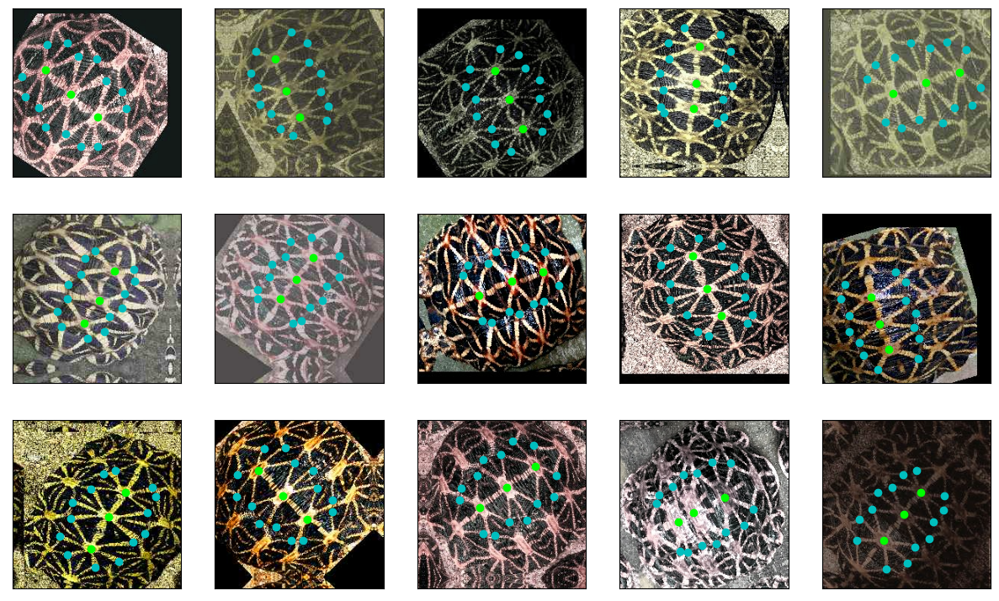

In [164]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

In [162]:
number_of_steps = np.sum([1 for batch in iter(train_dataset)])
number_of_steps

291

# Model

In [165]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler

# Define callbacks
earlystop = EarlyStopping(monitor = 'val_loss', 
               patience = 32,
               mode = 'min',
               baseline=None,
               restore_best_weights=True)

In [166]:
base_model = keras.applications.EfficientNetV2B0(
    include_top=False, pooling='avg', weights='imagenet',
    )

In [167]:
for layer in base_model.layers:
    layer.trainable = False

In [168]:
# Want the last layer to be dense layer with 34 nodes
inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
x = base_model(inputs)
x = keras.layers.Dropout(0.1)(x)
outputs = keras.layers.Dense(34)(x)
model = keras.Model(inputs, outputs)


model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 43,554
Non-trainable params: 5,919,312
_________________________________________________________________


In [169]:
# Ev2b0, img_size=224 batch=32 dropout 0.1 with new augmentations, freeze whole base lr = 0.001
LEARNING_RATE = 0.001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps], [LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_high_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "high_lr_frozen_base"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/10), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "low_lr_frozen_base"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )

Epoch 1/1000


2022-11-06 01:15:23.045892: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 108.7171 - mse: 13621.4912

2022-11-06 01:15:56.600658: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 99.64859, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 56s 181ms/step - loss: 108.7171 - mse: 13621.4912 - val_loss: 99.6486 - val_mse: 11480.8408
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 102.5755 - mse: 12327.1084
Epoch 2: val_loss improved from 99.64859 to 93.31541, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 102.5755 - mse: 12327.1084 - val_loss: 93.3154 - val_mse: 10264.0361
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 96.3389 - mse: 11089.0391
Epoch 3: val_loss improved from 93.31541 to 86.98859, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 157ms/step - loss: 96.3389 - mse: 11089.0391 - val_loss: 86.9886 - val_mse: 9130.0938
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 89.8248 - mse: 9874.7471
Epoch 4: val_loss improved from 86.98859 to 80.66624, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 46s 155ms/step - loss: 89.8248 - mse: 9874.7471 - val_loss: 80.6662 - val_mse: 8078.4756
Epoch 5/1000
290/291 [============================>.] - ETA: 0s - loss: 84.0158 - mse: 8858.7461
Epoch 5: val_loss improved from 80.66624 to 74.45985, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 46s 154ms/step - loss: 84.0084 - mse: 8857.4580 - val_loss: 74.4599 - val_mse: 7122.5942
Epoch 6/1000
290/291 [============================>.] - ETA: 0s - loss: 77.7876 - mse: 7829.7705
Epoch 6: val_loss improved from 74.45985 to 68.41572, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 156ms/step - loss: 77.7869 - mse: 7829.6533 - val_loss: 68.4157 - val_mse: 6255.4297
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 72.2976 - mse: 6975.1851
Epoch 7: val_loss improved from 68.41572 to 62.70408, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 45s 148ms/step - loss: 72.2976 - mse: 6975.1851 - val_loss: 62.7041 - val_mse: 5481.2954
Epoch 8/1000
290/291 [============================>.] - ETA: 0s - loss: 66.9115 - mse: 6162.6064
Epoch 8: val_loss improved from 62.70408 to 57.59821, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 158ms/step - loss: 66.9117 - mse: 6162.5435 - val_loss: 57.5982 - val_mse: 4809.7148
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 62.1308 - mse: 5472.6392
Epoch 9: val_loss improved from 57.59821 to 53.06429, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 46s 155ms/step - loss: 62.1308 - mse: 5472.6392 - val_loss: 53.0643 - val_mse: 4225.0957
Epoch 10/1000
291/291 [==============================] - ETA: 0s - loss: 57.7993 - mse: 4864.2119
Epoch 10: val_loss improved from 53.06429 to 49.12265, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 156ms/step - loss: 57.7993 - mse: 4864.2119 - val_loss: 49.1227 - val_mse: 3729.7258
Epoch 11/1000
291/291 [==============================] - ETA: 0s - loss: 45.2755 - mse: 3145.8838
Epoch 11: val_loss improved from 49.12265 to 36.56735, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 45.2755 - mse: 3145.8838 - val_loss: 36.5673 - val_mse: 1924.0217
Epoch 12/1000
291/291 [==============================] - ETA: 0s - loss: 38.7177 - mse: 2210.5305
Epoch 12: val_loss improved from 36.56735 to 35.77267, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 158ms/step - loss: 38.7177 - mse: 2210.5305 - val_loss: 35.7727 - val_mse: 1765.6562
Epoch 13/1000
291/291 [==============================] - ETA: 0s - loss: 37.6936 - mse: 2057.5576
Epoch 13: val_loss improved from 35.77267 to 35.71879, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 160ms/step - loss: 37.6936 - mse: 2057.5576 - val_loss: 35.7188 - val_mse: 1753.3679
Epoch 14/1000
291/291 [==============================] - ETA: 0s - loss: 37.4939 - mse: 2030.8412
Epoch 14: val_loss did not improve from 35.71879
291/291 [==============================] - 29s 96ms/step - loss: 37.4939 - mse: 2030.8412 - val_loss: 35.7555 - val_mse: 1750.2365
Epoch 15/1000
291/291 [==============================] - ETA: 0s - loss: 37.2213 - mse: 1997.9999
Epoch 15: val_loss improved from 35.71879 to 35.36726, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 45s 150ms/step - loss: 37.2213 - mse: 1997.9999 - val_loss: 35.3673 - val_mse: 1712.1758
Epoch 16/1000
291/291 [==============================] - ETA: 0s - loss: 37.1054 - mse: 1985.5718
Epoch 16: val_loss improved from 35.36726 to 35.14716, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 164ms/step - loss: 37.1054 - mse: 1985.5718 - val_loss: 35.1472 - val_mse: 1691.7565
Epoch 17/1000
291/291 [==============================] - ETA: 0s - loss: 36.9067 - mse: 1964.1969
Epoch 17: val_loss improved from 35.14716 to 34.92178, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 158ms/step - loss: 36.9067 - mse: 1964.1969 - val_loss: 34.9218 - val_mse: 1666.7535
Epoch 18/1000
291/291 [==============================] - ETA: 0s - loss: 36.8095 - mse: 1952.9087
Epoch 18: val_loss improved from 34.92178 to 34.82235, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 36.8095 - mse: 1952.9087 - val_loss: 34.8223 - val_mse: 1653.1055
Epoch 19/1000
291/291 [==============================] - ETA: 0s - loss: 36.5412 - mse: 1920.9379
Epoch 19: val_loss improved from 34.82235 to 34.61842, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 160ms/step - loss: 36.5412 - mse: 1920.9379 - val_loss: 34.6184 - val_mse: 1633.9384
Epoch 20/1000
291/291 [==============================] - ETA: 0s - loss: 36.3717 - mse: 1900.2722
Epoch 20: val_loss improved from 34.61842 to 34.42322, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 36.3717 - mse: 1900.2722 - val_loss: 34.4232 - val_mse: 1615.9420
Epoch 21/1000
290/291 [============================>.] - ETA: 0s - loss: 36.2866 - mse: 1894.1058
Epoch 21: val_loss improved from 34.42322 to 34.26647, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 159ms/step - loss: 36.2856 - mse: 1893.9348 - val_loss: 34.2665 - val_mse: 1598.2079
Epoch 22/1000
291/291 [==============================] - ETA: 0s - loss: 36.1282 - mse: 1877.4602
Epoch 22: val_loss improved from 34.26647 to 34.12117, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 158ms/step - loss: 36.1282 - mse: 1877.4602 - val_loss: 34.1212 - val_mse: 1585.6544
Epoch 23/1000
291/291 [==============================] - ETA: 0s - loss: 36.0680 - mse: 1873.1814
Epoch 23: val_loss improved from 34.12117 to 34.05525, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 146ms/step - loss: 36.0680 - mse: 1873.1814 - val_loss: 34.0553 - val_mse: 1574.3956
Epoch 24/1000
290/291 [============================>.] - ETA: 0s - loss: 35.9107 - mse: 1856.6787
Epoch 24: val_loss improved from 34.05525 to 33.80744, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 160ms/step - loss: 35.9074 - mse: 1856.3302 - val_loss: 33.8074 - val_mse: 1554.3616
Epoch 25/1000
291/291 [==============================] - ETA: 0s - loss: 35.8056 - mse: 1847.1896
Epoch 25: val_loss improved from 33.80744 to 33.58902, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 146ms/step - loss: 35.8056 - mse: 1847.1896 - val_loss: 33.5890 - val_mse: 1537.3058
Epoch 26/1000
290/291 [============================>.] - ETA: 0s - loss: 35.7165 - mse: 1833.6346
Epoch 26: val_loss improved from 33.58902 to 33.53557, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 47s 159ms/step - loss: 35.7154 - mse: 1833.4811 - val_loss: 33.5356 - val_mse: 1525.6556
Epoch 27/1000
291/291 [==============================] - ETA: 0s - loss: 35.5701 - mse: 1820.4363
Epoch 27: val_loss improved from 33.53557 to 33.44282, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 35.5701 - mse: 1820.4363 - val_loss: 33.4428 - val_mse: 1521.9844
Epoch 28/1000
290/291 [============================>.] - ETA: 0s - loss: 35.4310 - mse: 1809.2449
Epoch 28: val_loss improved from 33.44282 to 33.31493, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 161ms/step - loss: 35.4309 - mse: 1809.1945 - val_loss: 33.3149 - val_mse: 1515.0807
Epoch 29/1000
291/291 [==============================] - ETA: 0s - loss: 35.4120 - mse: 1809.5946
Epoch 29: val_loss improved from 33.31493 to 33.13490, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 35.4120 - mse: 1809.5946 - val_loss: 33.1349 - val_mse: 1500.5292
Epoch 30/1000
290/291 [============================>.] - ETA: 0s - loss: 35.2961 - mse: 1797.6078
Epoch 30: val_loss improved from 33.13490 to 33.07070, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 159ms/step - loss: 35.2937 - mse: 1797.4049 - val_loss: 33.0707 - val_mse: 1496.2695
Epoch 31/1000
291/291 [==============================] - ETA: 0s - loss: 35.2061 - mse: 1789.9333
Epoch 31: val_loss improved from 33.07070 to 33.06559, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 159ms/step - loss: 35.2061 - mse: 1789.9333 - val_loss: 33.0656 - val_mse: 1492.0342
Epoch 32/1000
291/291 [==============================] - ETA: 0s - loss: 35.0676 - mse: 1774.4479
Epoch 32: val_loss improved from 33.06559 to 32.75437, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 35.0676 - mse: 1774.4479 - val_loss: 32.7544 - val_mse: 1473.8756
Epoch 33/1000
290/291 [============================>.] - ETA: 0s - loss: 35.0189 - mse: 1773.5757
Epoch 33: val_loss improved from 32.75437 to 32.60735, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 35.0171 - mse: 1773.3815 - val_loss: 32.6074 - val_mse: 1462.1940
Epoch 34/1000
291/291 [==============================] - ETA: 0s - loss: 34.8980 - mse: 1760.8228
Epoch 34: val_loss improved from 32.60735 to 32.57234, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 166ms/step - loss: 34.8980 - mse: 1760.8228 - val_loss: 32.5723 - val_mse: 1458.9039
Epoch 35/1000
291/291 [==============================] - ETA: 0s - loss: 34.9395 - mse: 1765.5565
Epoch 35: val_loss did not improve from 32.57234
291/291 [==============================] - 29s 95ms/step - loss: 34.9395 - mse: 1765.5565 - val_loss: 32.6597 - val_mse: 1463.9203
Epoch 36/1000
291/291 [==============================] - ETA: 0s - loss: 34.8370 - mse: 1756.8540
Epoch 36: val_loss did not improve from 32.57234
291/291 [==============================] - 29s 95ms/step - loss: 34.8370 - mse: 1756.8540 - val_loss: 32.5817 - val_mse: 1456.0396
Epoch 37/1000
290/291 [============================>.] - ETA: 0s - loss: 34.7825 - mse: 1751.7178
Epoch 37: val_loss improved from 32.57234 to 32.40374, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 163ms/step - loss: 34.7832 - mse: 1751.7954 - val_loss: 32.4037 - val_mse: 1447.4381
Epoch 38/1000
291/291 [==============================] - ETA: 0s - loss: 34.6806 - mse: 1740.5139
Epoch 38: val_loss did not improve from 32.40374
291/291 [==============================] - 29s 95ms/step - loss: 34.6806 - mse: 1740.5139 - val_loss: 32.5376 - val_mse: 1457.3033
Epoch 39/1000
290/291 [============================>.] - ETA: 0s - loss: 34.5872 - mse: 1734.2430
Epoch 39: val_loss improved from 32.40374 to 32.30243, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 34.5895 - mse: 1734.4686 - val_loss: 32.3024 - val_mse: 1443.6392
Epoch 40/1000
290/291 [============================>.] - ETA: 0s - loss: 34.5511 - mse: 1731.8373
Epoch 40: val_loss improved from 32.30243 to 32.25864, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 34.5485 - mse: 1731.5757 - val_loss: 32.2586 - val_mse: 1443.0237
Epoch 41/1000
290/291 [============================>.] - ETA: 0s - loss: 34.5407 - mse: 1732.0585
Epoch 41: val_loss improved from 32.25864 to 32.18050, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 165ms/step - loss: 34.5418 - mse: 1732.1542 - val_loss: 32.1805 - val_mse: 1431.5872
Epoch 42/1000
291/291 [==============================] - ETA: 0s - loss: 34.5091 - mse: 1729.9270
Epoch 42: val_loss did not improve from 32.18050
291/291 [==============================] - 29s 95ms/step - loss: 34.5091 - mse: 1729.9270 - val_loss: 32.2278 - val_mse: 1437.0458
Epoch 43/1000
291/291 [==============================] - ETA: 0s - loss: 34.3472 - mse: 1715.2250
Epoch 43: val_loss improved from 32.18050 to 32.08583, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 34.3472 - mse: 1715.2250 - val_loss: 32.0858 - val_mse: 1433.9330
Epoch 44/1000
291/291 [==============================] - ETA: 0s - loss: 34.3333 - mse: 1714.7341
Epoch 44: val_loss did not improve from 32.08583
291/291 [==============================] - 29s 96ms/step - loss: 34.3333 - mse: 1714.7341 - val_loss: 32.1216 - val_mse: 1434.9495
Epoch 45/1000
290/291 [============================>.] - ETA: 0s - loss: 34.1893 - mse: 1701.5404
Epoch 45: val_loss improved from 32.08583 to 32.05378, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 48s 163ms/step - loss: 34.1868 - mse: 1701.2942 - val_loss: 32.0538 - val_mse: 1430.5564
Epoch 46/1000
291/291 [==============================] - ETA: 0s - loss: 34.2339 - mse: 1708.3359
Epoch 46: val_loss improved from 32.05378 to 31.99242, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 34.2339 - mse: 1708.3359 - val_loss: 31.9924 - val_mse: 1433.1135
Epoch 47/1000
290/291 [============================>.] - ETA: 0s - loss: 34.1831 - mse: 1701.2340
Epoch 47: val_loss did not improve from 31.99242
291/291 [==============================] - 29s 95ms/step - loss: 34.1832 - mse: 1701.1915 - val_loss: 31.9970 - val_mse: 1431.8069
Epoch 48/1000
290/291 [============================>.] - ETA: 0s - loss: 34.1101 - mse: 1693.9845
Epoch 48: val_loss improved from 31.99242 to 31.97852, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 165ms/step - loss: 34.1087 - mse: 1693.8496 - val_loss: 31.9785 - val_mse: 1431.4355
Epoch 49/1000
291/291 [==============================] - ETA: 0s - loss: 34.1504 - mse: 1698.8293
Epoch 49: val_loss improved from 31.97852 to 31.90311, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 34.1504 - mse: 1698.8293 - val_loss: 31.9031 - val_mse: 1425.8304
Epoch 50/1000
290/291 [============================>.] - ETA: 0s - loss: 33.9769 - mse: 1682.8479
Epoch 50: val_loss improved from 31.90311 to 31.78316, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 169ms/step - loss: 33.9792 - mse: 1683.1121 - val_loss: 31.7832 - val_mse: 1418.5094
Epoch 51/1000
291/291 [==============================] - ETA: 0s - loss: 33.9876 - mse: 1685.5920
Epoch 51: val_loss did not improve from 31.78316
291/291 [==============================] - 29s 95ms/step - loss: 33.9876 - mse: 1685.5920 - val_loss: 31.9567 - val_mse: 1428.3473
Epoch 52/1000
290/291 [============================>.] - ETA: 0s - loss: 33.9657 - mse: 1683.2888
Epoch 52: val_loss improved from 31.78316 to 31.68891, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 33.9658 - mse: 1683.2892 - val_loss: 31.6889 - val_mse: 1419.9030
Epoch 53/1000
291/291 [==============================] - ETA: 0s - loss: 33.9257 - mse: 1681.1588
Epoch 53: val_loss did not improve from 31.68891
291/291 [==============================] - 29s 95ms/step - loss: 33.9257 - mse: 1681.1588 - val_loss: 31.8540 - val_mse: 1429.0477
Epoch 54/1000
290/291 [============================>.] - ETA: 0s - loss: 33.8861 - mse: 1678.2037
Epoch 54: val_loss improved from 31.68891 to 31.68167, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 33.8869 - mse: 1678.1957 - val_loss: 31.6817 - val_mse: 1415.9012
Epoch 55/1000
291/291 [==============================] - ETA: 0s - loss: 33.7836 - mse: 1667.2955
Epoch 55: val_loss improved from 31.68167 to 31.65868, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 168ms/step - loss: 33.7836 - mse: 1667.2955 - val_loss: 31.6587 - val_mse: 1417.1112
Epoch 56/1000
291/291 [==============================] - ETA: 0s - loss: 33.7806 - mse: 1668.0955
Epoch 56: val_loss did not improve from 31.65868
291/291 [==============================] - 29s 95ms/step - loss: 33.7806 - mse: 1668.0955 - val_loss: 31.8031 - val_mse: 1425.9908
Epoch 57/1000
291/291 [==============================] - ETA: 0s - loss: 33.7488 - mse: 1664.0219
Epoch 57: val_loss did not improve from 31.65868
291/291 [==============================] - 29s 95ms/step - loss: 33.7488 - mse: 1664.0219 - val_loss: 31.7427 - val_mse: 1421.2603
Epoch 58/1000
290/291 [============================>.] - ETA: 0s - loss: 33.6875 - mse: 1661.9844
Epoch 58: val_loss did not improve from 31.65868
291/291 [==============================] - 29s 96ms/step - loss: 33.6887 - mse: 1662.1002 - val_loss: 31.7088 - val_mse: 1416.7153
Epoch 59/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 33.7306 - mse: 1668.1886 - val_loss: 31.4545 - val_mse: 1406.3013
Epoch 60/1000
290/291 [============================>.] - ETA: 0s - loss: 33.6745 - mse: 1662.6416
Epoch 60: val_loss did not improve from 31.45452
291/291 [==============================] - 29s 94ms/step - loss: 33.6748 - mse: 1662.6611 - val_loss: 31.5608 - val_mse: 1411.4133
Epoch 61/1000
290/291 [============================>.] - ETA: 0s - loss: 33.6257 - mse: 1656.6866
Epoch 61: val_loss did not improve from 31.45452
291/291 [==============================] - 28s 94ms/step - loss: 33.6264 - mse: 1656.7238 - val_loss: 31.6233 - val_mse: 1417.3813
Epoch 62/1000
290/291 [============================>.] - ETA: 0s - loss: 33.6199 - mse: 1658.9187
Epoch 62: val_loss improved from 31.45452 to 31.44016, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 167ms/step - loss: 33.6193 - mse: 1658.8755 - val_loss: 31.4402 - val_mse: 1406.8501
Epoch 63/1000
291/291 [==============================] - ETA: 0s - loss: 33.5402 - mse: 1649.2838
Epoch 63: val_loss improved from 31.44016 to 31.38833, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 45s 149ms/step - loss: 33.5402 - mse: 1649.2838 - val_loss: 31.3883 - val_mse: 1400.3770
Epoch 64/1000
290/291 [============================>.] - ETA: 0s - loss: 33.5335 - mse: 1650.6804
Epoch 64: val_loss did not improve from 31.38833
291/291 [==============================] - 29s 95ms/step - loss: 33.5332 - mse: 1650.6943 - val_loss: 31.6271 - val_mse: 1420.7811
Epoch 65/1000
290/291 [============================>.] - ETA: 0s - loss: 33.5023 - mse: 1646.8973
Epoch 65: val_loss did not improve from 31.38833
291/291 [==============================] - 28s 95ms/step - loss: 33.5026 - mse: 1646.9310 - val_loss: 31.4679 - val_mse: 1409.9442
Epoch 66/1000
290/291 [============================>.] - ETA: 0s - loss: 33.4774 - mse: 1646.2969
Epoch 66: val_loss did not improve from 31.38833
291/291 [==============================] - 28s 94ms/step - loss: 33.4783 - mse: 1646.3804 - val_loss: 31.4894 - val_mse: 1411.5775
Epoch 67/1000
291/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 166ms/step - loss: 33.4648 - mse: 1644.4528 - val_loss: 31.1574 - val_mse: 1394.4957
Epoch 68/1000
291/291 [==============================] - ETA: 0s - loss: 33.3342 - mse: 1630.1019
Epoch 68: val_loss did not improve from 31.15735
291/291 [==============================] - 29s 95ms/step - loss: 33.3342 - mse: 1630.1019 - val_loss: 31.3658 - val_mse: 1405.8379
Epoch 69/1000
290/291 [============================>.] - ETA: 0s - loss: 33.4758 - mse: 1645.5836
Epoch 69: val_loss did not improve from 31.15735
291/291 [==============================] - 28s 93ms/step - loss: 33.4783 - mse: 1645.7855 - val_loss: 31.5030 - val_mse: 1409.1504
Epoch 70/1000
291/291 [==============================] - ETA: 0s - loss: 33.3443 - mse: 1636.9861
Epoch 70: val_loss did not improve from 31.15735
291/291 [==============================] - 28s 95ms/step - loss: 33.3443 - mse: 1636.9861 - val_loss: 31.2050 - val_mse: 1399.7383
Epoch 71/1000
291/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 43s 146ms/step - loss: 33.3052 - mse: 1630.3805 - val_loss: 31.1338 - val_mse: 1392.3739
Epoch 73/1000
291/291 [==============================] - ETA: 0s - loss: 33.1662 - mse: 1620.1208
Epoch 73: val_loss did not improve from 31.13382
291/291 [==============================] - 29s 94ms/step - loss: 33.1662 - mse: 1620.1208 - val_loss: 31.3404 - val_mse: 1405.4098
Epoch 74/1000
290/291 [============================>.] - ETA: 0s - loss: 33.3158 - mse: 1634.6489
Epoch 74: val_loss did not improve from 31.13382
291/291 [==============================] - 28s 94ms/step - loss: 33.3161 - mse: 1634.8737 - val_loss: 31.2208 - val_mse: 1396.1111
Epoch 75/1000
290/291 [============================>.] - ETA: 0s - loss: 33.2572 - mse: 1627.4675
Epoch 75: val_loss did not improve from 31.13382
291/291 [==============================] - 28s 94ms/step - loss: 33.2574 - mse: 1627.4175 - val_loss: 31.2959 - val_mse: 1402.1294
Epoch 76/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 33.1017 - mse: 1615.8837 - val_loss: 31.1035 - val_mse: 1394.5751
Epoch 82/1000
291/291 [==============================] - ETA: 0s - loss: 33.0500 - mse: 1613.3110
Epoch 82: val_loss improved from 31.10348 to 31.06582, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 167ms/step - loss: 33.0500 - mse: 1613.3110 - val_loss: 31.0658 - val_mse: 1396.3038
Epoch 83/1000
291/291 [==============================] - ETA: 0s - loss: 32.9756 - mse: 1606.2258
Epoch 83: val_loss improved from 31.06582 to 30.95923, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 146ms/step - loss: 32.9756 - mse: 1606.2258 - val_loss: 30.9592 - val_mse: 1386.0084
Epoch 84/1000
290/291 [============================>.] - ETA: 0s - loss: 32.9932 - mse: 1604.3199
Epoch 84: val_loss did not improve from 30.95923
291/291 [==============================] - 29s 95ms/step - loss: 32.9931 - mse: 1604.3164 - val_loss: 30.9670 - val_mse: 1386.5994
Epoch 85/1000
290/291 [============================>.] - ETA: 0s - loss: 33.0303 - mse: 1612.0885
Epoch 85: val_loss improved from 30.95923 to 30.90065, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 33.0281 - mse: 1611.9052 - val_loss: 30.9006 - val_mse: 1384.9591
Epoch 86/1000
290/291 [============================>.] - ETA: 0s - loss: 32.9458 - mse: 1601.1503
Epoch 86: val_loss did not improve from 30.90065
291/291 [==============================] - 29s 94ms/step - loss: 32.9421 - mse: 1600.8229 - val_loss: 31.0008 - val_mse: 1387.0221
Epoch 87/1000
290/291 [============================>.] - ETA: 0s - loss: 33.0488 - mse: 1610.9977
Epoch 87: val_loss did not improve from 30.90065
291/291 [==============================] - 28s 94ms/step - loss: 33.0468 - mse: 1610.7711 - val_loss: 31.1035 - val_mse: 1396.2108
Epoch 88/1000
291/291 [==============================] - ETA: 0s - loss: 32.9020 - mse: 1599.6302
Epoch 88: val_loss did not improve from 30.90065
291/291 [==============================] - 28s 94ms/step - loss: 32.9020 - mse: 1599.6302 - val_loss: 30.9811 - val_mse: 1384.8633
Epoch 89/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 166ms/step - loss: 32.8835 - mse: 1600.4148 - val_loss: 30.8978 - val_mse: 1381.1920
Epoch 92/1000
291/291 [==============================] - ETA: 0s - loss: 32.9063 - mse: 1599.2134
Epoch 92: val_loss improved from 30.89775 to 30.76496, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 146ms/step - loss: 32.9063 - mse: 1599.2134 - val_loss: 30.7650 - val_mse: 1376.4977
Epoch 93/1000
290/291 [============================>.] - ETA: 0s - loss: 32.8957 - mse: 1601.8704
Epoch 93: val_loss did not improve from 30.76496
291/291 [==============================] - 29s 94ms/step - loss: 32.8978 - mse: 1602.0839 - val_loss: 30.8580 - val_mse: 1378.6055
Epoch 94/1000
290/291 [============================>.] - ETA: 0s - loss: 32.9409 - mse: 1603.1372
Epoch 94: val_loss improved from 30.76496 to 30.74829, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 49s 166ms/step - loss: 32.9419 - mse: 1603.1890 - val_loss: 30.7483 - val_mse: 1377.1743
Epoch 95/1000
291/291 [==============================] - ETA: 0s - loss: 32.8731 - mse: 1597.2144
Epoch 95: val_loss did not improve from 30.74829
291/291 [==============================] - 29s 95ms/step - loss: 32.8731 - mse: 1597.2144 - val_loss: 30.8433 - val_mse: 1383.5681
Epoch 96/1000
290/291 [============================>.] - ETA: 0s - loss: 32.8993 - mse: 1601.3729
Epoch 96: val_loss did not improve from 30.74829
291/291 [==============================] - 28s 94ms/step - loss: 32.8995 - mse: 1601.4379 - val_loss: 30.9198 - val_mse: 1384.6456
Epoch 97/1000
291/291 [==============================] - ETA: 0s - loss: 32.8245 - mse: 1593.1329
Epoch 97: val_loss did not improve from 30.74829
291/291 [==============================] - 28s 94ms/step - loss: 32.8245 - mse: 1593.1329 - val_loss: 30.9209 - val_mse: 1383.0599
Epoch 98/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 149ms/step - loss: 32.5308 - mse: 1571.8583 - val_loss: 30.6435 - val_mse: 1387.6340
Epoch 120/1000
291/291 [==============================] - ETA: 0s - loss: 32.4842 - mse: 1568.6141
Epoch 120: val_loss did not improve from 30.64351
291/291 [==============================] - 29s 95ms/step - loss: 32.4842 - mse: 1568.6141 - val_loss: 30.6739 - val_mse: 1383.2244
Epoch 121/1000
291/291 [==============================] - ETA: 0s - loss: 32.4216 - mse: 1565.3484
Epoch 121: val_loss did not improve from 30.64351
291/291 [==============================] - 28s 95ms/step - loss: 32.4216 - mse: 1565.3484 - val_loss: 30.7355 - val_mse: 1387.0050
Epoch 122/1000
291/291 [==============================] - ETA: 0s - loss: 32.4307 - mse: 1565.4778
Epoch 122: val_loss did not improve from 30.64351
291/291 [==============================] - 29s 95ms/step - loss: 32.4307 - mse: 1565.4778 - val_loss: 30.6750 - val_mse: 1382.2594
Epoch 123/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 149ms/step - loss: 32.4033 - mse: 1564.0127 - val_loss: 30.5678 - val_mse: 1380.1470
Epoch 124/1000
291/291 [==============================] - ETA: 0s - loss: 32.4769 - mse: 1569.9242
Epoch 124: val_loss did not improve from 30.56776
291/291 [==============================] - 29s 94ms/step - loss: 32.4769 - mse: 1569.9242 - val_loss: 30.7223 - val_mse: 1387.0192
Epoch 125/1000
290/291 [============================>.] - ETA: 0s - loss: 32.4382 - mse: 1566.9832
Epoch 125: val_loss did not improve from 30.56776
291/291 [==============================] - 28s 94ms/step - loss: 32.4385 - mse: 1567.0226 - val_loss: 30.7281 - val_mse: 1392.4978
Epoch 126/1000
290/291 [============================>.] - ETA: 0s - loss: 32.3412 - mse: 1559.9149
Epoch 126: val_loss improved from 30.56776 to 30.55746, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 170ms/step - loss: 32.3409 - mse: 1559.8574 - val_loss: 30.5575 - val_mse: 1384.0065
Epoch 127/1000
291/291 [==============================] - ETA: 0s - loss: 32.3609 - mse: 1560.2754
Epoch 127: val_loss did not improve from 30.55746
291/291 [==============================] - 29s 95ms/step - loss: 32.3609 - mse: 1560.2754 - val_loss: 30.6907 - val_mse: 1390.0881
Epoch 128/1000
290/291 [============================>.] - ETA: 0s - loss: 32.3763 - mse: 1561.7372
Epoch 128: val_loss did not improve from 30.55746
291/291 [==============================] - 29s 95ms/step - loss: 32.3777 - mse: 1561.8763 - val_loss: 30.5785 - val_mse: 1387.8444
Epoch 129/1000
290/291 [============================>.] - ETA: 0s - loss: 32.4176 - mse: 1564.4772
Epoch 129: val_loss improved from 30.55746 to 30.55205, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 32.4188 - mse: 1564.5679 - val_loss: 30.5520 - val_mse: 1380.5298
Epoch 130/1000
290/291 [============================>.] - ETA: 0s - loss: 32.3680 - mse: 1558.2329
Epoch 130: val_loss did not improve from 30.55205
291/291 [==============================] - 29s 94ms/step - loss: 32.3666 - mse: 1558.0905 - val_loss: 30.7778 - val_mse: 1392.2607
Epoch 131/1000
290/291 [============================>.] - ETA: 0s - loss: 32.2863 - mse: 1554.1924
Epoch 131: val_loss did not improve from 30.55205
291/291 [==============================] - 28s 94ms/step - loss: 32.2848 - mse: 1554.0575 - val_loss: 30.6825 - val_mse: 1386.0299
Epoch 132/1000
290/291 [============================>.] - ETA: 0s - loss: 32.3213 - mse: 1553.9934
Epoch 132: val_loss did not improve from 30.55205
291/291 [==============================] - 28s 94ms/step - loss: 32.3186 - mse: 1553.7656 - val_loss: 30.6913 - val_mse: 1389.8187
Epoch 133/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 32.1348 - mse: 1539.4335 - val_loss: 30.5314 - val_mse: 1389.8466
Epoch 150/1000
291/291 [==============================] - ETA: 0s - loss: 32.0932 - mse: 1538.3635
Epoch 150: val_loss did not improve from 30.53143
291/291 [==============================] - 29s 95ms/step - loss: 32.0932 - mse: 1538.3635 - val_loss: 30.6622 - val_mse: 1399.1777
Epoch 151/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0802 - mse: 1535.3513
Epoch 151: val_loss did not improve from 30.53143
291/291 [==============================] - 28s 94ms/step - loss: 32.0801 - mse: 1535.2764 - val_loss: 30.6784 - val_mse: 1397.1001
Epoch 152/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0763 - mse: 1538.0587
Epoch 152: val_loss did not improve from 30.53143
291/291 [==============================] - 28s 95ms/step - loss: 32.0786 - mse: 1538.2361 - val_loss: 30.8307 - val_mse: 1400.4419
Epoch 153/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 169ms/step - loss: 32.1012 - mse: 1540.2327 - val_loss: 30.4007 - val_mse: 1386.8578
Epoch 154/1000
291/291 [==============================] - ETA: 0s - loss: 32.1604 - mse: 1544.2349
Epoch 154: val_loss did not improve from 30.40067
291/291 [==============================] - 29s 95ms/step - loss: 32.1604 - mse: 1544.2349 - val_loss: 30.5720 - val_mse: 1389.7867
Epoch 155/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0630 - mse: 1536.9590
Epoch 155: val_loss improved from 30.40067 to 30.38783, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 32.0673 - mse: 1537.2684 - val_loss: 30.3878 - val_mse: 1377.0497
Epoch 156/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0385 - mse: 1535.8618
Epoch 156: val_loss did not improve from 30.38783
291/291 [==============================] - 29s 94ms/step - loss: 32.0406 - mse: 1536.1349 - val_loss: 30.4108 - val_mse: 1381.2739
Epoch 157/1000
290/291 [============================>.] - ETA: 0s - loss: 31.9730 - mse: 1530.6788
Epoch 157: val_loss did not improve from 30.38783
291/291 [==============================] - 29s 95ms/step - loss: 31.9741 - mse: 1530.7782 - val_loss: 30.4291 - val_mse: 1380.7229
Epoch 158/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0384 - mse: 1536.9764
Epoch 158: val_loss did not improve from 30.38783
291/291 [==============================] - 29s 95ms/step - loss: 32.0387 - mse: 1537.0747 - val_loss: 30.5192 - val_mse: 1382.0482
Epoch 159/1000
291/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 32.0585 - mse: 1538.0564 - val_loss: 30.3099 - val_mse: 1373.7347
Epoch 163/1000
291/291 [==============================] - ETA: 0s - loss: 31.9811 - mse: 1530.0532
Epoch 163: val_loss did not improve from 30.30993
291/291 [==============================] - 29s 95ms/step - loss: 31.9811 - mse: 1530.0532 - val_loss: 30.4529 - val_mse: 1383.9230
Epoch 164/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0738 - mse: 1539.1758
Epoch 164: val_loss did not improve from 30.30993
291/291 [==============================] - 29s 95ms/step - loss: 32.0726 - mse: 1539.1285 - val_loss: 30.4577 - val_mse: 1384.7294
Epoch 165/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0077 - mse: 1532.5392
Epoch 165: val_loss did not improve from 30.30993
291/291 [==============================] - 28s 94ms/step - loss: 32.0037 - mse: 1532.1613 - val_loss: 30.3997 - val_mse: 1381.3953
Epoch 166/1000
291/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 50s 170ms/step - loss: 31.9984 - mse: 1534.5432 - val_loss: 30.2196 - val_mse: 1376.8058
Epoch 168/1000
291/291 [==============================] - ETA: 0s - loss: 31.9397 - mse: 1526.8676
Epoch 168: val_loss did not improve from 30.21963
291/291 [==============================] - 29s 95ms/step - loss: 31.9397 - mse: 1526.8676 - val_loss: 30.5388 - val_mse: 1390.7360
Epoch 169/1000
290/291 [============================>.] - ETA: 0s - loss: 32.0482 - mse: 1536.3265
Epoch 169: val_loss did not improve from 30.21963
291/291 [==============================] - 28s 94ms/step - loss: 32.0505 - mse: 1536.5601 - val_loss: 30.3422 - val_mse: 1375.6471
Epoch 170/1000
290/291 [============================>.] - ETA: 0s - loss: 31.8990 - mse: 1525.0352
Epoch 170: val_loss did not improve from 30.21963
291/291 [==============================] - 28s 94ms/step - loss: 31.9021 - mse: 1525.2593 - val_loss: 30.5283 - val_mse: 1391.4757
Epoch 171/1000
291/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 43s 146ms/step - loss: 31.9442 - mse: 1530.1531 - val_loss: 30.1845 - val_mse: 1375.8066
Epoch 174/1000
290/291 [============================>.] - ETA: 0s - loss: 31.8825 - mse: 1523.6375
Epoch 174: val_loss did not improve from 30.18446
291/291 [==============================] - 29s 94ms/step - loss: 31.8817 - mse: 1523.5684 - val_loss: 30.3630 - val_mse: 1384.8716
Epoch 175/1000
290/291 [============================>.] - ETA: 0s - loss: 31.9807 - mse: 1531.2183
Epoch 175: val_loss did not improve from 30.18446
291/291 [==============================] - 28s 94ms/step - loss: 31.9792 - mse: 1531.0884 - val_loss: 30.3387 - val_mse: 1380.4235
Epoch 176/1000
290/291 [============================>.] - ETA: 0s - loss: 31.9766 - mse: 1532.9142
Epoch 176: val_loss did not improve from 30.18446
291/291 [==============================] - 28s 94ms/step - loss: 31.9767 - mse: 1532.9371 - val_loss: 30.2897 - val_mse: 1384.5245
Epoch 177/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.8835 - mse: 1523.6862 - val_loss: 30.0808 - val_mse: 1366.8365
Epoch 181/1000
291/291 [==============================] - ETA: 0s - loss: 31.8669 - mse: 1521.6542
Epoch 181: val_loss did not improve from 30.08082
291/291 [==============================] - 29s 94ms/step - loss: 31.8669 - mse: 1521.6542 - val_loss: 30.1365 - val_mse: 1371.7456
Epoch 182/1000
290/291 [============================>.] - ETA: 0s - loss: 31.9043 - mse: 1525.2784
Epoch 182: val_loss did not improve from 30.08082
291/291 [==============================] - 28s 93ms/step - loss: 31.8991 - mse: 1524.9409 - val_loss: 30.1417 - val_mse: 1375.8141
Epoch 183/1000
290/291 [============================>.] - ETA: 0s - loss: 31.8240 - mse: 1517.9020
Epoch 183: val_loss did not improve from 30.08082
291/291 [==============================] - 28s 94ms/step - loss: 31.8289 - mse: 1518.3347 - val_loss: 30.2961 - val_mse: 1373.8236
Epoch 184/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 51s 171ms/step - loss: 31.6667 - mse: 1507.3906 - val_loss: 29.9740 - val_mse: 1364.4440
Epoch 198/1000
291/291 [==============================] - ETA: 0s - loss: 31.8159 - mse: 1518.6006
Epoch 198: val_loss did not improve from 29.97402
291/291 [==============================] - 29s 94ms/step - loss: 31.8159 - mse: 1518.6006 - val_loss: 30.2630 - val_mse: 1382.5289
Epoch 199/1000
291/291 [==============================] - ETA: 0s - loss: 31.7172 - mse: 1512.4852
Epoch 199: val_loss did not improve from 29.97402
291/291 [==============================] - 28s 94ms/step - loss: 31.7172 - mse: 1512.4852 - val_loss: 30.1490 - val_mse: 1370.3394
Epoch 200/1000
291/291 [==============================] - ETA: 0s - loss: 31.8191 - mse: 1522.1351
Epoch 200: val_loss did not improve from 29.97402
291/291 [==============================] - 28s 94ms/step - loss: 31.8191 - mse: 1522.1351 - val_loss: 29.9799 - val_mse: 1364.1460
Epoch 201/1000
291/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.7865 - mse: 1517.7654 - val_loss: 29.9044 - val_mse: 1362.2437
Epoch 206/1000
291/291 [==============================] - ETA: 0s - loss: 31.6949 - mse: 1510.9169
Epoch 206: val_loss improved from 29.90441 to 29.89979, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 146ms/step - loss: 31.6949 - mse: 1510.9169 - val_loss: 29.8998 - val_mse: 1364.6770
Epoch 207/1000
291/291 [==============================] - ETA: 0s - loss: 31.6431 - mse: 1506.2152
Epoch 207: val_loss did not improve from 29.89979
291/291 [==============================] - 29s 94ms/step - loss: 31.6431 - mse: 1506.2152 - val_loss: 30.0754 - val_mse: 1369.8267
Epoch 208/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6753 - mse: 1510.6368
Epoch 208: val_loss improved from 29.89979 to 29.80847, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 51s 171ms/step - loss: 31.6772 - mse: 1510.7238 - val_loss: 29.8085 - val_mse: 1352.7026
Epoch 209/1000
291/291 [==============================] - ETA: 0s - loss: 31.6742 - mse: 1507.6367
Epoch 209: val_loss did not improve from 29.80847
291/291 [==============================] - 29s 94ms/step - loss: 31.6742 - mse: 1507.6367 - val_loss: 29.9202 - val_mse: 1361.4084
Epoch 210/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6776 - mse: 1509.4287
Epoch 210: val_loss did not improve from 29.80847
291/291 [==============================] - 28s 94ms/step - loss: 31.6781 - mse: 1509.4434 - val_loss: 30.0296 - val_mse: 1371.5210
Epoch 211/1000
291/291 [==============================] - ETA: 0s - loss: 31.6679 - mse: 1508.0604
Epoch 211: val_loss did not improve from 29.80847
291/291 [==============================] - 28s 94ms/step - loss: 31.6679 - mse: 1508.0604 - val_loss: 29.9753 - val_mse: 1368.2462
Epoch 212/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 43s 146ms/step - loss: 31.6831 - mse: 1508.4340 - val_loss: 29.7732 - val_mse: 1352.6478
Epoch 216/1000
291/291 [==============================] - ETA: 0s - loss: 31.6488 - mse: 1506.4989
Epoch 216: val_loss did not improve from 29.77321
291/291 [==============================] - 29s 94ms/step - loss: 31.6488 - mse: 1506.4989 - val_loss: 29.8731 - val_mse: 1356.0338
Epoch 217/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5688 - mse: 1503.6213
Epoch 217: val_loss improved from 29.77321 to 29.74845, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 43s 146ms/step - loss: 31.5658 - mse: 1503.3132 - val_loss: 29.7484 - val_mse: 1350.9108
Epoch 218/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6513 - mse: 1507.2954
Epoch 218: val_loss did not improve from 29.74845
291/291 [==============================] - 29s 94ms/step - loss: 31.6481 - mse: 1507.0146 - val_loss: 29.7547 - val_mse: 1350.5065
Epoch 219/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6731 - mse: 1510.2876
Epoch 219: val_loss improved from 29.74845 to 29.66754, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 51s 171ms/step - loss: 31.6714 - mse: 1510.1415 - val_loss: 29.6675 - val_mse: 1347.5173
Epoch 220/1000
291/291 [==============================] - ETA: 0s - loss: 31.6102 - mse: 1507.1807
Epoch 220: val_loss did not improve from 29.66754
291/291 [==============================] - 29s 94ms/step - loss: 31.6102 - mse: 1507.1807 - val_loss: 29.6757 - val_mse: 1345.5973
Epoch 221/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6616 - mse: 1510.2600
Epoch 221: val_loss improved from 29.66754 to 29.64958, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 43s 146ms/step - loss: 31.6587 - mse: 1510.0209 - val_loss: 29.6496 - val_mse: 1350.7441
Epoch 222/1000
291/291 [==============================] - ETA: 0s - loss: 31.6133 - mse: 1506.2556
Epoch 222: val_loss improved from 29.64958 to 29.64277, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.6133 - mse: 1506.2556 - val_loss: 29.6428 - val_mse: 1351.7040
Epoch 223/1000
290/291 [============================>.] - ETA: 0s - loss: 31.6446 - mse: 1507.4888
Epoch 223: val_loss did not improve from 29.64277
291/291 [==============================] - 29s 94ms/step - loss: 31.6443 - mse: 1507.4515 - val_loss: 29.7444 - val_mse: 1359.8251
Epoch 224/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5685 - mse: 1502.1241
Epoch 224: val_loss improved from 29.64277 to 29.61906, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 51s 172ms/step - loss: 31.5697 - mse: 1502.2201 - val_loss: 29.6191 - val_mse: 1358.4614
Epoch 225/1000
291/291 [==============================] - ETA: 0s - loss: 31.5603 - mse: 1500.3826
Epoch 225: val_loss improved from 29.61906 to 29.58457, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 45s 149ms/step - loss: 31.5603 - mse: 1500.3826 - val_loss: 29.5846 - val_mse: 1341.7151
Epoch 226/1000
291/291 [==============================] - ETA: 0s - loss: 31.6458 - mse: 1507.2551
Epoch 226: val_loss did not improve from 29.58457
291/291 [==============================] - 29s 94ms/step - loss: 31.6458 - mse: 1507.2551 - val_loss: 29.7591 - val_mse: 1355.1465
Epoch 227/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5632 - mse: 1497.1665
Epoch 227: val_loss did not improve from 29.58457
291/291 [==============================] - 29s 95ms/step - loss: 31.5619 - mse: 1497.0287 - val_loss: 29.9849 - val_mse: 1365.4209
Epoch 228/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5162 - mse: 1495.6683
Epoch 228: val_loss did not improve from 29.58457
291/291 [==============================] - 28s 94ms/step - loss: 31.5170 - mse: 1495.7197 - val_loss: 29.8701 - val_mse: 1362.5261
Epoch 229/1000
291/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.5651 - mse: 1500.9110 - val_loss: 29.5814 - val_mse: 1342.0070
Epoch 239/1000
291/291 [==============================] - ETA: 0s - loss: 31.5765 - mse: 1505.5522
Epoch 239: val_loss improved from 29.58138 to 29.56027, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 52s 175ms/step - loss: 31.5765 - mse: 1505.5522 - val_loss: 29.5603 - val_mse: 1347.9210
Epoch 240/1000
291/291 [==============================] - ETA: 0s - loss: 31.4727 - mse: 1491.1294
Epoch 240: val_loss improved from 29.56027 to 29.54980, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.4727 - mse: 1491.1294 - val_loss: 29.5498 - val_mse: 1342.5627
Epoch 241/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5231 - mse: 1496.8859
Epoch 241: val_loss improved from 29.54980 to 29.53651, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.5265 - mse: 1497.1658 - val_loss: 29.5365 - val_mse: 1332.8820
Epoch 242/1000
291/291 [==============================] - ETA: 0s - loss: 31.5547 - mse: 1502.2388
Epoch 242: val_loss improved from 29.53651 to 29.45922, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.5547 - mse: 1502.2388 - val_loss: 29.4592 - val_mse: 1338.9966
Epoch 243/1000
291/291 [==============================] - ETA: 0s - loss: 31.5971 - mse: 1502.7554
Epoch 243: val_loss did not improve from 29.45922
291/291 [==============================] - 29s 95ms/step - loss: 31.5971 - mse: 1502.7554 - val_loss: 29.5429 - val_mse: 1346.8448
Epoch 244/1000
290/291 [============================>.] - ETA: 0s - loss: 31.4700 - mse: 1496.0482
Epoch 244: val_loss improved from 29.45922 to 29.42089, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 52s 176ms/step - loss: 31.4670 - mse: 1495.8256 - val_loss: 29.4209 - val_mse: 1341.2771
Epoch 245/1000
291/291 [==============================] - ETA: 0s - loss: 31.5220 - mse: 1499.3347
Epoch 245: val_loss did not improve from 29.42089
291/291 [==============================] - 29s 95ms/step - loss: 31.5220 - mse: 1499.3347 - val_loss: 29.5384 - val_mse: 1345.4880
Epoch 246/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5603 - mse: 1501.8624
Epoch 246: val_loss did not improve from 29.42089
291/291 [==============================] - 29s 95ms/step - loss: 31.5593 - mse: 1501.7574 - val_loss: 29.5642 - val_mse: 1348.9811
Epoch 247/1000
290/291 [============================>.] - ETA: 0s - loss: 31.5076 - mse: 1496.8708
Epoch 247: val_loss did not improve from 29.42089
291/291 [==============================] - 28s 94ms/step - loss: 31.5126 - mse: 1497.2341 - val_loss: 29.5854 - val_mse: 1347.7114
Epoch 248/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.4352 - mse: 1490.2562 - val_loss: 29.3912 - val_mse: 1344.0081
Epoch 262/1000
291/291 [==============================] - ETA: 0s - loss: 31.4155 - mse: 1489.2644
Epoch 262: val_loss did not improve from 29.39121
291/291 [==============================] - 29s 95ms/step - loss: 31.4155 - mse: 1489.2644 - val_loss: 29.4733 - val_mse: 1347.9955
Epoch 263/1000
290/291 [============================>.] - ETA: 0s - loss: 31.4908 - mse: 1496.6854
Epoch 263: val_loss improved from 29.39121 to 29.36724, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.4898 - mse: 1496.5806 - val_loss: 29.3672 - val_mse: 1339.4850
Epoch 264/1000
290/291 [============================>.] - ETA: 0s - loss: 31.4389 - mse: 1490.6882
Epoch 264: val_loss improved from 29.36724 to 29.31788, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 52s 175ms/step - loss: 31.4373 - mse: 1490.5830 - val_loss: 29.3179 - val_mse: 1336.9186
Epoch 265/1000
291/291 [==============================] - ETA: 0s - loss: 31.4997 - mse: 1497.2621
Epoch 265: val_loss did not improve from 29.31788
291/291 [==============================] - 29s 95ms/step - loss: 31.4997 - mse: 1497.2621 - val_loss: 29.3646 - val_mse: 1335.5044
Epoch 266/1000
290/291 [============================>.] - ETA: 0s - loss: 31.3185 - mse: 1483.1207
Epoch 266: val_loss improved from 29.31788 to 29.20985, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.3181 - mse: 1483.0430 - val_loss: 29.2099 - val_mse: 1332.9498
Epoch 267/1000
290/291 [============================>.] - ETA: 0s - loss: 31.4186 - mse: 1492.3867
Epoch 267: val_loss did not improve from 29.20985
291/291 [==============================] - 29s 94ms/step - loss: 31.4163 - mse: 1492.1664 - val_loss: 29.3944 - val_mse: 1333.9913
Epoch 268/1000
290/291 [============================>.] - ETA: 0s - loss: 31.3551 - mse: 1486.6486
Epoch 268: val_loss did not improve from 29.20985
291/291 [==============================] - 28s 94ms/step - loss: 31.3565 - mse: 1486.7549 - val_loss: 29.3659 - val_mse: 1338.7910
Epoch 269/1000
290/291 [============================>.] - ETA: 0s - loss: 31.4159 - mse: 1490.8309
Epoch 269: val_loss did not improve from 29.20985
291/291 [==============================] - 28s 95ms/step - loss: 31.4154 - mse: 1490.8339 - val_loss: 29.3217 - val_mse: 1334.9973
Epoch 270/1000
290/291 [====

Epoch 296/1000
291/291 [==============================] - ETA: 0s - loss: 31.3170 - mse: 1482.5919
Epoch 296: val_loss improved from 29.20985 to 29.19747, saving model to model/high_lr_frozen_base


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 148ms/step - loss: 31.3170 - mse: 1482.5919 - val_loss: 29.1975 - val_mse: 1337.6122
Epoch 297/1000
291/291 [==============================] - ETA: 0s - loss: 31.2827 - mse: 1482.1106
Epoch 297: val_loss did not improve from 29.19747
291/291 [==============================] - 29s 95ms/step - loss: 31.2827 - mse: 1482.1106 - val_loss: 29.4751 - val_mse: 1341.2567
Epoch 298/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2784 - mse: 1482.1469
Epoch 298: val_loss did not improve from 29.19747
291/291 [==============================] - 28s 94ms/step - loss: 31.2756 - mse: 1481.8522 - val_loss: 29.5031 - val_mse: 1343.7274
Epoch 299/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2014 - mse: 1473.2854
Epoch 299: val_loss did not improve from 29.19747
291/291 [==============================] - 28s 94ms/step - loss: 31.2036 - mse: 1473.4606 - val_loss: 29.4713 - val_mse: 1339.0549
Epoch 300/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.2869 - mse: 1480.3119 - val_loss: 29.1758 - val_mse: 1325.1393
Epoch 314/1000
291/291 [==============================] - ETA: 0s - loss: 31.2624 - mse: 1481.0792
Epoch 314: val_loss did not improve from 29.17582
291/291 [==============================] - 29s 94ms/step - loss: 31.2624 - mse: 1481.0792 - val_loss: 29.1991 - val_mse: 1324.8396
Epoch 315/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2936 - mse: 1482.2910
Epoch 315: val_loss did not improve from 29.17582
291/291 [==============================] - 28s 94ms/step - loss: 31.2914 - mse: 1482.0629 - val_loss: 29.2392 - val_mse: 1330.7291
Epoch 316/1000
290/291 [============================>.] - ETA: 0s - loss: 31.1943 - mse: 1474.1627
Epoch 316: val_loss did not improve from 29.17582
291/291 [==============================] - 28s 93ms/step - loss: 31.1948 - mse: 1474.1725 - val_loss: 29.2295 - val_mse: 1331.3848
Epoch 317/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 53s 177ms/step - loss: 31.2460 - mse: 1480.4458 - val_loss: 29.1106 - val_mse: 1320.9553
Epoch 320/1000
291/291 [==============================] - ETA: 0s - loss: 31.3329 - mse: 1486.6820
Epoch 320: val_loss did not improve from 29.11058
291/291 [==============================] - 29s 94ms/step - loss: 31.3329 - mse: 1486.6820 - val_loss: 29.1701 - val_mse: 1321.6241
Epoch 321/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2287 - mse: 1478.6389
Epoch 321: val_loss did not improve from 29.11058
291/291 [==============================] - 28s 94ms/step - loss: 31.2273 - mse: 1478.5229 - val_loss: 29.1658 - val_mse: 1322.8462
Epoch 322/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2399 - mse: 1476.3115
Epoch 322: val_loss did not improve from 29.11058
291/291 [==============================] - 28s 94ms/step - loss: 31.2384 - mse: 1476.2338 - val_loss: 29.2406 - val_mse: 1331.2972
Epoch 323/1000
290/291 [====

INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/high_lr_frozen_base/assets


291/291 [==============================] - 44s 147ms/step - loss: 31.2499 - mse: 1480.2156 - val_loss: 28.9192 - val_mse: 1311.7897
Epoch 330/1000
290/291 [============================>.] - ETA: 0s - loss: 31.1872 - mse: 1476.9336
Epoch 330: val_loss did not improve from 28.91924
291/291 [==============================] - 29s 94ms/step - loss: 31.1871 - mse: 1476.8884 - val_loss: 29.0676 - val_mse: 1316.9445
Epoch 331/1000
291/291 [==============================] - ETA: 0s - loss: 31.2053 - mse: 1475.0022
Epoch 331: val_loss did not improve from 28.91924
291/291 [==============================] - 28s 94ms/step - loss: 31.2053 - mse: 1475.0022 - val_loss: 29.0231 - val_mse: 1309.3268
Epoch 332/1000
290/291 [============================>.] - ETA: 0s - loss: 31.1333 - mse: 1468.6426
Epoch 332: val_loss did not improve from 28.91924
291/291 [==============================] - 28s 94ms/step - loss: 31.1298 - mse: 1468.3778 - val_loss: 29.0350 - val_mse: 1316.4449
Epoch 333/1000
290/291 [====

Epoch 359/1000
291/291 [==============================] - ETA: 0s - loss: 31.0750 - mse: 1465.9054
Epoch 359: val_loss did not improve from 28.91924
291/291 [==============================] - 28s 95ms/step - loss: 31.0750 - mse: 1465.9054 - val_loss: 29.0800 - val_mse: 1321.1790
Epoch 360/1000
291/291 [==============================] - ETA: 0s - loss: 31.1194 - mse: 1470.0520
Epoch 360: val_loss did not improve from 28.91924
291/291 [==============================] - 29s 95ms/step - loss: 31.1194 - mse: 1470.0520 - val_loss: 28.9962 - val_mse: 1315.1147
Epoch 361/1000
290/291 [============================>.] - ETA: 0s - loss: 31.1830 - mse: 1475.0720
Epoch 361: val_loss did not improve from 28.91924
291/291 [==============================] - 28s 94ms/step - loss: 31.1838 - mse: 1475.0884 - val_loss: 29.0725 - val_mse: 1315.5184
Epoch 1/1000


2022-11-06 03:34:32.219013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 31.1504 - mse: 1472.6628

2022-11-06 03:35:06.954580: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 28.97692, saving model to model/low_lr_frozen_base


INFO:tensorflow:Assets written to: model/low_lr_frozen_base/assets


INFO:tensorflow:Assets written to: model/low_lr_frozen_base/assets


291/291 [==============================] - 56s 175ms/step - loss: 31.1504 - mse: 1472.6628 - val_loss: 28.9769 - val_mse: 1314.3910
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 31.2192 - mse: 1473.1560
Epoch 2: val_loss did not improve from 28.97692
291/291 [==============================] - 29s 94ms/step - loss: 31.2192 - mse: 1473.1560 - val_loss: 28.9856 - val_mse: 1316.2734
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 31.1402 - mse: 1468.8229
Epoch 3: val_loss did not improve from 28.97692
291/291 [==============================] - 29s 95ms/step - loss: 31.1402 - mse: 1468.8229 - val_loss: 29.0243 - val_mse: 1315.8793
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 31.1453 - mse: 1471.9362
Epoch 4: val_loss did not improve from 28.97692
291/291 [==============================] - 28s 95ms/step - loss: 31.1453 - mse: 1471.9362 - val_loss: 29.0594 - val_mse: 1316.5389
Epoch 5/1000
290/291 [==================

290/291 [============================>.] - ETA: 0s - loss: 31.1198 - mse: 1470.6692
Epoch 31: val_loss did not improve from 28.97692
291/291 [==============================] - 28s 95ms/step - loss: 31.1237 - mse: 1471.0132 - val_loss: 29.0900 - val_mse: 1320.3665
Epoch 32/1000
290/291 [============================>.] - ETA: 0s - loss: 31.2361 - mse: 1480.4698
Epoch 32: val_loss did not improve from 28.97692
291/291 [==============================] - 28s 94ms/step - loss: 31.2360 - mse: 1480.5486 - val_loss: 29.1001 - val_mse: 1321.2141
Epoch 33/1000
290/291 [============================>.] - ETA: 0s - loss: 31.1167 - mse: 1468.0825
Epoch 33: val_loss did not improve from 28.97692
291/291 [==============================] - 29s 95ms/step - loss: 31.1201 - mse: 1468.3588 - val_loss: 29.1042 - val_mse: 1321.0109


In [176]:
history_1 = history_high_lr.history.copy()
history_1["loss"].extend(history_low_lr.history['loss'])
history_1["val_loss"].extend(history_low_lr.history['val_loss'])

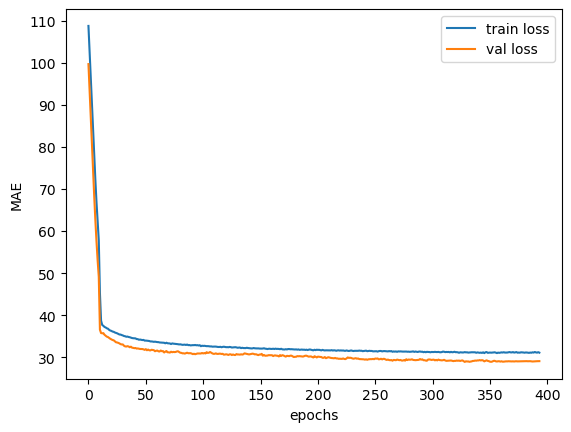

In [178]:
plt.plot(history_1['loss'], label="train loss")
plt.plot(history_1['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

2022-11-06 08:32:21.682153: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step


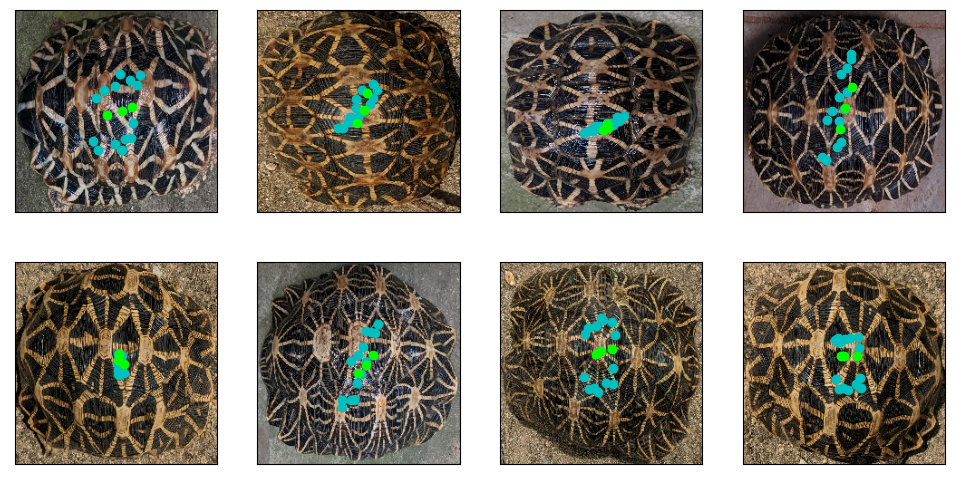

In [179]:
batches = iter(val_dataset)
images = next(batches)[0]

pred = model.predict(images)
plot_images_keypoints(images, pred, 2, 4)

In [228]:
model = keras.models.load_model("model/high_lr_frozen_base")
model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 43,554
Non-trainable params: 5,919,312
_________________________________________________________________


In [229]:
base_model = model.get_layer("efficientnetv2-b0")

print(base_model.get_layer('top_conv').trainable)
base_model.get_layer('top_conv').trainable = True
print(base_model.get_layer('top_conv').trainable)

model.summary()

False
True
Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 289,314
Non-trainable params: 5,673,552
_________________________________________________________________


In [230]:
# Ev2b0, img_size=224 batch=32 dropout 0.1 with new augmentations, unfreeze top conv lr = 0.0001
LEARNING_RATE = 0.0001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps], [LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )
history_high_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "high_lr_unfrozen_top_conv"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/10), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "low_lr_unfrozen_top_conv"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

Epoch 1/1000


2022-11-06 09:02:40.870044: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 31.1667 - mse: 1472.9033

2022-11-06 09:03:18.807660: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 29.09453, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 72s 224ms/step - loss: 31.1667 - mse: 1472.9033 - val_loss: 29.0945 - val_mse: 1336.0966
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 31.1224 - mse: 1469.9833
Epoch 2: val_loss improved from 29.09453 to 29.05365, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 149ms/step - loss: 31.1224 - mse: 1469.9833 - val_loss: 29.0536 - val_mse: 1323.7050
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 30.9543 - mse: 1457.2565
Epoch 3: val_loss improved from 29.05365 to 28.71755, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 46s 152ms/step - loss: 30.9543 - mse: 1457.2565 - val_loss: 28.7175 - val_mse: 1305.3901
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 30.9245 - mse: 1451.9242
Epoch 4: val_loss did not improve from 28.71755
291/291 [==============================] - 29s 96ms/step - loss: 30.9245 - mse: 1451.9242 - val_loss: 29.0139 - val_mse: 1318.1842
Epoch 5/1000
291/291 [==============================] - ETA: 0s - loss: 30.9323 - mse: 1453.4265
Epoch 5: val_loss improved from 28.71755 to 28.71399, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 30.9323 - mse: 1453.4265 - val_loss: 28.7140 - val_mse: 1307.9000
Epoch 6/1000
291/291 [==============================] - ETA: 0s - loss: 30.9359 - mse: 1455.5210
Epoch 6: val_loss improved from 28.71399 to 28.55898, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 61s 205ms/step - loss: 30.9359 - mse: 1455.5210 - val_loss: 28.5590 - val_mse: 1294.3822
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 30.7536 - mse: 1444.0391
Epoch 7: val_loss did not improve from 28.55898
291/291 [==============================] - 29s 96ms/step - loss: 30.7536 - mse: 1444.0391 - val_loss: 28.7024 - val_mse: 1311.9498
Epoch 8/1000
290/291 [============================>.] - ETA: 0s - loss: 30.8082 - mse: 1444.5446
Epoch 8: val_loss improved from 28.55898 to 28.38566, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 30.8078 - mse: 1444.5349 - val_loss: 28.3857 - val_mse: 1289.3698
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 30.7484 - mse: 1443.5575
Epoch 9: val_loss did not improve from 28.38566
291/291 [==============================] - 30s 97ms/step - loss: 30.7484 - mse: 1443.5575 - val_loss: 28.6172 - val_mse: 1305.5973
Epoch 10/1000
291/291 [==============================] - ETA: 0s - loss: 30.5683 - mse: 1430.1615
Epoch 10: val_loss did not improve from 28.38566
291/291 [==============================] - 29s 96ms/step - loss: 30.5683 - mse: 1430.1615 - val_loss: 28.5301 - val_mse: 1301.4871
Epoch 11/1000
291/291 [==============================] - ETA: 0s - loss: 30.5861 - mse: 1431.0844
Epoch 11: val_loss improved from 28.38566 to 28.01388, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 149ms/step - loss: 30.5861 - mse: 1431.0844 - val_loss: 28.0139 - val_mse: 1273.2750
Epoch 12/1000
291/291 [==============================] - ETA: 0s - loss: 30.2860 - mse: 1412.1205
Epoch 12: val_loss improved from 28.01388 to 27.06111, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 149ms/step - loss: 30.2860 - mse: 1412.1205 - val_loss: 27.0611 - val_mse: 1228.0262
Epoch 13/1000
291/291 [==============================] - ETA: 0s - loss: 29.9468 - mse: 1384.6516
Epoch 13: val_loss improved from 27.06111 to 27.03354, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 29.9468 - mse: 1384.6516 - val_loss: 27.0335 - val_mse: 1211.2203
Epoch 14/1000
290/291 [============================>.] - ETA: 0s - loss: 29.6638 - mse: 1362.1324
Epoch 14: val_loss improved from 27.03354 to 26.83570, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 61s 207ms/step - loss: 29.6641 - mse: 1362.2158 - val_loss: 26.8357 - val_mse: 1227.8630
Epoch 15/1000
291/291 [==============================] - ETA: 0s - loss: 29.4477 - mse: 1344.1313
Epoch 15: val_loss improved from 26.83570 to 25.60167, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 29.4477 - mse: 1344.1313 - val_loss: 25.6017 - val_mse: 1120.7451
Epoch 16/1000
291/291 [==============================] - ETA: 0s - loss: 29.1456 - mse: 1326.3848
Epoch 16: val_loss did not improve from 25.60167
291/291 [==============================] - 30s 97ms/step - loss: 29.1456 - mse: 1326.3848 - val_loss: 26.3012 - val_mse: 1150.7246
Epoch 17/1000
291/291 [==============================] - ETA: 0s - loss: 29.0195 - mse: 1315.6418
Epoch 17: val_loss improved from 25.60167 to 24.85619, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 29.0195 - mse: 1315.6418 - val_loss: 24.8562 - val_mse: 1109.6432
Epoch 18/1000
291/291 [==============================] - ETA: 0s - loss: 28.9090 - mse: 1306.0946
Epoch 18: val_loss did not improve from 24.85619
291/291 [==============================] - 29s 95ms/step - loss: 28.9090 - mse: 1306.0946 - val_loss: 25.4215 - val_mse: 1200.6945
Epoch 19/1000
290/291 [============================>.] - ETA: 0s - loss: 28.5911 - mse: 1282.3595
Epoch 19: val_loss did not improve from 24.85619
291/291 [==============================] - 29s 96ms/step - loss: 28.5915 - mse: 1282.3293 - val_loss: 25.2192 - val_mse: 1128.3177
Epoch 20/1000
290/291 [============================>.] - ETA: 0s - loss: 28.5035 - mse: 1278.2905
Epoch 20: val_loss did not improve from 24.85619
291/291 [==============================] - 29s 95ms/step - loss: 28.5045 - mse: 1278.3949 - val_loss: 25.4548 - val_mse: 1117.7898
Epoch 21/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 152ms/step - loss: 27.9125 - mse: 1237.0200 - val_loss: 24.7758 - val_mse: 1102.9159
Epoch 26/1000
291/291 [==============================] - ETA: 0s - loss: 27.7837 - mse: 1228.1147
Epoch 26: val_loss improved from 24.77578 to 24.39082, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 27.7837 - mse: 1228.1147 - val_loss: 24.3908 - val_mse: 1055.5070
Epoch 27/1000
291/291 [==============================] - ETA: 0s - loss: 27.8091 - mse: 1224.5758
Epoch 27: val_loss did not improve from 24.39082
291/291 [==============================] - 29s 96ms/step - loss: 27.8091 - mse: 1224.5758 - val_loss: 25.2179 - val_mse: 1096.2650
Epoch 28/1000
290/291 [============================>.] - ETA: 0s - loss: 27.4850 - mse: 1203.0100
Epoch 28: val_loss improved from 24.39082 to 24.20414, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 63s 215ms/step - loss: 27.4853 - mse: 1203.0107 - val_loss: 24.2041 - val_mse: 1049.7075
Epoch 29/1000
291/291 [==============================] - ETA: 0s - loss: 27.4982 - mse: 1204.5050
Epoch 29: val_loss did not improve from 24.20414
291/291 [==============================] - 29s 96ms/step - loss: 27.4982 - mse: 1204.5050 - val_loss: 24.2633 - val_mse: 1066.2543
Epoch 30/1000
290/291 [============================>.] - ETA: 0s - loss: 27.3265 - mse: 1191.1351
Epoch 30: val_loss improved from 24.20414 to 24.02396, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 27.3232 - mse: 1190.8560 - val_loss: 24.0240 - val_mse: 1116.4849
Epoch 31/1000
290/291 [============================>.] - ETA: 0s - loss: 27.2821 - mse: 1187.3073
Epoch 31: val_loss improved from 24.02396 to 23.88228, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 149ms/step - loss: 27.2824 - mse: 1187.2853 - val_loss: 23.8823 - val_mse: 1099.5884
Epoch 32/1000
291/291 [==============================] - ETA: 0s - loss: 27.2155 - mse: 1182.5911
Epoch 32: val_loss improved from 23.88228 to 23.82145, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 27.2155 - mse: 1182.5911 - val_loss: 23.8214 - val_mse: 1094.1198
Epoch 33/1000
291/291 [==============================] - ETA: 0s - loss: 27.0829 - mse: 1176.1521
Epoch 33: val_loss did not improve from 23.82145
291/291 [==============================] - 29s 96ms/step - loss: 27.0829 - mse: 1176.1521 - val_loss: 23.8678 - val_mse: 1052.1331
Epoch 34/1000
290/291 [============================>.] - ETA: 0s - loss: 27.0877 - mse: 1175.4508
Epoch 34: val_loss improved from 23.82145 to 23.67799, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 27.0890 - mse: 1175.5974 - val_loss: 23.6780 - val_mse: 1075.1467
Epoch 35/1000
291/291 [==============================] - ETA: 0s - loss: 26.8799 - mse: 1160.8440
Epoch 35: val_loss did not improve from 23.67799
291/291 [==============================] - 29s 96ms/step - loss: 26.8799 - mse: 1160.8440 - val_loss: 24.1509 - val_mse: 1083.3921
Epoch 36/1000
290/291 [============================>.] - ETA: 0s - loss: 26.8573 - mse: 1159.7871
Epoch 36: val_loss did not improve from 23.67799
291/291 [==============================] - 29s 95ms/step - loss: 26.8565 - mse: 1159.8428 - val_loss: 24.0292 - val_mse: 1081.0186
Epoch 37/1000
291/291 [==============================] - ETA: 0s - loss: 26.7208 - mse: 1149.7024
Epoch 37: val_loss improved from 23.67799 to 23.61282, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 68s 230ms/step - loss: 26.7208 - mse: 1149.7024 - val_loss: 23.6128 - val_mse: 1070.5391
Epoch 38/1000
291/291 [==============================] - ETA: 0s - loss: 26.6975 - mse: 1149.0182
Epoch 38: val_loss improved from 23.61282 to 23.25501, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 26.6975 - mse: 1149.0182 - val_loss: 23.2550 - val_mse: 1032.3724
Epoch 39/1000
291/291 [==============================] - ETA: 0s - loss: 26.5603 - mse: 1138.7917
Epoch 39: val_loss did not improve from 23.25501
291/291 [==============================] - 29s 95ms/step - loss: 26.5603 - mse: 1138.7917 - val_loss: 23.2603 - val_mse: 1026.9373
Epoch 40/1000
290/291 [============================>.] - ETA: 0s - loss: 26.5643 - mse: 1137.0319
Epoch 40: val_loss improved from 23.25501 to 23.08057, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 148ms/step - loss: 26.5650 - mse: 1137.0800 - val_loss: 23.0806 - val_mse: 1020.0165
Epoch 41/1000
291/291 [==============================] - ETA: 0s - loss: 26.4420 - mse: 1129.2845
Epoch 41: val_loss did not improve from 23.08057
291/291 [==============================] - 29s 95ms/step - loss: 26.4420 - mse: 1129.2845 - val_loss: 23.3409 - val_mse: 1074.3253
Epoch 42/1000
290/291 [============================>.] - ETA: 0s - loss: 26.3667 - mse: 1125.4750
Epoch 42: val_loss did not improve from 23.08057
291/291 [==============================] - 28s 95ms/step - loss: 26.3650 - mse: 1125.3708 - val_loss: 23.7128 - val_mse: 1080.1377
Epoch 43/1000
290/291 [============================>.] - ETA: 0s - loss: 26.3306 - mse: 1125.2804
Epoch 43: val_loss improved from 23.08057 to 22.88330, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 149ms/step - loss: 26.3284 - mse: 1125.0951 - val_loss: 22.8833 - val_mse: 1009.7561
Epoch 44/1000
291/291 [==============================] - ETA: 0s - loss: 26.2419 - mse: 1118.4618
Epoch 44: val_loss did not improve from 22.88330
291/291 [==============================] - 29s 95ms/step - loss: 26.2419 - mse: 1118.4618 - val_loss: 23.2198 - val_mse: 1032.4526
Epoch 45/1000
291/291 [==============================] - ETA: 0s - loss: 26.1809 - mse: 1112.9076
Epoch 45: val_loss did not improve from 22.88330
291/291 [==============================] - 29s 95ms/step - loss: 26.1809 - mse: 1112.9076 - val_loss: 23.3732 - val_mse: 1099.0710
Epoch 46/1000
290/291 [============================>.] - ETA: 0s - loss: 26.1423 - mse: 1113.1282
Epoch 46: val_loss did not improve from 22.88330
291/291 [==============================] - 28s 95ms/step - loss: 26.1392 - mse: 1112.9463 - val_loss: 22.9212 - val_mse: 1036.0938
Epoch 47/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 152ms/step - loss: 25.9956 - mse: 1100.0819 - val_loss: 22.6957 - val_mse: 1047.6475
Epoch 49/1000
291/291 [==============================] - ETA: 0s - loss: 25.9089 - mse: 1091.7074
Epoch 49: val_loss did not improve from 22.69571
291/291 [==============================] - 29s 95ms/step - loss: 25.9089 - mse: 1091.7074 - val_loss: 23.2794 - val_mse: 1060.8657
Epoch 50/1000
290/291 [============================>.] - ETA: 0s - loss: 25.8430 - mse: 1089.4580
Epoch 50: val_loss did not improve from 22.69571
291/291 [==============================] - 29s 95ms/step - loss: 25.8410 - mse: 1089.3081 - val_loss: 23.3524 - val_mse: 1054.4668
Epoch 51/1000
290/291 [============================>.] - ETA: 0s - loss: 25.7540 - mse: 1081.8796
Epoch 51: val_loss did not improve from 22.69571
291/291 [==============================] - 29s 95ms/step - loss: 25.7521 - mse: 1081.7339 - val_loss: 23.1337 - val_mse: 1054.2639
Epoch 52/1000
290/291 [===========

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 25.6037 - mse: 1074.5433 - val_loss: 22.5791 - val_mse: 1046.0120
Epoch 55/1000
291/291 [==============================] - ETA: 0s - loss: 25.6225 - mse: 1077.5699
Epoch 55: val_loss improved from 22.57914 to 22.49313, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 66s 221ms/step - loss: 25.6225 - mse: 1077.5699 - val_loss: 22.4931 - val_mse: 965.9364
Epoch 56/1000
291/291 [==============================] - ETA: 0s - loss: 25.5035 - mse: 1065.3315
Epoch 56: val_loss did not improve from 22.49313
291/291 [==============================] - 29s 96ms/step - loss: 25.5035 - mse: 1065.3315 - val_loss: 22.6071 - val_mse: 1063.2913
Epoch 57/1000
290/291 [============================>.] - ETA: 0s - loss: 25.4027 - mse: 1058.0328
Epoch 57: val_loss improved from 22.49313 to 22.28748, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 150ms/step - loss: 25.4053 - mse: 1058.2877 - val_loss: 22.2875 - val_mse: 982.1137
Epoch 58/1000
291/291 [==============================] - ETA: 0s - loss: 25.4267 - mse: 1065.6993
Epoch 58: val_loss did not improve from 22.28748
291/291 [==============================] - 29s 95ms/step - loss: 25.4267 - mse: 1065.6993 - val_loss: 23.3284 - val_mse: 1055.0070
Epoch 59/1000
290/291 [============================>.] - ETA: 0s - loss: 25.3339 - mse: 1055.7434
Epoch 59: val_loss did not improve from 22.28748
291/291 [==============================] - 28s 95ms/step - loss: 25.3316 - mse: 1055.5892 - val_loss: 23.0858 - val_mse: 1018.0167
Epoch 60/1000
290/291 [============================>.] - ETA: 0s - loss: 25.2792 - mse: 1049.9225
Epoch 60: val_loss did not improve from 22.28748
291/291 [==============================] - 29s 95ms/step - loss: 25.2747 - mse: 1049.6597 - val_loss: 22.5701 - val_mse: 996.2645
Epoch 61/1000
290/291 [=============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 25.1054 - mse: 1041.0193 - val_loss: 21.9693 - val_mse: 1026.2578
Epoch 63/1000
291/291 [==============================] - ETA: 0s - loss: 25.1371 - mse: 1040.9086
Epoch 63: val_loss did not improve from 21.96926
291/291 [==============================] - 29s 95ms/step - loss: 25.1371 - mse: 1040.9086 - val_loss: 22.5206 - val_mse: 986.5000
Epoch 64/1000
290/291 [============================>.] - ETA: 0s - loss: 24.9661 - mse: 1031.0619
Epoch 64: val_loss did not improve from 21.96926
291/291 [==============================] - 28s 94ms/step - loss: 24.9656 - mse: 1031.0620 - val_loss: 22.4722 - val_mse: 981.6555
Epoch 65/1000
290/291 [============================>.] - ETA: 0s - loss: 25.0512 - mse: 1037.0105
Epoch 65: val_loss did not improve from 21.96926
291/291 [==============================] - 28s 94ms/step - loss: 25.0504 - mse: 1037.0443 - val_loss: 22.1926 - val_mse: 982.6622
Epoch 66/1000
291/291 [==============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 153ms/step - loss: 24.8686 - mse: 1022.5393 - val_loss: 21.8785 - val_mse: 986.4562
Epoch 69/1000
291/291 [==============================] - ETA: 0s - loss: 24.7805 - mse: 1018.6140
Epoch 69: val_loss did not improve from 21.87849
291/291 [==============================] - 29s 96ms/step - loss: 24.7805 - mse: 1018.6140 - val_loss: 22.1173 - val_mse: 969.6044
Epoch 70/1000
290/291 [============================>.] - ETA: 0s - loss: 24.7031 - mse: 1011.3929
Epoch 70: val_loss improved from 21.87849 to 21.69546, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 24.7016 - mse: 1011.3472 - val_loss: 21.6955 - val_mse: 963.7598
Epoch 71/1000
291/291 [==============================] - ETA: 0s - loss: 24.5723 - mse: 1006.6795
Epoch 71: val_loss did not improve from 21.69546
291/291 [==============================] - 29s 95ms/step - loss: 24.5723 - mse: 1006.6795 - val_loss: 22.1171 - val_mse: 1051.8993
Epoch 72/1000
290/291 [============================>.] - ETA: 0s - loss: 24.6580 - mse: 1013.7814
Epoch 72: val_loss did not improve from 21.69546
291/291 [==============================] - 29s 95ms/step - loss: 24.6554 - mse: 1013.6370 - val_loss: 22.2078 - val_mse: 987.7385
Epoch 73/1000
290/291 [============================>.] - ETA: 0s - loss: 24.5631 - mse: 1004.9861
Epoch 73: val_loss did not improve from 21.69546
291/291 [==============================] - 29s 95ms/step - loss: 24.5593 - mse: 1004.6951 - val_loss: 21.9839 - val_mse: 985.1583
Epoch 74/1000
290/291 [==============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 66s 223ms/step - loss: 24.3520 - mse: 992.2770 - val_loss: 21.2957 - val_mse: 950.9357
Epoch 78/1000
291/291 [==============================] - ETA: 0s - loss: 24.3105 - mse: 988.3270
Epoch 78: val_loss did not improve from 21.29572
291/291 [==============================] - 29s 95ms/step - loss: 24.3105 - mse: 988.3270 - val_loss: 21.4347 - val_mse: 970.6419
Epoch 79/1000
290/291 [============================>.] - ETA: 0s - loss: 24.2396 - mse: 982.5892
Epoch 79: val_loss did not improve from 21.29572
291/291 [==============================] - 29s 96ms/step - loss: 24.2383 - mse: 982.4073 - val_loss: 21.4030 - val_mse: 924.5444
Epoch 80/1000
290/291 [============================>.] - ETA: 0s - loss: 24.2669 - mse: 986.1913
Epoch 80: val_loss did not improve from 21.29572
291/291 [==============================] - 29s 95ms/step - loss: 24.2655 - mse: 986.1281 - val_loss: 21.7066 - val_mse: 956.3761
Epoch 81/1000
291/291 [======================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 24.2807 - mse: 988.7597 - val_loss: 21.2047 - val_mse: 897.5897
Epoch 82/1000
291/291 [==============================] - ETA: 0s - loss: 24.1327 - mse: 977.9658
Epoch 82: val_loss did not improve from 21.20475
291/291 [==============================] - 29s 96ms/step - loss: 24.1327 - mse: 977.9658 - val_loss: 21.2319 - val_mse: 925.6183
Epoch 83/1000
290/291 [============================>.] - ETA: 0s - loss: 24.0662 - mse: 974.5864
Epoch 83: val_loss improved from 21.20475 to 20.88452, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 24.0643 - mse: 974.3997 - val_loss: 20.8845 - val_mse: 927.4940
Epoch 84/1000
291/291 [==============================] - ETA: 0s - loss: 24.1091 - mse: 974.8024
Epoch 84: val_loss did not improve from 20.88452
291/291 [==============================] - 29s 94ms/step - loss: 24.1091 - mse: 974.8024 - val_loss: 21.1341 - val_mse: 942.1575
Epoch 85/1000
290/291 [============================>.] - ETA: 0s - loss: 24.0119 - mse: 968.8083
Epoch 85: val_loss did not improve from 20.88452
291/291 [==============================] - 28s 94ms/step - loss: 24.0085 - mse: 968.5955 - val_loss: 21.5792 - val_mse: 959.9833
Epoch 86/1000
290/291 [============================>.] - ETA: 0s - loss: 23.9651 - mse: 965.0269
Epoch 86: val_loss did not improve from 20.88452
291/291 [==============================] - 28s 95ms/step - loss: 23.9627 - mse: 964.8765 - val_loss: 21.2108 - val_mse: 920.8795
Epoch 87/1000
290/291 [======================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 23.4998 - mse: 934.3146 - val_loss: 20.8460 - val_mse: 927.0425
Epoch 97/1000
291/291 [==============================] - ETA: 0s - loss: 23.5414 - mse: 944.3056
Epoch 97: val_loss did not improve from 20.84599
291/291 [==============================] - 29s 95ms/step - loss: 23.5414 - mse: 944.3056 - val_loss: 21.4013 - val_mse: 935.9946
Epoch 98/1000
290/291 [============================>.] - ETA: 0s - loss: 23.4818 - mse: 934.6237
Epoch 98: val_loss improved from 20.84599 to 20.61651, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 23.4817 - mse: 934.6807 - val_loss: 20.6165 - val_mse: 881.0361
Epoch 99/1000
291/291 [==============================] - ETA: 0s - loss: 23.5253 - mse: 940.1117
Epoch 99: val_loss did not improve from 20.61651
291/291 [==============================] - 29s 94ms/step - loss: 23.5253 - mse: 940.1117 - val_loss: 21.4462 - val_mse: 921.5753
Epoch 100/1000
291/291 [==============================] - ETA: 0s - loss: 23.4286 - mse: 934.9631
Epoch 100: val_loss did not improve from 20.61651
291/291 [==============================] - 29s 95ms/step - loss: 23.4286 - mse: 934.9631 - val_loss: 21.2569 - val_mse: 931.4720
Epoch 101/1000
290/291 [============================>.] - ETA: 0s - loss: 23.3975 - mse: 931.1250
Epoch 101: val_loss did not improve from 20.61651
291/291 [==============================] - 28s 94ms/step - loss: 23.3938 - mse: 930.8367 - val_loss: 21.4606 - val_mse: 904.4969
Epoch 102/1000
290/291 [=================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 65s 221ms/step - loss: 23.1701 - mse: 916.0099 - val_loss: 20.2928 - val_mse: 887.0292
Epoch 114/1000
291/291 [==============================] - ETA: 0s - loss: 22.9028 - mse: 898.7854
Epoch 114: val_loss did not improve from 20.29284
291/291 [==============================] - 29s 96ms/step - loss: 22.9028 - mse: 898.7854 - val_loss: 20.3551 - val_mse: 877.4357
Epoch 115/1000
290/291 [============================>.] - ETA: 0s - loss: 22.9874 - mse: 906.5643
Epoch 115: val_loss improved from 20.29284 to 20.23559, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 22.9857 - mse: 906.4462 - val_loss: 20.2356 - val_mse: 868.6454
Epoch 116/1000
291/291 [==============================] - ETA: 0s - loss: 22.9236 - mse: 901.8951
Epoch 116: val_loss improved from 20.23559 to 19.95655, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 22.9236 - mse: 901.8951 - val_loss: 19.9566 - val_mse: 876.6071
Epoch 117/1000
291/291 [==============================] - ETA: 0s - loss: 22.8166 - mse: 894.1703
Epoch 117: val_loss did not improve from 19.95655
291/291 [==============================] - 29s 96ms/step - loss: 22.8166 - mse: 894.1703 - val_loss: 20.3139 - val_mse: 857.5701
Epoch 118/1000
291/291 [==============================] - ETA: 0s - loss: 22.9097 - mse: 901.2921
Epoch 118: val_loss did not improve from 19.95655
291/291 [==============================] - 29s 95ms/step - loss: 22.9097 - mse: 901.2921 - val_loss: 20.7510 - val_mse: 860.4012
Epoch 119/1000
290/291 [============================>.] - ETA: 0s - loss: 22.8351 - mse: 897.4083
Epoch 119: val_loss did not improve from 19.95655
291/291 [==============================] - 29s 95ms/step - loss: 22.8342 - mse: 897.3427 - val_loss: 20.4392 - val_mse: 851.2628
Epoch 120/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 22.7826 - mse: 894.4006 - val_loss: 19.9530 - val_mse: 831.5732
Epoch 123/1000
291/291 [==============================] - ETA: 0s - loss: 22.7347 - mse: 889.2955
Epoch 123: val_loss did not improve from 19.95298
291/291 [==============================] - 29s 96ms/step - loss: 22.7347 - mse: 889.2955 - val_loss: 20.5225 - val_mse: 860.6909
Epoch 124/1000
290/291 [============================>.] - ETA: 0s - loss: 22.6842 - mse: 884.7182
Epoch 124: val_loss did not improve from 19.95298
291/291 [==============================] - 29s 95ms/step - loss: 22.6827 - mse: 884.6313 - val_loss: 20.3273 - val_mse: 817.8577
Epoch 125/1000
290/291 [============================>.] - ETA: 0s - loss: 22.5929 - mse: 880.6610
Epoch 125: val_loss did not improve from 19.95298
291/291 [==============================] - 29s 95ms/step - loss: 22.5938 - mse: 880.8229 - val_loss: 19.9925 - val_mse: 815.2059
Epoch 126/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 46s 155ms/step - loss: 22.4708 - mse: 872.1233 - val_loss: 19.5962 - val_mse: 834.2677
Epoch 128/1000
291/291 [==============================] - ETA: 0s - loss: 22.6247 - mse: 882.0643
Epoch 128: val_loss did not improve from 19.59619
291/291 [==============================] - 29s 96ms/step - loss: 22.6247 - mse: 882.0643 - val_loss: 20.1224 - val_mse: 800.7745
Epoch 129/1000
290/291 [============================>.] - ETA: 0s - loss: 22.4661 - mse: 871.8431
Epoch 129: val_loss did not improve from 19.59619
291/291 [==============================] - 29s 95ms/step - loss: 22.4639 - mse: 871.6547 - val_loss: 20.0026 - val_mse: 804.6047
Epoch 130/1000
290/291 [============================>.] - ETA: 0s - loss: 22.4903 - mse: 873.2823
Epoch 130: val_loss did not improve from 19.59619
291/291 [==============================] - 29s 95ms/step - loss: 22.4873 - mse: 873.0935 - val_loss: 20.2564 - val_mse: 832.4031
Epoch 131/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 153ms/step - loss: 22.4130 - mse: 870.4745 - val_loss: 19.5907 - val_mse: 822.9647
Epoch 132/1000
291/291 [==============================] - ETA: 0s - loss: 22.5382 - mse: 878.1202
Epoch 132: val_loss did not improve from 19.59066
291/291 [==============================] - 29s 95ms/step - loss: 22.5382 - mse: 878.1202 - val_loss: 19.8468 - val_mse: 815.4359
Epoch 133/1000
290/291 [============================>.] - ETA: 0s - loss: 22.3263 - mse: 862.8614
Epoch 133: val_loss did not improve from 19.59066
291/291 [==============================] - 29s 95ms/step - loss: 22.3253 - mse: 862.8061 - val_loss: 20.0873 - val_mse: 821.0407
Epoch 134/1000
290/291 [============================>.] - ETA: 0s - loss: 22.4064 - mse: 867.2245
Epoch 134: val_loss did not improve from 19.59066
291/291 [==============================] - 29s 96ms/step - loss: 22.4036 - mse: 867.0663 - val_loss: 19.7678 - val_mse: 798.9314
Epoch 135/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 69s 233ms/step - loss: 22.2250 - mse: 857.1437 - val_loss: 19.4958 - val_mse: 770.6290
Epoch 139/1000
291/291 [==============================] - ETA: 0s - loss: 22.2253 - mse: 857.6295
Epoch 139: val_loss did not improve from 19.49576
291/291 [==============================] - 29s 96ms/step - loss: 22.2253 - mse: 857.6295 - val_loss: 19.7275 - val_mse: 827.7482
Epoch 140/1000
290/291 [============================>.] - ETA: 0s - loss: 22.3837 - mse: 868.1974
Epoch 140: val_loss did not improve from 19.49576
291/291 [==============================] - 29s 95ms/step - loss: 22.3854 - mse: 868.2979 - val_loss: 19.8808 - val_mse: 840.4782
Epoch 141/1000
290/291 [============================>.] - ETA: 0s - loss: 22.2203 - mse: 855.5453
Epoch 141: val_loss did not improve from 19.49576
291/291 [==============================] - 29s 95ms/step - loss: 22.2192 - mse: 855.4894 - val_loss: 19.8330 - val_mse: 797.6891
Epoch 142/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 149ms/step - loss: 21.9541 - mse: 841.5289 - val_loss: 19.2315 - val_mse: 767.0467
Epoch 154/1000
290/291 [============================>.] - ETA: 0s - loss: 21.7802 - mse: 829.8386
Epoch 154: val_loss did not improve from 19.23148
291/291 [==============================] - 29s 94ms/step - loss: 21.7805 - mse: 829.8995 - val_loss: 19.9067 - val_mse: 809.7164
Epoch 155/1000
290/291 [============================>.] - ETA: 0s - loss: 21.8654 - mse: 834.9224
Epoch 155: val_loss did not improve from 19.23148
291/291 [==============================] - 28s 94ms/step - loss: 21.8681 - mse: 835.0357 - val_loss: 19.7174 - val_mse: 758.1895
Epoch 156/1000
290/291 [============================>.] - ETA: 0s - loss: 21.8719 - mse: 836.6634
Epoch 156: val_loss did not improve from 19.23148
291/291 [==============================] - 29s 95ms/step - loss: 21.8688 - mse: 836.4608 - val_loss: 19.3346 - val_mse: 772.0911
Epoch 157/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 44s 150ms/step - loss: 21.7647 - mse: 829.6461 - val_loss: 19.0423 - val_mse: 757.1442
Epoch 162/1000
291/291 [==============================] - ETA: 0s - loss: 21.6726 - mse: 823.5980
Epoch 162: val_loss improved from 19.04234 to 18.99879, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 148ms/step - loss: 21.6726 - mse: 823.5980 - val_loss: 18.9988 - val_mse: 756.7972
Epoch 163/1000
290/291 [============================>.] - ETA: 0s - loss: 21.7667 - mse: 830.8698
Epoch 163: val_loss did not improve from 18.99879
291/291 [==============================] - 29s 94ms/step - loss: 21.7638 - mse: 830.6900 - val_loss: 19.3230 - val_mse: 780.7001
Epoch 164/1000
290/291 [============================>.] - ETA: 0s - loss: 21.6987 - mse: 826.0330
Epoch 164: val_loss did not improve from 18.99879
291/291 [==============================] - 28s 94ms/step - loss: 21.6965 - mse: 825.9439 - val_loss: 19.4410 - val_mse: 777.4182
Epoch 165/1000
291/291 [==============================] - ETA: 0s - loss: 21.6029 - mse: 816.8669
Epoch 165: val_loss did not improve from 18.99879
291/291 [==============================] - 28s 94ms/step - loss: 21.6029 - mse: 816.8669 - val_loss: 19.5472 - val_mse: 788.4799
Epoch 166/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 21.5675 - mse: 817.0108 - val_loss: 18.6176 - val_mse: 756.4215
Epoch 170/1000
291/291 [==============================] - ETA: 0s - loss: 21.5477 - mse: 815.7947
Epoch 170: val_loss did not improve from 18.61756
291/291 [==============================] - 29s 95ms/step - loss: 21.5477 - mse: 815.7947 - val_loss: 18.9444 - val_mse: 764.0204
Epoch 171/1000
290/291 [============================>.] - ETA: 0s - loss: 21.5178 - mse: 815.3022
Epoch 171: val_loss did not improve from 18.61756
291/291 [==============================] - 29s 95ms/step - loss: 21.5164 - mse: 815.2218 - val_loss: 19.5193 - val_mse: 762.2352
Epoch 172/1000
291/291 [==============================] - ETA: 0s - loss: 21.6250 - mse: 820.6317
Epoch 172: val_loss did not improve from 18.61756
291/291 [==============================] - 28s 94ms/step - loss: 21.6250 - mse: 820.6317 - val_loss: 19.7021 - val_mse: 788.9660
Epoch 173/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 153ms/step - loss: 21.3163 - mse: 801.0887 - val_loss: 18.6153 - val_mse: 715.3240
Epoch 186/1000
291/291 [==============================] - ETA: 0s - loss: 21.2408 - mse: 797.7994
Epoch 186: val_loss improved from 18.61527 to 18.55485, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 69s 234ms/step - loss: 21.2408 - mse: 797.7994 - val_loss: 18.5548 - val_mse: 731.8001
Epoch 187/1000
291/291 [==============================] - ETA: 0s - loss: 21.1934 - mse: 795.4722
Epoch 187: val_loss did not improve from 18.55485
291/291 [==============================] - 29s 95ms/step - loss: 21.1934 - mse: 795.4722 - val_loss: 18.8168 - val_mse: 739.4715
Epoch 188/1000
290/291 [============================>.] - ETA: 0s - loss: 21.1937 - mse: 796.5243
Epoch 188: val_loss improved from 18.55485 to 18.33758, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 21.1941 - mse: 796.5291 - val_loss: 18.3376 - val_mse: 705.8894
Epoch 189/1000
291/291 [==============================] - ETA: 0s - loss: 21.1223 - mse: 789.7151
Epoch 189: val_loss did not improve from 18.33758
291/291 [==============================] - 29s 96ms/step - loss: 21.1223 - mse: 789.7151 - val_loss: 19.3101 - val_mse: 759.1033
Epoch 190/1000
290/291 [============================>.] - ETA: 0s - loss: 21.1011 - mse: 786.4530
Epoch 190: val_loss did not improve from 18.33758
291/291 [==============================] - 28s 94ms/step - loss: 21.0974 - mse: 786.2950 - val_loss: 18.3541 - val_mse: 684.6871
Epoch 191/1000
290/291 [============================>.] - ETA: 0s - loss: 21.0951 - mse: 789.9921
Epoch 191: val_loss improved from 18.33758 to 18.08978, saving model to model/high_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 150ms/step - loss: 21.0973 - mse: 790.2000 - val_loss: 18.0898 - val_mse: 683.0776
Epoch 192/1000
291/291 [==============================] - ETA: 0s - loss: 21.0821 - mse: 789.4717
Epoch 192: val_loss did not improve from 18.08978
291/291 [==============================] - 29s 96ms/step - loss: 21.0821 - mse: 789.4717 - val_loss: 18.9991 - val_mse: 712.1922
Epoch 193/1000
290/291 [============================>.] - ETA: 0s - loss: 21.1771 - mse: 794.3799
Epoch 193: val_loss did not improve from 18.08978
291/291 [==============================] - 28s 95ms/step - loss: 21.1735 - mse: 794.1995 - val_loss: 18.5689 - val_mse: 730.8868
Epoch 194/1000
290/291 [============================>.] - ETA: 0s - loss: 21.0486 - mse: 785.9217
Epoch 194: val_loss did not improve from 18.08978
291/291 [==============================] - 28s 95ms/step - loss: 21.0470 - mse: 785.8109 - val_loss: 18.2792 - val_mse: 697.0549
Epoch 195/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 152ms/step - loss: 20.7128 - mse: 765.9835 - val_loss: 18.0356 - val_mse: 702.8916
Epoch 210/1000
291/291 [==============================] - ETA: 0s - loss: 20.6971 - mse: 762.7374
Epoch 210: val_loss did not improve from 18.03556
291/291 [==============================] - 29s 96ms/step - loss: 20.6971 - mse: 762.7374 - val_loss: 18.4921 - val_mse: 672.8159
Epoch 211/1000
290/291 [============================>.] - ETA: 0s - loss: 20.7677 - mse: 768.8581
Epoch 211: val_loss did not improve from 18.03556
291/291 [==============================] - 29s 96ms/step - loss: 20.7687 - mse: 768.9412 - val_loss: 18.6845 - val_mse: 692.2876
Epoch 212/1000
290/291 [============================>.] - ETA: 0s - loss: 20.6329 - mse: 761.1737
Epoch 212: val_loss did not improve from 18.03556
291/291 [==============================] - 29s 95ms/step - loss: 20.6313 - mse: 761.0519 - val_loss: 18.1872 - val_mse: 674.8338
Epoch 213/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 20.7577 - mse: 770.6290 - val_loss: 17.9215 - val_mse: 679.0706
Epoch 214/1000
291/291 [==============================] - ETA: 0s - loss: 20.6529 - mse: 761.0085
Epoch 214: val_loss did not improve from 17.92146
291/291 [==============================] - 29s 95ms/step - loss: 20.6529 - mse: 761.0085 - val_loss: 18.2388 - val_mse: 717.3322
Epoch 215/1000
290/291 [============================>.] - ETA: 0s - loss: 20.6141 - mse: 760.2866
Epoch 215: val_loss did not improve from 17.92146
291/291 [==============================] - 29s 95ms/step - loss: 20.6115 - mse: 760.1324 - val_loss: 18.7552 - val_mse: 726.6486
Epoch 216/1000
290/291 [============================>.] - ETA: 0s - loss: 20.6717 - mse: 764.1409
Epoch 216: val_loss did not improve from 17.92146
291/291 [==============================] - 29s 95ms/step - loss: 20.6688 - mse: 763.9551 - val_loss: 19.0417 - val_mse: 683.3510
Epoch 217/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 46s 154ms/step - loss: 20.6048 - mse: 758.1761 - val_loss: 17.7257 - val_mse: 658.3950
Epoch 221/1000
291/291 [==============================] - ETA: 0s - loss: 20.6063 - mse: 761.7261
Epoch 221: val_loss did not improve from 17.72571
291/291 [==============================] - 29s 96ms/step - loss: 20.6063 - mse: 761.7261 - val_loss: 18.4445 - val_mse: 705.3825
Epoch 222/1000
290/291 [============================>.] - ETA: 0s - loss: 20.6083 - mse: 759.0074
Epoch 222: val_loss did not improve from 17.72571
291/291 [==============================] - 29s 95ms/step - loss: 20.6069 - mse: 758.9510 - val_loss: 17.8872 - val_mse: 657.9334
Epoch 223/1000
290/291 [============================>.] - ETA: 0s - loss: 20.5027 - mse: 751.4774
Epoch 223: val_loss did not improve from 17.72571
291/291 [==============================] - 28s 94ms/step - loss: 20.5020 - mse: 751.4294 - val_loss: 18.3444 - val_mse: 692.6157
Epoch 224/1000
291/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 69s 234ms/step - loss: 20.5260 - mse: 753.7227 - val_loss: 17.5597 - val_mse: 665.6346
Epoch 230/1000
291/291 [==============================] - ETA: 0s - loss: 20.5310 - mse: 755.0997
Epoch 230: val_loss did not improve from 17.55972
291/291 [==============================] - 29s 95ms/step - loss: 20.5310 - mse: 755.0997 - val_loss: 18.1057 - val_mse: 664.4602
Epoch 231/1000
290/291 [============================>.] - ETA: 0s - loss: 20.3202 - mse: 741.2664
Epoch 231: val_loss did not improve from 17.55972
291/291 [==============================] - 29s 96ms/step - loss: 20.3220 - mse: 741.5477 - val_loss: 17.9815 - val_mse: 690.7928
Epoch 232/1000
290/291 [============================>.] - ETA: 0s - loss: 20.3966 - mse: 747.4315
Epoch 232: val_loss did not improve from 17.55972
291/291 [==============================] - 29s 95ms/step - loss: 20.3928 - mse: 747.2185 - val_loss: 17.6033 - val_mse: 659.2457
Epoch 233/1000
290/291 [===============

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 151ms/step - loss: 20.3205 - mse: 742.6257 - val_loss: 17.2600 - val_mse: 637.1644
Epoch 237/1000
291/291 [==============================] - ETA: 0s - loss: 20.3698 - mse: 748.0566
Epoch 237: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 95ms/step - loss: 20.3698 - mse: 748.0566 - val_loss: 17.4661 - val_mse: 648.5534
Epoch 238/1000
290/291 [============================>.] - ETA: 0s - loss: 20.3968 - mse: 748.4114
Epoch 238: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 96ms/step - loss: 20.3964 - mse: 748.5090 - val_loss: 17.3724 - val_mse: 634.1342
Epoch 239/1000
290/291 [============================>.] - ETA: 0s - loss: 20.3310 - mse: 743.2245
Epoch 239: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 96ms/step - loss: 20.3316 - mse: 743.3153 - val_loss: 17.8939 - val_mse: 624.3134
Epoch 240/1000
290/291 [===============

290/291 [============================>.] - ETA: 0s - loss: 19.9619 - mse: 721.8864
Epoch 266: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 95ms/step - loss: 19.9590 - mse: 721.7354 - val_loss: 17.2846 - val_mse: 620.1165
Epoch 267/1000
290/291 [============================>.] - ETA: 0s - loss: 19.9712 - mse: 719.6425
Epoch 267: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 95ms/step - loss: 19.9712 - mse: 719.6058 - val_loss: 17.3137 - val_mse: 624.2936
Epoch 268/1000
290/291 [============================>.] - ETA: 0s - loss: 19.9089 - mse: 721.0032
Epoch 268: val_loss did not improve from 17.26005
291/291 [==============================] - 29s 96ms/step - loss: 19.9077 - mse: 720.9510 - val_loss: 17.4799 - val_mse: 632.2789
Epoch 1/1000


2022-11-06 11:29:40.504095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 20.3098 - mse: 744.4090

2022-11-06 11:30:14.297665: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 17.67604, saving model to model/low_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


291/291 [==============================] - 55s 173ms/step - loss: 20.3098 - mse: 744.4090 - val_loss: 17.6760 - val_mse: 660.6972
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 20.1836 - mse: 734.6232
Epoch 2: val_loss did not improve from 17.67604
291/291 [==============================] - 30s 97ms/step - loss: 20.1836 - mse: 734.6232 - val_loss: 17.7531 - val_mse: 660.7871
Epoch 3/1000
290/291 [============================>.] - ETA: 0s - loss: 20.2343 - mse: 740.2719
Epoch 3: val_loss did not improve from 17.67604
291/291 [==============================] - 29s 96ms/step - loss: 20.2309 - mse: 740.0569 - val_loss: 17.7198 - val_mse: 658.9697
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 20.1983 - mse: 737.9409
Epoch 4: val_loss did not improve from 17.67604
291/291 [==============================] - 29s 97ms/step - loss: 20.1983 - mse: 737.9409 - val_loss: 17.8527 - val_mse: 664.7116
Epoch 5/1000
291/291 [=============================

INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


291/291 [==============================] - 46s 155ms/step - loss: 20.1676 - mse: 736.0933 - val_loss: 17.5854 - val_mse: 654.0706
Epoch 6/1000
291/291 [==============================] - ETA: 0s - loss: 20.2459 - mse: 741.0764
Epoch 6: val_loss did not improve from 17.58542
291/291 [==============================] - 29s 95ms/step - loss: 20.2459 - mse: 741.0764 - val_loss: 17.6418 - val_mse: 659.6864
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 20.0787 - mse: 730.6049
Epoch 7: val_loss did not improve from 17.58542
291/291 [==============================] - 29s 96ms/step - loss: 20.0787 - mse: 730.6049 - val_loss: 17.6837 - val_mse: 661.6039
Epoch 8/1000
290/291 [============================>.] - ETA: 0s - loss: 20.1537 - mse: 733.5296
Epoch 8: val_loss improved from 17.58542 to 17.57858, saving model to model/low_lr_unfrozen_top_conv


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_conv/assets


291/291 [==============================] - 45s 152ms/step - loss: 20.1526 - mse: 733.4324 - val_loss: 17.5786 - val_mse: 658.4503
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 20.1622 - mse: 733.3052
Epoch 9: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 96ms/step - loss: 20.1622 - mse: 733.3052 - val_loss: 17.8011 - val_mse: 653.4329
Epoch 10/1000
290/291 [============================>.] - ETA: 0s - loss: 20.1986 - mse: 735.6338
Epoch 10: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 96ms/step - loss: 20.1993 - mse: 735.7156 - val_loss: 17.6817 - val_mse: 667.7548
Epoch 11/1000
290/291 [============================>.] - ETA: 0s - loss: 20.1207 - mse: 735.0946
Epoch 11: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 97ms/step - loss: 20.1207 - mse: 735.2090 - val_loss: 17.6367 - val_mse: 657.2543
Epoch 12/1000
291/291 [========================

290/291 [============================>.] - ETA: 0s - loss: 20.1123 - mse: 731.6684
Epoch 38: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 95ms/step - loss: 20.1124 - mse: 731.6736 - val_loss: 17.7342 - val_mse: 664.5646
Epoch 39/1000
290/291 [============================>.] - ETA: 0s - loss: 20.0504 - mse: 729.2516
Epoch 39: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 95ms/step - loss: 20.0498 - mse: 729.2750 - val_loss: 17.7655 - val_mse: 661.0756
Epoch 40/1000
290/291 [============================>.] - ETA: 0s - loss: 20.0972 - mse: 732.8278
Epoch 40: val_loss did not improve from 17.57858
291/291 [==============================] - 29s 95ms/step - loss: 20.0944 - mse: 732.6430 - val_loss: 17.6876 - val_mse: 660.8118


In [231]:
history_2 = history_high_lr.history.copy()
history_2["loss"].extend(history_low_lr.history['loss'])
history_2["val_loss"].extend(history_low_lr.history['val_loss'])

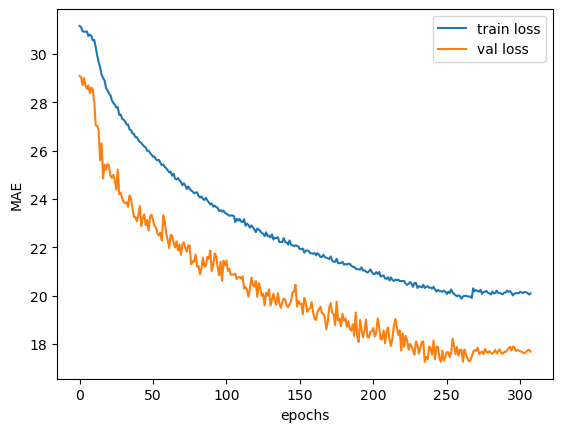

In [232]:
plt.plot(history_2['loss'], label="train loss")
plt.plot(history_2['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

2022-11-06 11:56:35.374826: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 4s 4s/step


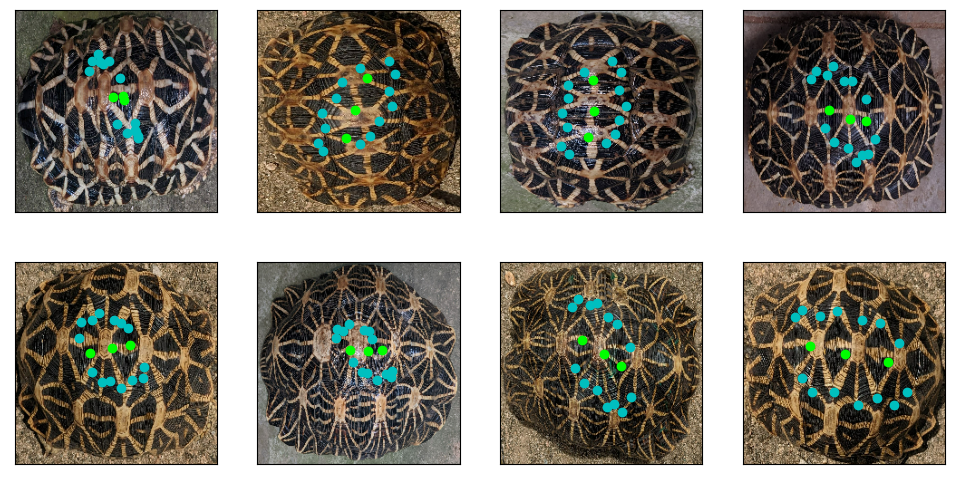

In [233]:
batches = iter(val_dataset)
images = next(batches)[0]

pred = model.predict(images)
plot_images_keypoints(images, pred, 2, 4)

In [235]:
model = keras.models.load_model("model/high_lr_unfrozen_top_conv")
model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 289,314
Non-trainable params: 5,673,552
_________________________________________________________________


In [236]:
base_model = model.get_layer("efficientnetv2-b0")

# Unfreeze top-most block.
for layer in base_model.layers[-122:]:
    if not isinstance(layer, keras.layers.BatchNormalization):
            layer.trainable = True

model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 4,489,678
Non-trainable params: 1,473,188
_________________________________________________________________


In [237]:
# Ev2b0, img_size=224 batch=32 dropout 0.1 with new augmentations, unfreeze top block lr = 0.00001
LEARNING_RATE = 0.00001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps], [LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )
history_high_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "high_lr_unfrozen_top_block"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/10), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "low_lr_unfrozen_top_block"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

Epoch 1/1000


2022-11-06 12:02:10.422556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 19.9325 - mse: 718.1518

2022-11-06 12:02:58.896998: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 16.66212, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 73s 213ms/step - loss: 19.9325 - mse: 718.1518 - val_loss: 16.6621 - val_mse: 606.1895
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 19.4910 - mse: 689.3460
Epoch 2: val_loss improved from 16.66212 to 16.22790, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 169ms/step - loss: 19.4910 - mse: 689.3460 - val_loss: 16.2279 - val_mse: 552.4588
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 19.3604 - mse: 678.9041
Epoch 3: val_loss improved from 16.22790 to 15.69848, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 169ms/step - loss: 19.3604 - mse: 678.9041 - val_loss: 15.6985 - val_mse: 523.4656
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 18.9730 - mse: 656.8868
Epoch 4: val_loss did not improve from 15.69848
291/291 [==============================] - 33s 106ms/step - loss: 18.9730 - mse: 656.8868 - val_loss: 15.6990 - val_mse: 513.7092
Epoch 5/1000
291/291 [==============================] - ETA: 0s - loss: 19.0029 - mse: 657.0054
Epoch 5: val_loss improved from 15.69848 to 15.28113, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 169ms/step - loss: 19.0029 - mse: 657.0054 - val_loss: 15.2811 - val_mse: 498.5258
Epoch 6/1000
291/291 [==============================] - ETA: 0s - loss: 18.8244 - mse: 646.3256
Epoch 6: val_loss improved from 15.28113 to 15.23994, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 168ms/step - loss: 18.8244 - mse: 646.3256 - val_loss: 15.2399 - val_mse: 488.2338
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 18.7235 - mse: 638.9691
Epoch 7: val_loss improved from 15.23994 to 15.10963, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 166ms/step - loss: 18.7235 - mse: 638.9691 - val_loss: 15.1096 - val_mse: 489.7033
Epoch 8/1000
291/291 [==============================] - ETA: 0s - loss: 18.6895 - mse: 632.1741
Epoch 8: val_loss improved from 15.10963 to 14.97917, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 81s 272ms/step - loss: 18.6895 - mse: 632.1741 - val_loss: 14.9792 - val_mse: 474.5754
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 18.5044 - mse: 622.9329
Epoch 9: val_loss improved from 14.97917 to 14.86666, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 18.5044 - mse: 622.9329 - val_loss: 14.8667 - val_mse: 465.5890
Epoch 10/1000
291/291 [==============================] - ETA: 0s - loss: 18.3926 - mse: 614.7216
Epoch 10: val_loss did not improve from 14.86666
291/291 [==============================] - 32s 105ms/step - loss: 18.3926 - mse: 614.7216 - val_loss: 14.9667 - val_mse: 480.0880
Epoch 11/1000
291/291 [==============================] - ETA: 0s - loss: 17.9497 - mse: 588.5274
Epoch 11: val_loss improved from 14.86666 to 14.80174, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 166ms/step - loss: 17.9497 - mse: 588.5274 - val_loss: 14.8017 - val_mse: 465.6313
Epoch 12/1000
291/291 [==============================] - ETA: 0s - loss: 17.4670 - mse: 556.9015
Epoch 12: val_loss improved from 14.80174 to 14.67486, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 165ms/step - loss: 17.4670 - mse: 556.9015 - val_loss: 14.6749 - val_mse: 466.9402
Epoch 13/1000
291/291 [==============================] - ETA: 0s - loss: 16.9289 - mse: 529.4214
Epoch 13: val_loss improved from 14.67486 to 14.60248, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 16.9289 - mse: 529.4214 - val_loss: 14.6025 - val_mse: 477.8192
Epoch 14/1000
291/291 [==============================] - ETA: 0s - loss: 16.5714 - mse: 510.0156
Epoch 14: val_loss did not improve from 14.60248
291/291 [==============================] - 33s 106ms/step - loss: 16.5714 - mse: 510.0156 - val_loss: 14.7661 - val_mse: 448.3890
Epoch 15/1000
291/291 [==============================] - ETA: 0s - loss: 16.2686 - mse: 491.3967
Epoch 15: val_loss improved from 14.60248 to 14.38181, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 167ms/step - loss: 16.2686 - mse: 491.3967 - val_loss: 14.3818 - val_mse: 452.9450
Epoch 16/1000
291/291 [==============================] - ETA: 0s - loss: 15.8435 - mse: 467.7478
Epoch 16: val_loss did not improve from 14.38181
291/291 [==============================] - 32s 106ms/step - loss: 15.8435 - mse: 467.7478 - val_loss: 14.7272 - val_mse: 437.3658
Epoch 17/1000
291/291 [==============================] - ETA: 0s - loss: 15.6090 - mse: 454.0151
Epoch 17: val_loss did not improve from 14.38181
291/291 [==============================] - 32s 105ms/step - loss: 15.6090 - mse: 454.0151 - val_loss: 14.8237 - val_mse: 446.7597
Epoch 18/1000
291/291 [==============================] - ETA: 0s - loss: 15.3912 - mse: 440.9849
Epoch 18: val_loss did not improve from 14.38181
291/291 [==============================] - 31s 105ms/step - loss: 15.3912 - mse: 440.9849 - val_loss: 14.4124 - val_mse: 456.9091
Epoch 19/1000
291/291 [===================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 80s 271ms/step - loss: 15.0353 - mse: 426.2542 - val_loss: 14.2608 - val_mse: 466.6924
Epoch 20/1000
291/291 [==============================] - ETA: 0s - loss: 14.8506 - mse: 414.2340
Epoch 20: val_loss improved from 14.26083 to 14.25811, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 170ms/step - loss: 14.8506 - mse: 414.2340 - val_loss: 14.2581 - val_mse: 433.2261
Epoch 21/1000
291/291 [==============================] - ETA: 0s - loss: 14.5730 - mse: 400.3557
Epoch 21: val_loss did not improve from 14.25811
291/291 [==============================] - 32s 106ms/step - loss: 14.5730 - mse: 400.3557 - val_loss: 14.3523 - val_mse: 452.5787
Epoch 22/1000
291/291 [==============================] - ETA: 0s - loss: 14.2631 - mse: 383.2165
Epoch 22: val_loss did not improve from 14.25811
291/291 [==============================] - 32s 106ms/step - loss: 14.2631 - mse: 383.2165 - val_loss: 14.4281 - val_mse: 444.6972
Epoch 23/1000
291/291 [==============================] - ETA: 0s - loss: 14.0742 - mse: 373.0314
Epoch 23: val_loss did not improve from 14.25811
291/291 [==============================] - 31s 104ms/step - loss: 14.0742 - mse: 373.0314 - val_loss: 14.6137 - val_mse: 454.7835
Epoch 24/1000
291/291 [===================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 165ms/step - loss: 13.8461 - mse: 360.4682 - val_loss: 14.1424 - val_mse: 430.8652
Epoch 25/1000
291/291 [==============================] - ETA: 0s - loss: 13.6290 - mse: 349.7820
Epoch 25: val_loss improved from 14.14238 to 14.05552, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 169ms/step - loss: 13.6290 - mse: 349.7820 - val_loss: 14.0555 - val_mse: 442.1656
Epoch 26/1000
291/291 [==============================] - ETA: 0s - loss: 13.3676 - mse: 338.6452
Epoch 26: val_loss improved from 14.05552 to 13.90398, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 166ms/step - loss: 13.3676 - mse: 338.6452 - val_loss: 13.9040 - val_mse: 439.0127
Epoch 27/1000
291/291 [==============================] - ETA: 0s - loss: 13.1874 - mse: 328.1475
Epoch 27: val_loss did not improve from 13.90398
291/291 [==============================] - 32s 105ms/step - loss: 13.1874 - mse: 328.1475 - val_loss: 14.0447 - val_mse: 415.4194
Epoch 28/1000
291/291 [==============================] - ETA: 0s - loss: 12.9660 - mse: 317.0440
Epoch 28: val_loss did not improve from 13.90398
291/291 [==============================] - 31s 105ms/step - loss: 12.9660 - mse: 317.0440 - val_loss: 13.9449 - val_mse: 415.1910
Epoch 29/1000
291/291 [==============================] - ETA: 0s - loss: 12.7737 - mse: 309.7314
Epoch 29: val_loss improved from 13.90398 to 13.71005, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 165ms/step - loss: 12.7737 - mse: 309.7314 - val_loss: 13.7100 - val_mse: 410.5125
Epoch 30/1000
291/291 [==============================] - ETA: 0s - loss: 12.6354 - mse: 303.9779
Epoch 30: val_loss improved from 13.71005 to 13.62911, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 165ms/step - loss: 12.6354 - mse: 303.9779 - val_loss: 13.6291 - val_mse: 423.8947
Epoch 31/1000
291/291 [==============================] - ETA: 0s - loss: 12.3643 - mse: 289.4858
Epoch 31: val_loss improved from 13.62911 to 13.42624, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 84s 283ms/step - loss: 12.3643 - mse: 289.4858 - val_loss: 13.4262 - val_mse: 402.6188
Epoch 32/1000
291/291 [==============================] - ETA: 0s - loss: 12.2311 - mse: 285.7198
Epoch 32: val_loss improved from 13.42624 to 13.35119, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 59s 197ms/step - loss: 12.2311 - mse: 285.7198 - val_loss: 13.3512 - val_mse: 401.6174
Epoch 33/1000
291/291 [==============================] - ETA: 0s - loss: 12.0033 - mse: 275.2008
Epoch 33: val_loss did not improve from 13.35119
291/291 [==============================] - 32s 105ms/step - loss: 12.0033 - mse: 275.2008 - val_loss: 13.4345 - val_mse: 401.0976
Epoch 34/1000
291/291 [==============================] - ETA: 0s - loss: 11.8726 - mse: 269.0926
Epoch 34: val_loss did not improve from 13.35119
291/291 [==============================] - 31s 104ms/step - loss: 11.8726 - mse: 269.0926 - val_loss: 13.3886 - val_mse: 390.5575
Epoch 35/1000
291/291 [==============================] - ETA: 0s - loss: 11.6831 - mse: 261.4947
Epoch 35: val_loss improved from 13.35119 to 13.32052, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 166ms/step - loss: 11.6831 - mse: 261.4947 - val_loss: 13.3205 - val_mse: 406.4963
Epoch 36/1000
291/291 [==============================] - ETA: 0s - loss: 11.5123 - mse: 254.4294
Epoch 36: val_loss improved from 13.32052 to 13.08006, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 171ms/step - loss: 11.5123 - mse: 254.4294 - val_loss: 13.0801 - val_mse: 373.0866
Epoch 37/1000
291/291 [==============================] - ETA: 0s - loss: 11.4916 - mse: 252.8426
Epoch 37: val_loss did not improve from 13.08006
291/291 [==============================] - 32s 106ms/step - loss: 11.4916 - mse: 252.8426 - val_loss: 13.1844 - val_mse: 391.9495
Epoch 38/1000
291/291 [==============================] - ETA: 0s - loss: 11.3337 - mse: 249.2874
Epoch 38: val_loss improved from 13.08006 to 13.04327, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 172ms/step - loss: 11.3337 - mse: 249.2874 - val_loss: 13.0433 - val_mse: 384.8250
Epoch 39/1000
291/291 [==============================] - ETA: 0s - loss: 11.1545 - mse: 242.0954
Epoch 39: val_loss improved from 13.04327 to 12.84792, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 177ms/step - loss: 11.1545 - mse: 242.0954 - val_loss: 12.8479 - val_mse: 372.7383
Epoch 40/1000
291/291 [==============================] - ETA: 0s - loss: 11.0963 - mse: 238.7924
Epoch 40: val_loss did not improve from 12.84792
291/291 [==============================] - 32s 105ms/step - loss: 11.0963 - mse: 238.7924 - val_loss: 12.9958 - val_mse: 386.0471
Epoch 41/1000
291/291 [==============================] - ETA: 0s - loss: 10.9099 - mse: 230.8083
Epoch 41: val_loss did not improve from 12.84792
291/291 [==============================] - 32s 105ms/step - loss: 10.9099 - mse: 230.8083 - val_loss: 12.8727 - val_mse: 379.4364
Epoch 42/1000
291/291 [==============================] - ETA: 0s - loss: 10.7759 - mse: 225.8504
Epoch 42: val_loss improved from 12.84792 to 12.83943, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 166ms/step - loss: 10.7759 - mse: 225.8504 - val_loss: 12.8394 - val_mse: 398.3325
Epoch 43/1000
291/291 [==============================] - ETA: 0s - loss: 10.6944 - mse: 224.2724
Epoch 43: val_loss improved from 12.83943 to 12.56922, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 91s 307ms/step - loss: 10.6944 - mse: 224.2724 - val_loss: 12.5692 - val_mse: 386.1649
Epoch 44/1000
291/291 [==============================] - ETA: 0s - loss: 10.7189 - mse: 227.4942
Epoch 44: val_loss improved from 12.56922 to 12.43617, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 168ms/step - loss: 10.7189 - mse: 227.4942 - val_loss: 12.4362 - val_mse: 380.5587
Epoch 45/1000
291/291 [==============================] - ETA: 0s - loss: 10.5488 - mse: 218.6519
Epoch 45: val_loss improved from 12.43617 to 12.38982, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 177ms/step - loss: 10.5488 - mse: 218.6519 - val_loss: 12.3898 - val_mse: 384.1826
Epoch 46/1000
291/291 [==============================] - ETA: 0s - loss: 10.4346 - mse: 214.7347
Epoch 46: val_loss improved from 12.38982 to 12.36797, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 10.4346 - mse: 214.7347 - val_loss: 12.3680 - val_mse: 390.4842
Epoch 47/1000
291/291 [==============================] - ETA: 0s - loss: 10.3589 - mse: 213.5795
Epoch 47: val_loss improved from 12.36797 to 11.91606, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 10.3589 - mse: 213.5795 - val_loss: 11.9161 - val_mse: 387.3697
Epoch 48/1000
291/291 [==============================] - ETA: 0s - loss: 10.3012 - mse: 210.5961
Epoch 48: val_loss did not improve from 11.91606
291/291 [==============================] - 32s 105ms/step - loss: 10.3012 - mse: 210.5961 - val_loss: 11.9654 - val_mse: 369.5782
Epoch 49/1000
291/291 [==============================] - ETA: 0s - loss: 10.2029 - mse: 208.1075
Epoch 49: val_loss did not improve from 11.91606
291/291 [==============================] - 32s 106ms/step - loss: 10.2029 - mse: 208.1075 - val_loss: 11.9841 - val_mse: 366.5522
Epoch 50/1000
291/291 [==============================] - ETA: 0s - loss: 10.0530 - mse: 202.4538
Epoch 50: val_loss improved from 11.91606 to 11.88742, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 174ms/step - loss: 10.0530 - mse: 202.4538 - val_loss: 11.8874 - val_mse: 377.9641
Epoch 51/1000
291/291 [==============================] - ETA: 0s - loss: 9.9965 - mse: 200.3766
Epoch 51: val_loss did not improve from 11.88742
291/291 [==============================] - 32s 105ms/step - loss: 9.9965 - mse: 200.3766 - val_loss: 12.0096 - val_mse: 366.8394
Epoch 52/1000
291/291 [==============================] - ETA: 0s - loss: 9.9318 - mse: 199.8554
Epoch 52: val_loss improved from 11.88742 to 11.84433, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 49s 165ms/step - loss: 9.9318 - mse: 199.8554 - val_loss: 11.8443 - val_mse: 372.1465
Epoch 53/1000
291/291 [==============================] - ETA: 0s - loss: 9.7962 - mse: 193.1251
Epoch 53: val_loss improved from 11.84433 to 11.84362, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 84s 284ms/step - loss: 9.7962 - mse: 193.1251 - val_loss: 11.8436 - val_mse: 383.1989
Epoch 54/1000
291/291 [==============================] - ETA: 0s - loss: 9.7557 - mse: 192.4032
Epoch 54: val_loss improved from 11.84362 to 11.70096, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 165ms/step - loss: 9.7557 - mse: 192.4032 - val_loss: 11.7010 - val_mse: 372.5413
Epoch 55/1000
291/291 [==============================] - ETA: 0s - loss: 9.6535 - mse: 189.5298
Epoch 55: val_loss did not improve from 11.70096
291/291 [==============================] - 32s 104ms/step - loss: 9.6535 - mse: 189.5298 - val_loss: 11.7144 - val_mse: 372.5925
Epoch 56/1000
291/291 [==============================] - ETA: 0s - loss: 9.5286 - mse: 184.4838
Epoch 56: val_loss did not improve from 11.70096
291/291 [==============================] - 31s 105ms/step - loss: 9.5286 - mse: 184.4838 - val_loss: 12.0026 - val_mse: 384.6947
Epoch 57/1000
291/291 [==============================] - ETA: 0s - loss: 9.4797 - mse: 182.6183
Epoch 57: val_loss did not improve from 11.70096
291/291 [==============================] - 33s 109ms/step - loss: 9.4797 - mse: 182.6183 - val_loss: 11.7083 - val_mse: 376.1044
Epoch 58/1000
291/291 [==========================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 173ms/step - loss: 9.5001 - mse: 185.1109 - val_loss: 11.6372 - val_mse: 377.4646
Epoch 59/1000
291/291 [==============================] - ETA: 0s - loss: 9.4363 - mse: 183.0027
Epoch 59: val_loss improved from 11.63720 to 11.58674, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 9.4363 - mse: 183.0027 - val_loss: 11.5867 - val_mse: 368.4980
Epoch 60/1000
291/291 [==============================] - ETA: 0s - loss: 9.3417 - mse: 179.5856
Epoch 60: val_loss improved from 11.58674 to 11.54618, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 9.3417 - mse: 179.5856 - val_loss: 11.5462 - val_mse: 374.8092
Epoch 61/1000
291/291 [==============================] - ETA: 0s - loss: 9.2317 - mse: 175.7832
Epoch 61: val_loss did not improve from 11.54618
291/291 [==============================] - 33s 106ms/step - loss: 9.2317 - mse: 175.7832 - val_loss: 11.5522 - val_mse: 383.3547
Epoch 62/1000
291/291 [==============================] - ETA: 0s - loss: 9.1914 - mse: 175.2335
Epoch 62: val_loss did not improve from 11.54618
291/291 [==============================] - 32s 107ms/step - loss: 9.1914 - mse: 175.2335 - val_loss: 11.5491 - val_mse: 371.5645
Epoch 63/1000
291/291 [==============================] - ETA: 0s - loss: 9.0929 - mse: 171.4384
Epoch 63: val_loss improved from 11.54618 to 11.44493, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 173ms/step - loss: 9.0929 - mse: 171.4384 - val_loss: 11.4449 - val_mse: 371.6411
Epoch 64/1000
291/291 [==============================] - ETA: 0s - loss: 9.0587 - mse: 170.6753
Epoch 64: val_loss improved from 11.44493 to 11.42506, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 175ms/step - loss: 9.0587 - mse: 170.6753 - val_loss: 11.4251 - val_mse: 388.8733
Epoch 65/1000
291/291 [==============================] - ETA: 0s - loss: 8.9661 - mse: 168.2552
Epoch 65: val_loss did not improve from 11.42506
291/291 [==============================] - 32s 105ms/step - loss: 8.9661 - mse: 168.2552 - val_loss: 11.5142 - val_mse: 390.0203
Epoch 66/1000
291/291 [==============================] - ETA: 0s - loss: 8.8975 - mse: 165.2349
Epoch 66: val_loss did not improve from 11.42506
291/291 [==============================] - 32s 106ms/step - loss: 8.8975 - mse: 165.2349 - val_loss: 11.5657 - val_mse: 387.5446
Epoch 67/1000
291/291 [==============================] - ETA: 0s - loss: 8.8071 - mse: 162.9694
Epoch 67: val_loss improved from 11.42506 to 11.40051, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 175ms/step - loss: 8.8071 - mse: 162.9694 - val_loss: 11.4005 - val_mse: 383.2372
Epoch 68/1000
291/291 [==============================] - ETA: 0s - loss: 8.7328 - mse: 159.7590
Epoch 68: val_loss improved from 11.40051 to 11.38256, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 103s 348ms/step - loss: 8.7328 - mse: 159.7590 - val_loss: 11.3826 - val_mse: 385.0380
Epoch 69/1000
291/291 [==============================] - ETA: 0s - loss: 8.6824 - mse: 160.1126
Epoch 69: val_loss improved from 11.38256 to 11.29583, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 167ms/step - loss: 8.6824 - mse: 160.1126 - val_loss: 11.2958 - val_mse: 379.2119
Epoch 70/1000
291/291 [==============================] - ETA: 0s - loss: 8.6341 - mse: 159.3911
Epoch 70: val_loss improved from 11.29583 to 11.19588, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 56s 187ms/step - loss: 8.6341 - mse: 159.3911 - val_loss: 11.1959 - val_mse: 364.7564
Epoch 71/1000
291/291 [==============================] - ETA: 0s - loss: 8.5974 - mse: 159.1763
Epoch 71: val_loss did not improve from 11.19588
291/291 [==============================] - 32s 106ms/step - loss: 8.5974 - mse: 159.1763 - val_loss: 11.5012 - val_mse: 374.8117
Epoch 72/1000
291/291 [==============================] - ETA: 0s - loss: 8.5116 - mse: 154.7775
Epoch 72: val_loss improved from 11.19588 to 11.18979, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 168ms/step - loss: 8.5116 - mse: 154.7775 - val_loss: 11.1898 - val_mse: 353.7970
Epoch 73/1000
291/291 [==============================] - ETA: 0s - loss: 8.5186 - mse: 155.9887
Epoch 73: val_loss improved from 11.18979 to 11.04967, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 175ms/step - loss: 8.5186 - mse: 155.9887 - val_loss: 11.0497 - val_mse: 350.1040
Epoch 74/1000
291/291 [==============================] - ETA: 0s - loss: 8.4333 - mse: 151.7866
Epoch 74: val_loss improved from 11.04967 to 10.93294, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 171ms/step - loss: 8.4333 - mse: 151.7866 - val_loss: 10.9329 - val_mse: 354.0795
Epoch 75/1000
291/291 [==============================] - ETA: 0s - loss: 8.3946 - mse: 152.5234
Epoch 75: val_loss did not improve from 10.93294
291/291 [==============================] - 32s 106ms/step - loss: 8.3946 - mse: 152.5234 - val_loss: 10.9991 - val_mse: 365.9091
Epoch 76/1000
291/291 [==============================] - ETA: 0s - loss: 8.3164 - mse: 148.1488
Epoch 76: val_loss improved from 10.93294 to 10.88057, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 8.3164 - mse: 148.1488 - val_loss: 10.8806 - val_mse: 377.9254
Epoch 77/1000
291/291 [==============================] - ETA: 0s - loss: 8.2162 - mse: 147.5199
Epoch 77: val_loss improved from 10.88057 to 10.86792, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 96s 325ms/step - loss: 8.2162 - mse: 147.5199 - val_loss: 10.8679 - val_mse: 377.6777
Epoch 78/1000
291/291 [==============================] - ETA: 0s - loss: 8.2043 - mse: 147.8440
Epoch 78: val_loss improved from 10.86792 to 10.80861, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 171ms/step - loss: 8.2043 - mse: 147.8440 - val_loss: 10.8086 - val_mse: 376.3787
Epoch 79/1000
291/291 [==============================] - ETA: 0s - loss: 8.1359 - mse: 145.8958
Epoch 79: val_loss did not improve from 10.80861
291/291 [==============================] - 32s 105ms/step - loss: 8.1359 - mse: 145.8958 - val_loss: 10.8399 - val_mse: 369.1292
Epoch 80/1000
291/291 [==============================] - ETA: 0s - loss: 8.0840 - mse: 144.3472
Epoch 80: val_loss improved from 10.80861 to 10.79368, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 168ms/step - loss: 8.0840 - mse: 144.3472 - val_loss: 10.7937 - val_mse: 371.3636
Epoch 81/1000
291/291 [==============================] - ETA: 0s - loss: 8.0276 - mse: 141.4268
Epoch 81: val_loss improved from 10.79368 to 10.70964, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 169ms/step - loss: 8.0276 - mse: 141.4268 - val_loss: 10.7096 - val_mse: 362.5425
Epoch 82/1000
291/291 [==============================] - ETA: 0s - loss: 8.0325 - mse: 143.5308
Epoch 82: val_loss improved from 10.70964 to 10.54481, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 169ms/step - loss: 8.0325 - mse: 143.5308 - val_loss: 10.5448 - val_mse: 352.7866
Epoch 83/1000
291/291 [==============================] - ETA: 0s - loss: 7.8761 - mse: 137.2902
Epoch 83: val_loss improved from 10.54481 to 10.43992, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 167ms/step - loss: 7.8761 - mse: 137.2902 - val_loss: 10.4399 - val_mse: 360.0119
Epoch 84/1000
291/291 [==============================] - ETA: 0s - loss: 7.8049 - mse: 135.4692
Epoch 84: val_loss did not improve from 10.43992
291/291 [==============================] - 32s 103ms/step - loss: 7.8049 - mse: 135.4692 - val_loss: 10.5382 - val_mse: 354.6671
Epoch 85/1000
291/291 [==============================] - ETA: 0s - loss: 7.8241 - mse: 137.1963
Epoch 85: val_loss did not improve from 10.43992
291/291 [==============================] - 31s 104ms/step - loss: 7.8241 - mse: 137.1963 - val_loss: 10.4927 - val_mse: 364.8893
Epoch 86/1000
291/291 [==============================] - ETA: 0s - loss: 7.7594 - mse: 134.4085
Epoch 86: val_loss did not improve from 10.43992
291/291 [==============================] - 32s 107ms/step - loss: 7.7594 - mse: 134.4085 - val_loss: 10.5603 - val_mse: 357.3405
Epoch 87/1000
291/291 [==========================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 169ms/step - loss: 7.6230 - mse: 131.4722 - val_loss: 10.4113 - val_mse: 362.4126
Epoch 89/1000
291/291 [==============================] - ETA: 0s - loss: 7.6077 - mse: 133.2861
Epoch 89: val_loss improved from 10.41129 to 10.28660, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 175ms/step - loss: 7.6077 - mse: 133.2861 - val_loss: 10.2866 - val_mse: 371.0841
Epoch 90/1000
291/291 [==============================] - ETA: 0s - loss: 7.5571 - mse: 132.3158
Epoch 90: val_loss did not improve from 10.28660
291/291 [==============================] - 32s 105ms/step - loss: 7.5571 - mse: 132.3158 - val_loss: 10.4610 - val_mse: 372.4635
Epoch 91/1000
291/291 [==============================] - ETA: 0s - loss: 7.4718 - mse: 127.2914
Epoch 91: val_loss did not improve from 10.28660
291/291 [==============================] - 31s 104ms/step - loss: 7.4718 - mse: 127.2914 - val_loss: 10.4970 - val_mse: 376.4526
Epoch 92/1000
291/291 [==============================] - ETA: 0s - loss: 7.4560 - mse: 127.8935
Epoch 92: val_loss did not improve from 10.28660
291/291 [==============================] - 31s 104ms/step - loss: 7.4560 - mse: 127.8935 - val_loss: 10.4778 - val_mse: 370.8834
Epoch 93/1000
291/291 [==========================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 91s 310ms/step - loss: 7.2608 - mse: 123.6468 - val_loss: 10.2331 - val_mse: 355.5331
Epoch 97/1000
291/291 [==============================] - ETA: 0s - loss: 7.1996 - mse: 121.8740
Epoch 97: val_loss did not improve from 10.23309
291/291 [==============================] - 33s 106ms/step - loss: 7.1996 - mse: 121.8740 - val_loss: 10.3215 - val_mse: 375.5000
Epoch 98/1000
291/291 [==============================] - ETA: 0s - loss: 7.1736 - mse: 121.5685
Epoch 98: val_loss improved from 10.23309 to 10.00626, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 168ms/step - loss: 7.1736 - mse: 121.5685 - val_loss: 10.0063 - val_mse: 368.1814
Epoch 99/1000
291/291 [==============================] - ETA: 0s - loss: 7.1288 - mse: 120.4558
Epoch 99: val_loss did not improve from 10.00626
291/291 [==============================] - 32s 105ms/step - loss: 7.1288 - mse: 120.4558 - val_loss: 10.3797 - val_mse: 364.6425
Epoch 100/1000
291/291 [==============================] - ETA: 0s - loss: 7.0555 - mse: 118.8187
Epoch 100: val_loss did not improve from 10.00626
291/291 [==============================] - 32s 105ms/step - loss: 7.0555 - mse: 118.8187 - val_loss: 10.1795 - val_mse: 356.7789
Epoch 101/1000
291/291 [==============================] - ETA: 0s - loss: 6.9934 - mse: 116.6052
Epoch 101: val_loss did not improve from 10.00626
291/291 [==============================] - 32s 105ms/step - loss: 6.9934 - mse: 116.6052 - val_loss: 10.1236 - val_mse: 357.4873
Epoch 102/1000
291/291 [=====================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 171ms/step - loss: 6.4065 - mse: 105.1430 - val_loss: 9.9430 - val_mse: 357.0827
Epoch 116/1000
291/291 [==============================] - ETA: 0s - loss: 6.4372 - mse: 105.7558
Epoch 116: val_loss did not improve from 9.94301
291/291 [==============================] - 33s 106ms/step - loss: 6.4372 - mse: 105.7558 - val_loss: 10.0456 - val_mse: 373.9535
Epoch 117/1000
291/291 [==============================] - ETA: 0s - loss: 6.3931 - mse: 104.5065
Epoch 117: val_loss improved from 9.94301 to 9.87820, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 178ms/step - loss: 6.3931 - mse: 104.5065 - val_loss: 9.8782 - val_mse: 378.0741
Epoch 118/1000
291/291 [==============================] - ETA: 0s - loss: 6.3654 - mse: 103.0240
Epoch 118: val_loss improved from 9.87820 to 9.86899, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 174ms/step - loss: 6.3654 - mse: 103.0240 - val_loss: 9.8690 - val_mse: 377.9727
Epoch 119/1000
291/291 [==============================] - ETA: 0s - loss: 6.2983 - mse: 102.9437
Epoch 119: val_loss did not improve from 9.86899
291/291 [==============================] - 32s 104ms/step - loss: 6.2983 - mse: 102.9437 - val_loss: 9.9156 - val_mse: 383.7507
Epoch 120/1000
291/291 [==============================] - ETA: 0s - loss: 6.2638 - mse: 101.8832
Epoch 120: val_loss did not improve from 9.86899
291/291 [==============================] - 32s 107ms/step - loss: 6.2638 - mse: 101.8832 - val_loss: 9.9929 - val_mse: 367.7964
Epoch 121/1000
291/291 [==============================] - ETA: 0s - loss: 6.2521 - mse: 102.7141
Epoch 121: val_loss did not improve from 9.86899
291/291 [==============================] - 32s 105ms/step - loss: 6.2521 - mse: 102.7141 - val_loss: 9.9091 - val_mse: 384.3000
Epoch 122/1000
291/291 [==========================

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 174ms/step - loss: 6.1361 - mse: 99.1830 - val_loss: 9.5948 - val_mse: 360.2197
Epoch 124/1000
291/291 [==============================] - ETA: 0s - loss: 6.1338 - mse: 98.5360
Epoch 124: val_loss did not improve from 9.59480
291/291 [==============================] - 32s 104ms/step - loss: 6.1338 - mse: 98.5360 - val_loss: 9.7050 - val_mse: 373.5661
Epoch 125/1000
291/291 [==============================] - ETA: 0s - loss: 6.0929 - mse: 99.0684
Epoch 125: val_loss did not improve from 9.59480
291/291 [==============================] - 31s 103ms/step - loss: 6.0929 - mse: 99.0684 - val_loss: 9.7228 - val_mse: 362.6519
Epoch 126/1000
291/291 [==============================] - ETA: 0s - loss: 6.0690 - mse: 98.7897
Epoch 126: val_loss did not improve from 9.59480
291/291 [==============================] - 32s 106ms/step - loss: 6.0690 - mse: 98.7897 - val_loss: 9.6660 - val_mse: 379.5810
Epoch 127/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 178ms/step - loss: 5.9200 - mse: 95.7999 - val_loss: 9.5547 - val_mse: 375.6356
Epoch 132/1000
291/291 [==============================] - ETA: 0s - loss: 5.8708 - mse: 93.8781
Epoch 132: val_loss did not improve from 9.55470
291/291 [==============================] - 33s 108ms/step - loss: 5.8708 - mse: 93.8781 - val_loss: 9.6099 - val_mse: 361.9715
Epoch 133/1000
291/291 [==============================] - ETA: 0s - loss: 5.8911 - mse: 95.9056
Epoch 133: val_loss did not improve from 9.55470
291/291 [==============================] - 32s 106ms/step - loss: 5.8911 - mse: 95.9056 - val_loss: 9.6683 - val_mse: 371.3978
Epoch 134/1000
291/291 [==============================] - ETA: 0s - loss: 5.8106 - mse: 92.9464
Epoch 134: val_loss improved from 9.55470 to 9.40696, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 174ms/step - loss: 5.8106 - mse: 92.9464 - val_loss: 9.4070 - val_mse: 359.2499
Epoch 135/1000
291/291 [==============================] - ETA: 0s - loss: 5.8026 - mse: 93.0266
Epoch 135: val_loss did not improve from 9.40696
291/291 [==============================] - 33s 108ms/step - loss: 5.8026 - mse: 93.0266 - val_loss: 9.4777 - val_mse: 360.0917
Epoch 136/1000
291/291 [==============================] - ETA: 0s - loss: 5.7543 - mse: 92.9907
Epoch 136: val_loss did not improve from 9.40696
291/291 [==============================] - 32s 106ms/step - loss: 5.7543 - mse: 92.9907 - val_loss: 9.5678 - val_mse: 369.6585
Epoch 137/1000
291/291 [==============================] - ETA: 0s - loss: 5.7447 - mse: 92.4761
Epoch 137: val_loss did not improve from 9.40696
291/291 [==============================] - 32s 105ms/step - loss: 5.7447 - mse: 92.4761 - val_loss: 9.6405 - val_mse: 381.5448
Epoch 138/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 114s 388ms/step - loss: 5.5827 - mse: 91.3678 - val_loss: 9.3389 - val_mse: 383.1776
Epoch 146/1000
291/291 [==============================] - ETA: 0s - loss: 5.4805 - mse: 86.9751
Epoch 146: val_loss did not improve from 9.33892
291/291 [==============================] - 34s 108ms/step - loss: 5.4805 - mse: 86.9751 - val_loss: 9.5007 - val_mse: 378.4024
Epoch 147/1000
291/291 [==============================] - ETA: 0s - loss: 5.4772 - mse: 86.7213
Epoch 147: val_loss did not improve from 9.33892
291/291 [==============================] - 32s 107ms/step - loss: 5.4772 - mse: 86.7213 - val_loss: 9.4907 - val_mse: 384.2021
Epoch 148/1000
291/291 [==============================] - ETA: 0s - loss: 5.4931 - mse: 89.0781
Epoch 148: val_loss did not improve from 9.33892
291/291 [==============================] - 32s 107ms/step - loss: 5.4931 - mse: 89.0781 - val_loss: 9.5453 - val_mse: 374.9959
Epoch 149/1000
291/291 [==============================] 

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 171ms/step - loss: 5.4974 - mse: 89.7876 - val_loss: 9.2822 - val_mse: 380.1652
Epoch 150/1000
291/291 [==============================] - ETA: 0s - loss: 5.4796 - mse: 88.8101
Epoch 150: val_loss did not improve from 9.28217
291/291 [==============================] - 33s 108ms/step - loss: 5.4796 - mse: 88.8101 - val_loss: 9.5642 - val_mse: 385.9578
Epoch 151/1000
291/291 [==============================] - ETA: 0s - loss: 5.3947 - mse: 84.4888
Epoch 151: val_loss did not improve from 9.28217
291/291 [==============================] - 32s 107ms/step - loss: 5.3947 - mse: 84.4888 - val_loss: 9.4627 - val_mse: 370.4703
Epoch 152/1000
291/291 [==============================] - ETA: 0s - loss: 5.3891 - mse: 85.7693
Epoch 152: val_loss improved from 9.28217 to 9.05921, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 179ms/step - loss: 5.3891 - mse: 85.7693 - val_loss: 9.0592 - val_mse: 362.4058
Epoch 153/1000
291/291 [==============================] - ETA: 0s - loss: 5.3412 - mse: 83.6639
Epoch 153: val_loss did not improve from 9.05921
291/291 [==============================] - 33s 107ms/step - loss: 5.3412 - mse: 83.6639 - val_loss: 9.4113 - val_mse: 367.0490
Epoch 154/1000
291/291 [==============================] - ETA: 0s - loss: 5.3638 - mse: 86.9453
Epoch 154: val_loss did not improve from 9.05921
291/291 [==============================] - 32s 107ms/step - loss: 5.3638 - mse: 86.9453 - val_loss: 9.2781 - val_mse: 371.1291
Epoch 155/1000
291/291 [==============================] - ETA: 0s - loss: 5.2948 - mse: 82.6126
Epoch 155: val_loss did not improve from 9.05921
291/291 [==============================] - 32s 107ms/step - loss: 5.2948 - mse: 82.6126 - val_loss: 9.3088 - val_mse: 365.0496
Epoch 156/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 56s 190ms/step - loss: 5.0945 - mse: 81.8397 - val_loss: 8.8545 - val_mse: 366.9345
Epoch 169/1000
291/291 [==============================] - ETA: 0s - loss: 5.1292 - mse: 83.6295
Epoch 169: val_loss did not improve from 8.85452
291/291 [==============================] - 33s 107ms/step - loss: 5.1292 - mse: 83.6295 - val_loss: 9.3017 - val_mse: 376.0730
Epoch 170/1000
291/291 [==============================] - ETA: 0s - loss: 5.0277 - mse: 77.6764
Epoch 170: val_loss did not improve from 8.85452
291/291 [==============================] - 33s 110ms/step - loss: 5.0277 - mse: 77.6764 - val_loss: 9.1322 - val_mse: 375.8083
Epoch 171/1000
291/291 [==============================] - ETA: 0s - loss: 5.0453 - mse: 81.0503
Epoch 171: val_loss did not improve from 8.85452
291/291 [==============================] - 32s 107ms/step - loss: 5.0453 - mse: 81.0503 - val_loss: 9.1279 - val_mse: 371.0598
Epoch 172/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 59s 198ms/step - loss: 4.8880 - mse: 76.8232 - val_loss: 8.7500 - val_mse: 356.9695
Epoch 185/1000
291/291 [==============================] - ETA: 0s - loss: 4.8677 - mse: 77.8198
Epoch 185: val_loss did not improve from 8.74997
291/291 [==============================] - 33s 108ms/step - loss: 4.8677 - mse: 77.8198 - val_loss: 9.1886 - val_mse: 365.6761
Epoch 186/1000
291/291 [==============================] - ETA: 0s - loss: 4.8520 - mse: 77.1153
Epoch 186: val_loss did not improve from 8.74997
291/291 [==============================] - 31s 105ms/step - loss: 4.8520 - mse: 77.1153 - val_loss: 9.2383 - val_mse: 376.8248
Epoch 187/1000
291/291 [==============================] - ETA: 0s - loss: 4.8197 - mse: 75.2575
Epoch 187: val_loss did not improve from 8.74997
291/291 [==============================] - 31s 104ms/step - loss: 4.8197 - mse: 75.2575 - val_loss: 9.0754 - val_mse: 366.4757
Epoch 188/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 174ms/step - loss: 4.6579 - mse: 70.5333 - val_loss: 8.6902 - val_mse: 362.7040
Epoch 196/1000
291/291 [==============================] - ETA: 0s - loss: 4.7336 - mse: 74.4100
Epoch 196: val_loss did not improve from 8.69017
291/291 [==============================] - 32s 105ms/step - loss: 4.7336 - mse: 74.4100 - val_loss: 8.8478 - val_mse: 353.9916
Epoch 197/1000
291/291 [==============================] - ETA: 0s - loss: 4.6655 - mse: 71.7383
Epoch 197: val_loss did not improve from 8.69017
291/291 [==============================] - 31s 105ms/step - loss: 4.6655 - mse: 71.7383 - val_loss: 8.8370 - val_mse: 362.1929
Epoch 198/1000
291/291 [==============================] - ETA: 0s - loss: 4.7196 - mse: 75.0155
Epoch 198: val_loss did not improve from 8.69017
291/291 [==============================] - 31s 104ms/step - loss: 4.7196 - mse: 75.0155 - val_loss: 8.9556 - val_mse: 352.5286
Epoch 199/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 179ms/step - loss: 4.6047 - mse: 71.6068 - val_loss: 8.5862 - val_mse: 355.6875
Epoch 206/1000
291/291 [==============================] - ETA: 0s - loss: 4.6204 - mse: 73.0035
Epoch 206: val_loss did not improve from 8.58620
291/291 [==============================] - 33s 109ms/step - loss: 4.6204 - mse: 73.0035 - val_loss: 8.7397 - val_mse: 360.8512
Epoch 207/1000
291/291 [==============================] - ETA: 0s - loss: 4.6005 - mse: 72.1699
Epoch 207: val_loss did not improve from 8.58620
291/291 [==============================] - 33s 110ms/step - loss: 4.6005 - mse: 72.1699 - val_loss: 8.8463 - val_mse: 364.6159
Epoch 208/1000
291/291 [==============================] - ETA: 0s - loss: 4.5815 - mse: 71.0912
Epoch 208: val_loss did not improve from 8.58620
291/291 [==============================] - 32s 107ms/step - loss: 4.5815 - mse: 71.0912 - val_loss: 8.7138 - val_mse: 362.9811
Epoch 209/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 52s 175ms/step - loss: 4.4679 - mse: 69.8720 - val_loss: 8.5208 - val_mse: 346.5496
Epoch 221/1000
291/291 [==============================] - ETA: 0s - loss: 4.4260 - mse: 67.1380
Epoch 221: val_loss did not improve from 8.52081
291/291 [==============================] - 33s 108ms/step - loss: 4.4260 - mse: 67.1380 - val_loss: 8.9455 - val_mse: 353.7810
Epoch 222/1000
291/291 [==============================] - ETA: 0s - loss: 4.4465 - mse: 68.9045
Epoch 222: val_loss did not improve from 8.52081
291/291 [==============================] - 33s 109ms/step - loss: 4.4465 - mse: 68.9045 - val_loss: 8.7473 - val_mse: 352.1285
Epoch 223/1000
291/291 [==============================] - ETA: 0s - loss: 4.4490 - mse: 69.5787
Epoch 223: val_loss did not improve from 8.52081
291/291 [==============================] - 32s 108ms/step - loss: 4.4490 - mse: 69.5787 - val_loss: 8.7357 - val_mse: 355.0417
Epoch 224/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 122s 417ms/step - loss: 4.3909 - mse: 70.0436 - val_loss: 8.4727 - val_mse: 345.1791
Epoch 233/1000
291/291 [==============================] - ETA: 0s - loss: 4.3374 - mse: 65.6796
Epoch 233: val_loss did not improve from 8.47273
291/291 [==============================] - 35s 112ms/step - loss: 4.3374 - mse: 65.6796 - val_loss: 8.6554 - val_mse: 348.9453
Epoch 234/1000
291/291 [==============================] - ETA: 0s - loss: 4.3439 - mse: 65.6738
Epoch 234: val_loss did not improve from 8.47273
291/291 [==============================] - 33s 108ms/step - loss: 4.3439 - mse: 65.6738 - val_loss: 8.5117 - val_mse: 346.5987
Epoch 235/1000
291/291 [==============================] - ETA: 0s - loss: 4.3284 - mse: 66.7183
Epoch 235: val_loss did not improve from 8.47273
291/291 [==============================] - 33s 109ms/step - loss: 4.3284 - mse: 66.7183 - val_loss: 8.8024 - val_mse: 355.3455
Epoch 236/1000
291/291 [==============================] 

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 54s 181ms/step - loss: 4.2832 - mse: 67.0688 - val_loss: 8.4684 - val_mse: 348.0243
Epoch 245/1000
291/291 [==============================] - ETA: 0s - loss: 4.2572 - mse: 67.0006
Epoch 245: val_loss did not improve from 8.46836
291/291 [==============================] - 33s 108ms/step - loss: 4.2572 - mse: 67.0006 - val_loss: 8.7200 - val_mse: 351.8370
Epoch 246/1000
291/291 [==============================] - ETA: 0s - loss: 4.2533 - mse: 66.0334
Epoch 246: val_loss did not improve from 8.46836
291/291 [==============================] - 32s 108ms/step - loss: 4.2533 - mse: 66.0334 - val_loss: 8.5352 - val_mse: 345.2760
Epoch 247/1000
291/291 [==============================] - ETA: 0s - loss: 4.2595 - mse: 66.4354
Epoch 247: val_loss did not improve from 8.46836
291/291 [==============================] - 32s 108ms/step - loss: 4.2595 - mse: 66.4354 - val_loss: 8.8585 - val_mse: 354.3178
Epoch 248/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 54s 184ms/step - loss: 4.1989 - mse: 63.9385 - val_loss: 8.4563 - val_mse: 347.8740
Epoch 252/1000
291/291 [==============================] - ETA: 0s - loss: 4.2225 - mse: 66.4198
Epoch 252: val_loss did not improve from 8.45635
291/291 [==============================] - 33s 106ms/step - loss: 4.2225 - mse: 66.4198 - val_loss: 8.6006 - val_mse: 354.9951
Epoch 253/1000
291/291 [==============================] - ETA: 0s - loss: 4.1772 - mse: 63.6168
Epoch 253: val_loss did not improve from 8.45635
291/291 [==============================] - 32s 107ms/step - loss: 4.1772 - mse: 63.6168 - val_loss: 8.7816 - val_mse: 352.0957
Epoch 254/1000
291/291 [==============================] - ETA: 0s - loss: 4.1585 - mse: 62.6730
Epoch 254: val_loss did not improve from 8.45635
291/291 [==============================] - 32s 108ms/step - loss: 4.1585 - mse: 62.6730 - val_loss: 8.8709 - val_mse: 360.8137
Epoch 255/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 179ms/step - loss: 4.0998 - mse: 62.1721 - val_loss: 8.4213 - val_mse: 349.8285
Epoch 269/1000
291/291 [==============================] - ETA: 0s - loss: 4.0660 - mse: 61.3570
Epoch 269: val_loss improved from 8.42127 to 8.34854, saving model to model/high_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 53s 176ms/step - loss: 4.0660 - mse: 61.3570 - val_loss: 8.3485 - val_mse: 343.5928
Epoch 270/1000
291/291 [==============================] - ETA: 0s - loss: 4.0528 - mse: 60.7261
Epoch 270: val_loss did not improve from 8.34854
291/291 [==============================] - 33s 107ms/step - loss: 4.0528 - mse: 60.7261 - val_loss: 8.4711 - val_mse: 343.8747
Epoch 271/1000
291/291 [==============================] - ETA: 0s - loss: 4.0857 - mse: 62.3759
Epoch 271: val_loss did not improve from 8.34854
291/291 [==============================] - 32s 106ms/step - loss: 4.0857 - mse: 62.3759 - val_loss: 8.3727 - val_mse: 348.2129
Epoch 272/1000
291/291 [==============================] - ETA: 0s - loss: 4.0679 - mse: 62.5423
Epoch 272: val_loss did not improve from 8.34854
291/291 [==============================] - 32s 107ms/step - loss: 4.0679 - mse: 62.5423 - val_loss: 8.5240 - val_mse: 351.0027
Epoch 273/1000
291/291 [==============================] -

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_top_block/assets


291/291 [==============================] - 51s 173ms/step - loss: 3.9802 - mse: 60.5179 - val_loss: 8.2686 - val_mse: 346.1990
Epoch 287/1000
291/291 [==============================] - ETA: 0s - loss: 4.0059 - mse: 61.8041
Epoch 287: val_loss did not improve from 8.26861
291/291 [==============================] - 32s 105ms/step - loss: 4.0059 - mse: 61.8041 - val_loss: 8.4490 - val_mse: 347.9542
Epoch 288/1000
291/291 [==============================] - ETA: 0s - loss: 3.9258 - mse: 57.1929
Epoch 288: val_loss did not improve from 8.26861
291/291 [==============================] - 31s 105ms/step - loss: 3.9258 - mse: 57.1929 - val_loss: 8.3723 - val_mse: 350.0220
Epoch 289/1000
291/291 [==============================] - ETA: 0s - loss: 3.8978 - mse: 56.9678
Epoch 289: val_loss did not improve from 8.26861
291/291 [==============================] - 32s 107ms/step - loss: 3.8978 - mse: 56.9678 - val_loss: 8.7452 - val_mse: 347.0578
Epoch 290/1000
291/291 [==============================] -

Epoch 317/1000
291/291 [==============================] - ETA: 0s - loss: 3.8173 - mse: 57.8667
Epoch 317: val_loss did not improve from 8.26861
291/291 [==============================] - 33s 108ms/step - loss: 3.8173 - mse: 57.8667 - val_loss: 8.4213 - val_mse: 342.8763
Epoch 318/1000
291/291 [==============================] - ETA: 0s - loss: 3.7769 - mse: 55.3146
Epoch 318: val_loss did not improve from 8.26861
291/291 [==============================] - 33s 108ms/step - loss: 3.7769 - mse: 55.3146 - val_loss: 8.8992 - val_mse: 351.4629
Epoch 1/1000


2022-11-06 15:24:42.567683: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 3.9019 - mse: 58.0072

2022-11-06 15:25:31.357999: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 8.47960, saving model to model/low_lr_unfrozen_top_block


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_block/assets


291/291 [==============================] - 72s 220ms/step - loss: 3.9019 - mse: 58.0072 - val_loss: 8.4796 - val_mse: 350.9082
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 3.9587 - mse: 60.4719
Epoch 2: val_loss did not improve from 8.47960
291/291 [==============================] - 33s 109ms/step - loss: 3.9587 - mse: 60.4719 - val_loss: 8.4873 - val_mse: 349.8684
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 3.9064 - mse: 58.8082
Epoch 3: val_loss did not improve from 8.47960
291/291 [==============================] - 33s 110ms/step - loss: 3.9064 - mse: 58.8082 - val_loss: 8.6304 - val_mse: 349.6087
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 3.9194 - mse: 59.8111
Epoch 4: val_loss did not improve from 8.47960
291/291 [==============================] - 33s 109ms/step - loss: 3.9194 - mse: 59.8111 - val_loss: 8.5249 - val_mse: 347.8328
Epoch 5/1000
291/291 [==============================] - ETA: 0s - los

INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_block/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_top_block/assets


291/291 [==============================] - 50s 168ms/step - loss: 3.9057 - mse: 59.8709 - val_loss: 8.4659 - val_mse: 346.3996
Epoch 18/1000
291/291 [==============================] - ETA: 0s - loss: 3.8555 - mse: 57.2353
Epoch 18: val_loss did not improve from 8.46590
291/291 [==============================] - 32s 104ms/step - loss: 3.8555 - mse: 57.2353 - val_loss: 8.5917 - val_mse: 347.5514
Epoch 19/1000
291/291 [==============================] - ETA: 0s - loss: 3.8601 - mse: 56.9688
Epoch 19: val_loss did not improve from 8.46590
291/291 [==============================] - 31s 104ms/step - loss: 3.8601 - mse: 56.9688 - val_loss: 8.5446 - val_mse: 346.9269
Epoch 20/1000
291/291 [==============================] - ETA: 0s - loss: 3.8846 - mse: 58.0963
Epoch 20: val_loss did not improve from 8.46590
291/291 [==============================] - 31s 104ms/step - loss: 3.8846 - mse: 58.0963 - val_loss: 8.5085 - val_mse: 346.2582
Epoch 21/1000
291/291 [==============================] - ETA: 0

Epoch 48/1000
291/291 [==============================] - ETA: 0s - loss: 3.8688 - mse: 58.6723
Epoch 48: val_loss did not improve from 8.46590
291/291 [==============================] - 32s 107ms/step - loss: 3.8688 - mse: 58.6723 - val_loss: 8.5234 - val_mse: 346.4694
Epoch 49/1000
291/291 [==============================] - ETA: 0s - loss: 3.8206 - mse: 55.1241
Epoch 49: val_loss did not improve from 8.46590
291/291 [==============================] - 33s 109ms/step - loss: 3.8206 - mse: 55.1241 - val_loss: 8.5102 - val_mse: 348.3190


In [238]:
history_3 = history_high_lr.history.copy()
history_3["loss"].extend(history_low_lr.history['loss'])
history_3["val_loss"].extend(history_low_lr.history['val_loss'])

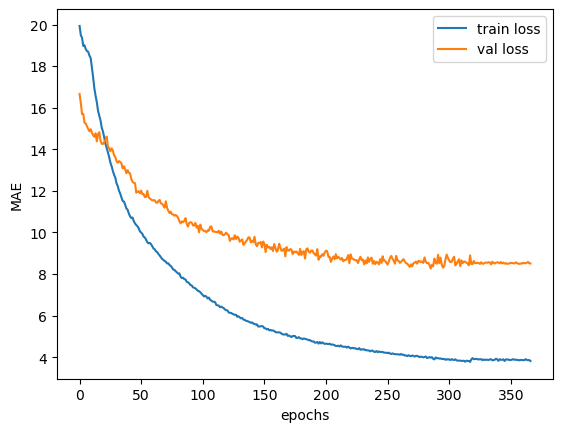

In [239]:
plt.plot(history_3['loss'], label="train loss")
plt.plot(history_3['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

2022-11-06 16:00:15.228002: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 4s 4s/step


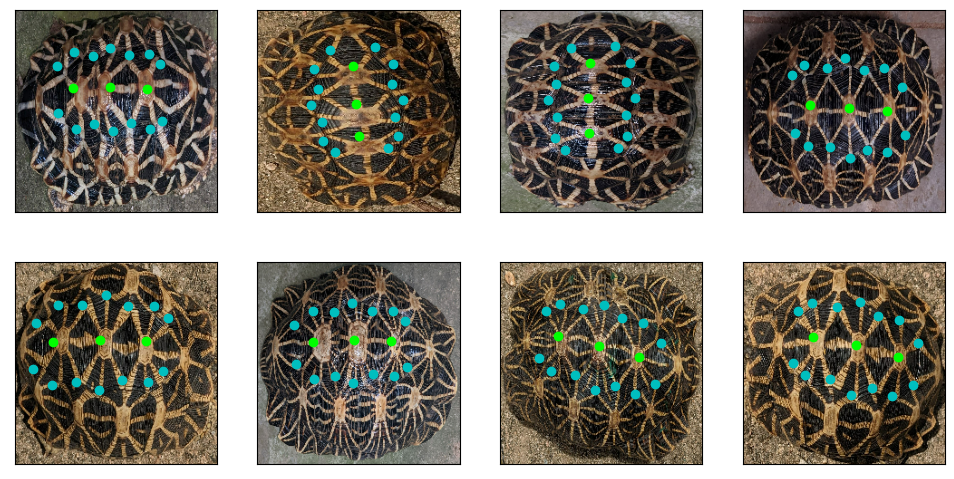

In [240]:
batches = iter(val_dataset)
images = next(batches)[0]

pred = model.predict(images)
plot_images_keypoints(images, pred, 2, 4)

In [242]:
model = keras.models.load_model("model/high_lr_unfrozen_top_block")
model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 4,489,678
Non-trainable params: 1,473,188
_________________________________________________________________


In [243]:
base_model = model.get_layer("efficientnetv2-b0")

for layer in base_model.layers:
    if not isinstance(layer, keras.layers.BatchNormalization):
            layer.trainable = True

model.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1280)              0         
                                                                 
 dense_12 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 5,841,650
Non-trainable params: 121,216
_________________________________________________________________


In [244]:
# Ev2b0, img_size=224 batch=32 dropout 0.1 with new augmentations, unfreeze whole base lr = 0.000001
LEARNING_RATE = 0.000001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps], [LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )
history_high_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "high_lr_unfrozen_whole"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/10), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("model", "low_lr_unfrozen_whole"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=False,
                        verbose=1,
                      )
                  ]
                )

Epoch 1/1000


2022-11-06 16:08:43.474524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 3.9727 - mse: 60.3698

2022-11-06 16:10:48.768522: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 8.57089, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 187s 537ms/step - loss: 3.9727 - mse: 60.3698 - val_loss: 8.5709 - val_mse: 352.0304
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 3.9509 - mse: 60.9605
Epoch 2: val_loss improved from 8.57089 to 8.56701, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 102s 344ms/step - loss: 3.9509 - mse: 60.9605 - val_loss: 8.5670 - val_mse: 351.8657
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 3.9118 - mse: 58.8563
Epoch 3: val_loss did not improve from 8.56701
291/291 [==============================] - 66s 219ms/step - loss: 3.9118 - mse: 58.8563 - val_loss: 8.5849 - val_mse: 352.2726
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 3.9405 - mse: 59.9419
Epoch 4: val_loss improved from 8.56701 to 8.55921, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 96s 326ms/step - loss: 3.9405 - mse: 59.9419 - val_loss: 8.5592 - val_mse: 351.4464
Epoch 5/1000
291/291 [==============================] - ETA: 0s - loss: 3.9398 - mse: 61.0040
Epoch 5: val_loss did not improve from 8.55921
291/291 [==============================] - 68s 224ms/step - loss: 3.9398 - mse: 61.0040 - val_loss: 8.5745 - val_mse: 352.1512
Epoch 6/1000
291/291 [==============================] - ETA: 0s - loss: 3.9202 - mse: 59.8779
Epoch 6: val_loss improved from 8.55921 to 8.55608, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 92s 312ms/step - loss: 3.9202 - mse: 59.8779 - val_loss: 8.5561 - val_mse: 351.5174
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 3.9202 - mse: 59.4017
Epoch 7: val_loss did not improve from 8.55608
291/291 [==============================] - 66s 220ms/step - loss: 3.9202 - mse: 59.4017 - val_loss: 8.5871 - val_mse: 351.5905
Epoch 8/1000
291/291 [==============================] - ETA: 0s - loss: 3.9238 - mse: 60.3760
Epoch 8: val_loss improved from 8.55608 to 8.54970, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 86s 288ms/step - loss: 3.9238 - mse: 60.3760 - val_loss: 8.5497 - val_mse: 350.8211
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 3.9072 - mse: 58.7818
Epoch 9: val_loss did not improve from 8.54970
291/291 [==============================] - 65s 217ms/step - loss: 3.9072 - mse: 58.7818 - val_loss: 8.5573 - val_mse: 350.5600
Epoch 10/1000
291/291 [==============================] - ETA: 0s - loss: 3.8882 - mse: 58.1433
Epoch 10: val_loss did not improve from 8.54970
291/291 [==============================] - 64s 218ms/step - loss: 3.8882 - mse: 58.1433 - val_loss: 8.5685 - val_mse: 350.7877
Epoch 11/1000
291/291 [==============================] - ETA: 0s - loss: 3.9477 - mse: 61.8646
Epoch 11: val_loss did not improve from 8.54970
291/291 [==============================] - 64s 216ms/step - loss: 3.9477 - mse: 61.8646 - val_loss: 8.5596 - val_mse: 349.1618
Epoch 12/1000
291/291 [==============================] - ETA: 0s 

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 84s 284ms/step - loss: 3.8682 - mse: 57.7753 - val_loss: 8.5146 - val_mse: 348.4693
Epoch 13/1000
291/291 [==============================] - ETA: 0s - loss: 3.9069 - mse: 60.8055
Epoch 13: val_loss improved from 8.51456 to 8.50943, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 87s 290ms/step - loss: 3.9069 - mse: 60.8055 - val_loss: 8.5094 - val_mse: 348.5114
Epoch 14/1000
291/291 [==============================] - ETA: 0s - loss: 3.9198 - mse: 60.6102
Epoch 14: val_loss did not improve from 8.50943
291/291 [==============================] - 65s 217ms/step - loss: 3.9198 - mse: 60.6102 - val_loss: 8.5970 - val_mse: 349.1534
Epoch 15/1000
291/291 [==============================] - ETA: 0s - loss: 3.8401 - mse: 56.8627
Epoch 15: val_loss did not improve from 8.50943
291/291 [==============================] - 64s 217ms/step - loss: 3.8401 - mse: 56.8627 - val_loss: 8.5793 - val_mse: 349.5668
Epoch 16/1000
291/291 [==============================] - ETA: 0s - loss: 3.8882 - mse: 60.8940
Epoch 16: val_loss did not improve from 8.50943
291/291 [==============================] - 64s 216ms/step - loss: 3.8882 - mse: 60.8940 - val_loss: 8.5756 - val_mse: 346.6664
Epoch 17/1000
291/291 [==============================] - ETA: 0

INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 164s 562ms/step - loss: 3.8870 - mse: 59.9070 - val_loss: 8.5064 - val_mse: 347.1645
Epoch 18/1000
291/291 [==============================] - ETA: 0s - loss: 3.8539 - mse: 57.9477
Epoch 18: val_loss did not improve from 8.50638
291/291 [==============================] - 69s 219ms/step - loss: 3.8539 - mse: 57.9477 - val_loss: 8.5082 - val_mse: 346.4773
Epoch 19/1000
291/291 [==============================] - ETA: 0s - loss: 3.8580 - mse: 58.7079
Epoch 19: val_loss improved from 8.50638 to 8.49410, saving model to model/high_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/high_lr_unfrozen_whole/assets


291/291 [==============================] - 88s 295ms/step - loss: 3.8580 - mse: 58.7079 - val_loss: 8.4941 - val_mse: 346.5945
Epoch 20/1000
291/291 [==============================] - ETA: 0s - loss: 3.8045 - mse: 55.8367
Epoch 20: val_loss did not improve from 8.49410
291/291 [==============================] - 72s 238ms/step - loss: 3.8045 - mse: 55.8367 - val_loss: 8.5812 - val_mse: 348.5381
Epoch 21/1000
291/291 [==============================] - ETA: 0s - loss: 3.8502 - mse: 59.0473
Epoch 21: val_loss did not improve from 8.49410
291/291 [==============================] - 64s 216ms/step - loss: 3.8502 - mse: 59.0473 - val_loss: 8.6853 - val_mse: 350.6475
Epoch 22/1000
291/291 [==============================] - ETA: 0s - loss: 3.8088 - mse: 56.7388
Epoch 22: val_loss did not improve from 8.49410
291/291 [==============================] - 65s 219ms/step - loss: 3.8088 - mse: 56.7388 - val_loss: 8.5787 - val_mse: 348.2914
Epoch 23/1000
291/291 [==============================] - ETA: 0

Epoch 50/1000
291/291 [==============================] - ETA: 0s - loss: 3.7372 - mse: 56.6167
Epoch 50: val_loss did not improve from 8.49410
291/291 [==============================] - 66s 225ms/step - loss: 3.7372 - mse: 56.6167 - val_loss: 8.5923 - val_mse: 346.3092
Epoch 51/1000
291/291 [==============================] - ETA: 0s - loss: 3.6689 - mse: 53.7933
Epoch 51: val_loss did not improve from 8.49410
291/291 [==============================] - 67s 226ms/step - loss: 3.6689 - mse: 53.7933 - val_loss: 8.6151 - val_mse: 344.6193
Epoch 1/1000


2022-11-06 17:10:39.545708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


291/291 [==============================] - ETA: 0s - loss: 3.8495 - mse: 58.3608

2022-11-06 17:12:36.807892: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 8.54736, saving model to model/low_lr_unfrozen_whole


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_whole/assets


291/291 [==============================] - 161s 451ms/step - loss: 3.8495 - mse: 58.3608 - val_loss: 8.5474 - val_mse: 347.8203
Epoch 2/1000
291/291 [==============================] - ETA: 0s - loss: 3.8223 - mse: 57.5003
Epoch 2: val_loss did not improve from 8.54736
291/291 [==============================] - 69s 229ms/step - loss: 3.8223 - mse: 57.5003 - val_loss: 8.5779 - val_mse: 348.1879
Epoch 3/1000
291/291 [==============================] - ETA: 0s - loss: 3.8488 - mse: 58.3645
Epoch 3: val_loss did not improve from 8.54736
291/291 [==============================] - 66s 225ms/step - loss: 3.8488 - mse: 58.3645 - val_loss: 8.5548 - val_mse: 348.1304
Epoch 4/1000
291/291 [==============================] - ETA: 0s - loss: 3.8203 - mse: 57.2550
Epoch 4: val_loss did not improve from 8.54736
291/291 [==============================] - 67s 227ms/step - loss: 3.8203 - mse: 57.2550 - val_loss: 8.5562 - val_mse: 347.7798
Epoch 5/1000
291/291 [==============================] - ETA: 0s - lo

INFO:tensorflow:Assets written to: model/low_lr_unfrozen_whole/assets


INFO:tensorflow:Assets written to: model/low_lr_unfrozen_whole/assets


291/291 [==============================] - 90s 306ms/step - loss: 3.7910 - mse: 54.6962 - val_loss: 8.5256 - val_mse: 347.5202
Epoch 7/1000
291/291 [==============================] - ETA: 0s - loss: 3.8328 - mse: 57.8768
Epoch 7: val_loss did not improve from 8.52558
291/291 [==============================] - 67s 223ms/step - loss: 3.8328 - mse: 57.8768 - val_loss: 8.5642 - val_mse: 348.2451
Epoch 8/1000
291/291 [==============================] - ETA: 0s - loss: 3.8204 - mse: 57.1426
Epoch 8: val_loss did not improve from 8.52558
291/291 [==============================] - 64s 215ms/step - loss: 3.8204 - mse: 57.1426 - val_loss: 8.5707 - val_mse: 347.8482
Epoch 9/1000
291/291 [==============================] - ETA: 0s - loss: 3.8163 - mse: 56.9029
Epoch 9: val_loss did not improve from 8.52558
291/291 [==============================] - 64s 215ms/step - loss: 3.8163 - mse: 56.9029 - val_loss: 8.5527 - val_mse: 348.1503
Epoch 10/1000
291/291 [==============================] - ETA: 0s - lo

Epoch 37/1000
291/291 [==============================] - ETA: 0s - loss: 3.7807 - mse: 55.9612
Epoch 37: val_loss did not improve from 8.52558
291/291 [==============================] - 66s 223ms/step - loss: 3.7807 - mse: 55.9612 - val_loss: 8.5884 - val_mse: 347.6491
Epoch 38/1000
291/291 [==============================] - ETA: 0s - loss: 3.8051 - mse: 57.9080
Epoch 38: val_loss did not improve from 8.52558
291/291 [==============================] - 66s 223ms/step - loss: 3.8051 - mse: 57.9080 - val_loss: 8.5845 - val_mse: 347.9303


In [245]:
history_4 = history_high_lr.history.copy()
history_4["loss"].extend(history_low_lr.history['loss'])
history_4["val_loss"].extend(history_low_lr.history['val_loss'])

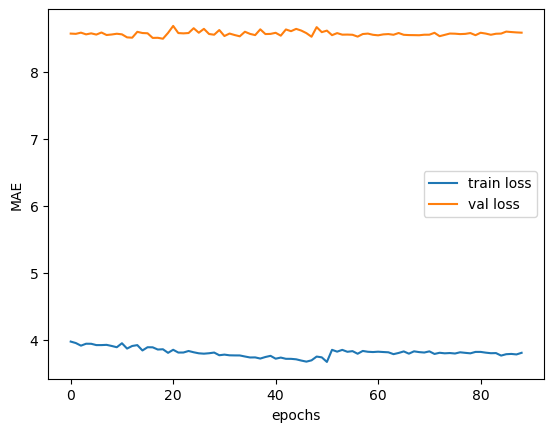

In [246]:
plt.plot(history_4['loss'], label="train loss")
plt.plot(history_4['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

1/1 [==============================] - 0s 244ms/step


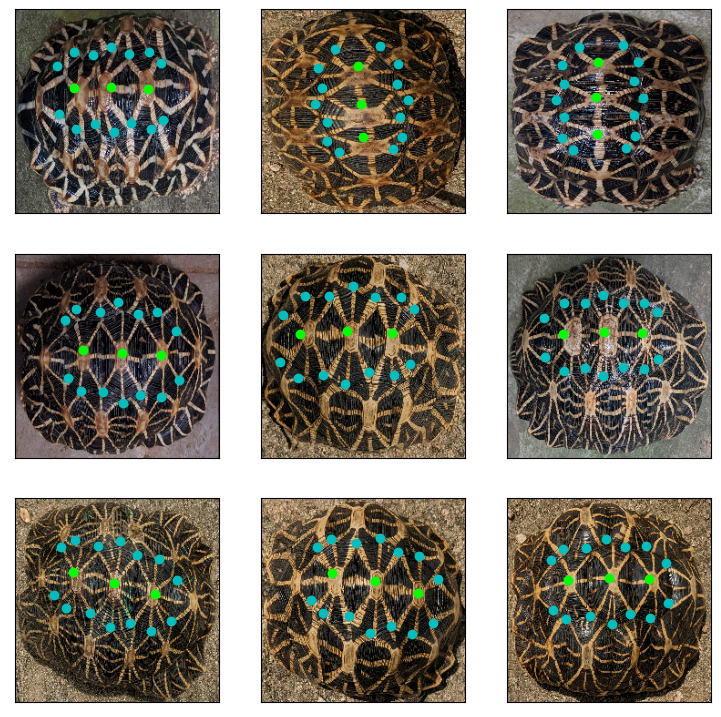

In [259]:
batches = iter(val_dataset)
images = next(batches)[0]

pred = model.predict(images)
plot_images_keypoints(images, pred, 3, 3)

In [417]:
history = history_1.copy()
for h in [history_2, history_3, history_4]:
    history['loss'].extend(h['loss'])
    history['val_loss'].extend(h['val_loss'])

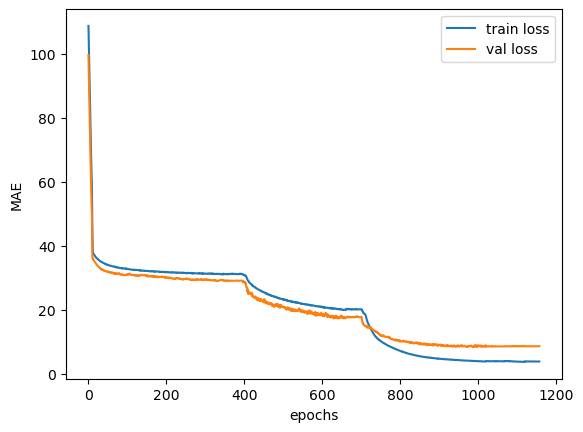

In [418]:
plt.plot(history['loss'], label="train loss")
plt.plot(history['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

3/3 [==============================] - 7s 2s/step


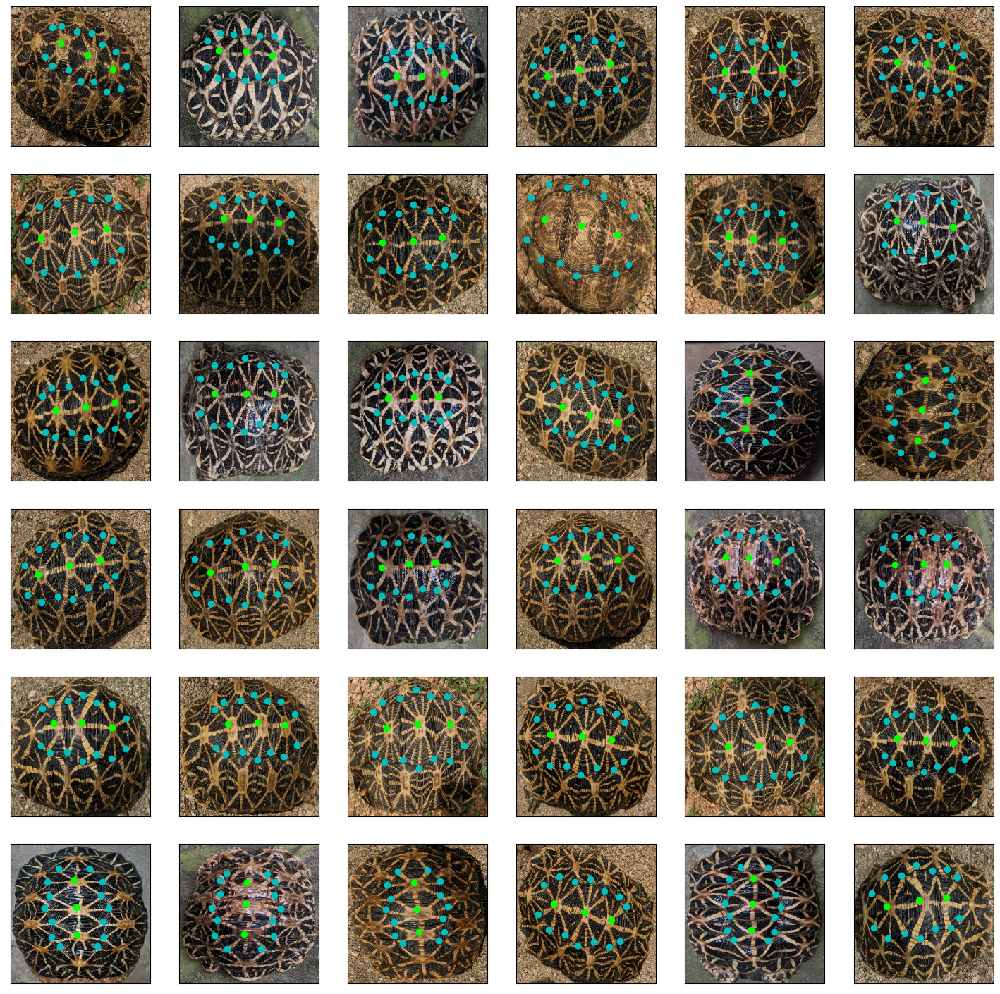

In [249]:
batches = iter(og_train_dataset.batch(36))
batch = next(batches)
images = batch[0]
points = batch[1]

pred = model.predict(images)
plot_images_keypoints(images, pred, 6, 6)

In [257]:
model.evaluate(val_dataset)

1/1 [==============================] - 0s 253ms/step - loss: 8.5256 - mse: 347.5202


[8.525582313537598, 347.5202331542969]

# New images

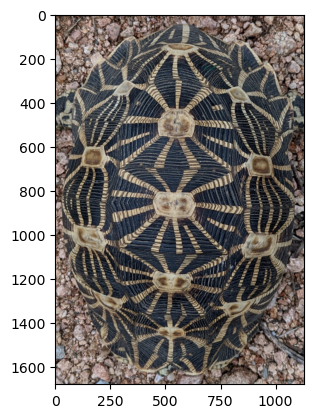

In [408]:
# Use one of the new photos from Oct.
test_img = img.imread("test_image.jpg")
plt.imshow(test_img)
plt.show()

In [409]:
resized_test_img = tf.image.resize(test_img, (IMAGE_SIZE, IMAGE_SIZE), method='nearest')
test_preds = model.predict(np.expand_dims(resized_test_img, axis=0))
test_preds

1/1 [==============================] - 0s 47ms/step


array([[ 75.158714, 164.56795 ,  63.32698 , 150.23515 ,  65.234764,
        125.6991  ,  55.647198,  99.35397 ,  65.61982 ,  80.081955,
         66.33512 ,  53.989254,  87.2388  ,  36.98163 , 133.27379 ,
         44.432213, 150.03499 ,  67.2455  , 146.69287 ,  91.325005,
        157.15407 , 114.92022 , 144.25836 , 136.91162 , 142.00983 ,
        161.15898 , 130.07118 , 172.86081 , 101.32319 , 150.49837 ,
        104.72063 , 108.71489 , 107.61601 ,  61.584713]], dtype=float32)

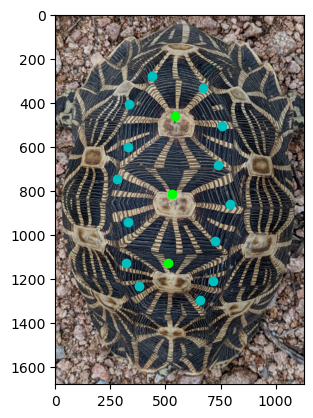

In [410]:
# Read image.
plt.imshow(test_img)

# Plot keypoints.
x = []
y = []
for coord in zip(test_preds[0, ::2], test_preds[0, 1::2]):
    
    x.append(test_img.shape[1] * coord[0] / resized_test_img.shape[1])
    y.append(test_img.shape[0] * coord[1] / resized_test_img.shape[0])

plt.scatter(x[:-3], y[:-3], c='c')
plt.scatter(x[-3:], y[-3:], c='lime')

plt.show()